In [15]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import nrrd
import os
import pandas as pd
import random
import json
import cv2
import math
import pydicom as dicomio
import seaborn as sns
import torch
import torchvision

from matplotlib.gridspec import GridSpec
from pylab import cm
from pydicom import dcmread
from scipy import ndimage
from skimage.util import montage
from skimage.measure import label, regionprops, find_contours
from skimage.morphology import disk, binary_dilation, binary_opening
from matplotlib import patches
from torchvision.utils import make_grid
from torchvision.io import read_image
from pathlib import Path

In [16]:
plt.rcParams['figure.constrained_layout.use'] = True

In [17]:
%run utils.ipynb

In [18]:
MIN_HU_VALUE = -1000
MAX_HU_VALUE = 400
HCRP_EXAMS_DIR = "/Storage/PauloOctavioDir/Exames/"

In [19]:
def normalize(image):
    min_val = MIN_HU_VALUE
    max_val = MAX_HU_VALUE
    image[image < min_val] = min_val
    image[image > max_val] = max_val
    image = (image - min_val) / (max_val - min_val)
    return image


def get_hu_image_windowed(file):
    dicom_data = dcmread(file)
    image = dicom_data.pixel_array
    # Conversio to HU
    intercept = int(dicom_data.RescaleIntercept)
    slope = int(dicom_data.RescaleSlope)
    image = (slope * image) + intercept
    return normalize(image)

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:11: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  # This is added back by InteractiveShellApp.init_path()


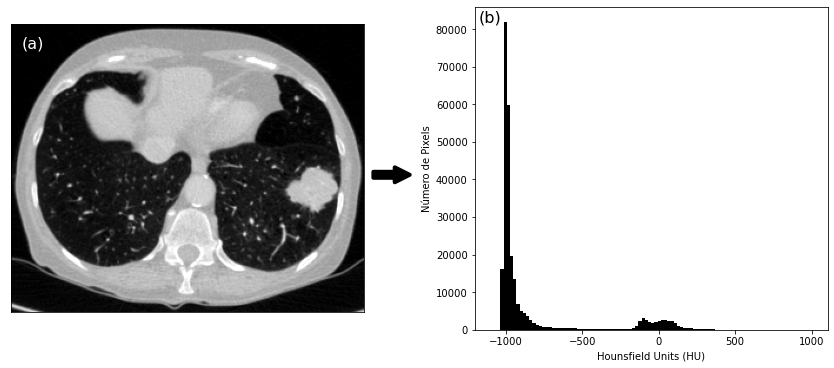

In [19]:
file = "/Storage/PauloOctavioDir/Exames/81/dicomRT/Original-dcm/IMG0137.dcm"
dicom_data = dcmread(file)
image_data = dicom_data.pixel_array
intercept = int(dicom_data.RescaleIntercept)
slope = int(dicom_data.RescaleSlope)
image_data = (slope * image_data) + intercept
image = get_hu_image_windowed(file)

size = 7
fig, axes = plt.subplots(1,2, figsize=(size * 2, size))
fig.tight_layout(pad=8)
plt.arrow(x=50, y=50, dx=20, dy=20, width=10, facecolor='red') 
axes[0].imshow(image[155:400, 100:400], cmap='gray')
axes[0].get_xaxis().set_visible(False)
axes[0].get_yaxis().set_visible(False)
axes[0].text(0.03, 0.96, '(a)', transform=axes[0].transAxes,
      fontsize=16, va='top', color='white')
# axes[0].set_title(f"Imagem de TC")
axes[1].hist(image_data.flatten(), bins=100, color='k', range=(-1100,1000))
axes[1].set_xlabel("Hounsfield Units (HU)")
axes[1].set_ylabel("Número de Pixels")
axes[1].text(0.01, 0.99, '(b)', transform=axes[1].transAxes,
      fontsize=16, va='top', color='black')
# axes[1].set_title(f"Histograma da Imagem de TC")

transFigure = fig.transFigure.inverted()
arrow = patches.FancyArrowPatch(
    [0.46,0.5],  # posA
    [0.5,0.5],  # posB
#     shrinkA=0,  # so tail is exactly on posA (default shrink is 2)
#     shrinkB=0,  # so head is exactly on posB (default shrink is 2)
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=30,  # controls arrow head size
    linewidth=4,
)
fig.patches.append(arrow)
plt.savefig('plots/imagem_de_tc_e_seu_histograma.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:70: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.


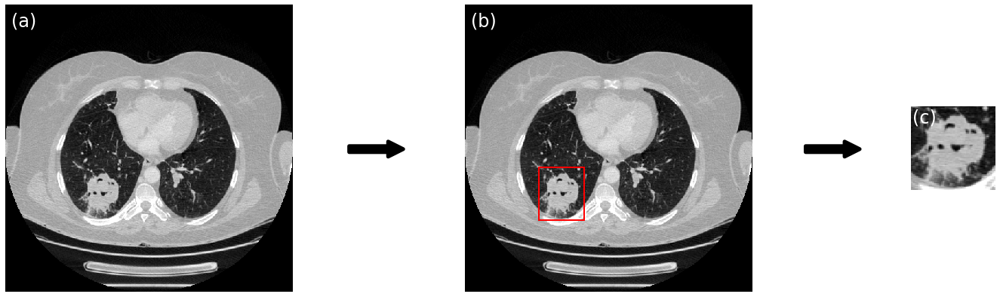

In [172]:
from skimage.morphology import disk, binary_dilation, binary_opening
from skimage.measure import label, regionprops, find_contours 

img_file = "/Storage/PauloOctavioDir/Exames/126/dicomRT/Original-dcm/IMG0136.dcm"   
msk_file = "/Storage/PauloOctavioDir/Exames/126/Segmentado/dcm/IMG0136.dcm" 
mask_data = dcmread(msk_file)
image_data = dcmread(img_file)
mask = mask_data.pixel_array
image = get_hu_image_windowed(img_file)
selem = disk(1)
binary_dilated = binary_dilation(mask, selem)
bboxes = mask_to_bbox(mask)
cropped_image = crop_roi(
    image, 
    bboxes[0] - 10, 
    bboxes[1] - 10, 
    bboxes[2] + 10, 
    bboxes[3] + 10
)
mask_roi = mask_to_roi(binary_dilated, mask, bbox_extension=10)
bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10


fig = plt.figure()
fig.set_figheight(7)
fig.set_figwidth(7*5)
ax1 = plt.subplot2grid(shape=(3, 13), loc=(0, 0), rowspan=3, colspan=3)
ax2 = plt.subplot2grid(shape=(3, 13), loc=(0, 4), rowspan=3, colspan=3)
ax3 = plt.subplot2grid(shape=(3, 13), loc=(1, 8))
ax1.set_axis_off()
ax2.set_axis_off()
ax3.set_axis_off()

ax1.imshow(image, cmap='gray', interpolation='none')
ax2.imshow(image, cmap='gray', interpolation='none')
ax3.imshow(cv2.resize(cropped_image, (64,64)), cmap='gray', interpolation='none')

transFigure = fig.transFigure.inverted()
arrow1 = patches.FancyArrowPatch(
    [0.315,.5],  # posA
    [0.315 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
arrow2 = patches.FancyArrowPatch(
    [0.555,.5],  # posA
    [0.555 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
fig.patches.append(arrow1)
fig.patches.append(arrow2)

rect = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')
ax2.add_patch(rect) 

ax1.text(0.02,0.925,'('+chr(97)+')', transform=ax1.transAxes, color='white', fontsize=24)
ax2.text(0.02,0.925,'('+chr(98)+')', transform=ax2.transAxes, color='white', fontsize=24)
ax3.text(0.02,0.8,'('+chr(99)+')', transform=ax3.transAxes, color='white', fontsize=24)

plt.savefig('plots/exemplo_pre_processamento.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:66: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.
/home/mainlab1/PauloLucas/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.
  fig.canvas.print_figure(bytes_io, **kw)


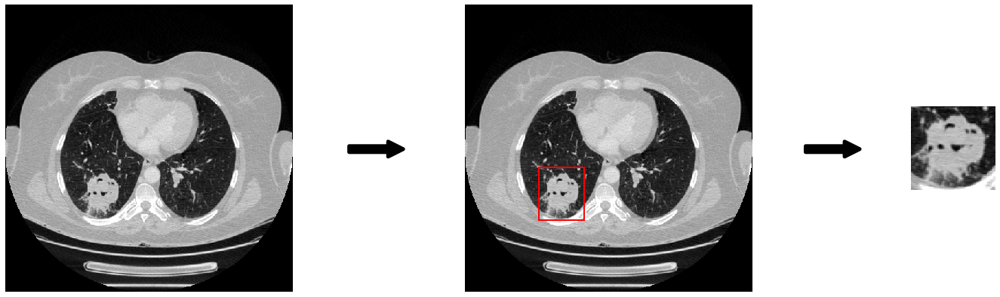

In [22]:
from skimage.morphology import disk, binary_dilation, binary_opening
from skimage.measure import label, regionprops, find_contours 

img_file = "/Storage/PauloOctavioDir/Exames/126/dicomRT/Original-dcm/IMG0136.dcm"   
msk_file = "/Storage/PauloOctavioDir/Exames/126/Segmentado/dcm/IMG0136.dcm" 
mask_data = dcmread(msk_file)
image_data = dcmread(img_file)
mask = mask_data.pixel_array
image = get_hu_image_windowed(img_file)
selem = disk(1)
binary_dilated = binary_dilation(mask, selem)
bboxes = mask_to_bbox(mask)
cropped_image = crop_roi(
    image, 
    bboxes[0] - 10, 
    bboxes[1] - 10, 
    bboxes[2] + 10, 
    bboxes[3] + 10
)
mask_roi = mask_to_roi(binary_dilated, mask, bbox_extension=10)
bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10


fig = plt.figure()
fig.set_figheight(7)
fig.set_figwidth(7*5)
ax1 = plt.subplot2grid(shape=(3, 13), loc=(0, 0), rowspan=3, colspan=3)
ax2 = plt.subplot2grid(shape=(3, 13), loc=(0, 4), rowspan=3, colspan=3)
ax3 = plt.subplot2grid(shape=(3, 13), loc=(1, 8))
ax1.set_axis_off()
ax2.set_axis_off()
ax3.set_axis_off()

ax1.imshow(image, cmap='gray', interpolation='none')
ax2.imshow(image, cmap='gray', interpolation='none')
ax3.imshow(cv2.resize(cropped_image, (64,64)), cmap='gray', interpolation='none')

transFigure = fig.transFigure.inverted()
arrow1 = patches.FancyArrowPatch(
    [0.315,.5],  # posA
    [0.315 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
arrow2 = patches.FancyArrowPatch(
    [0.555,.5],  # posA
    [0.555 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
fig.patches.append(arrow1)
fig.patches.append(arrow2)

rect = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')
ax2.add_patch(rect) 

plt.savefig('plots/exemplo_pre_processamento_ppt_1.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:67: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.


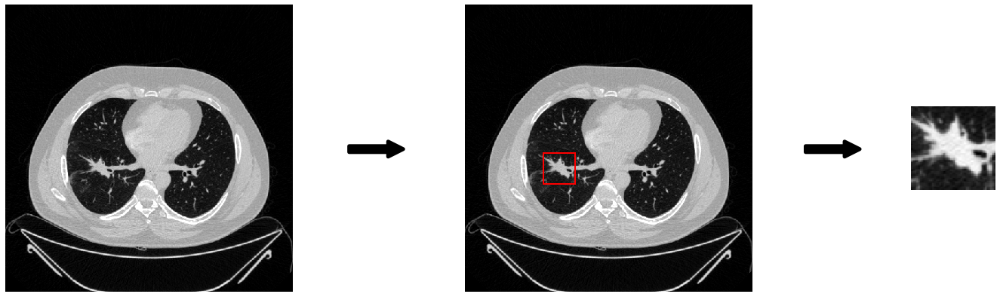

In [23]:
from skimage.morphology import disk, binary_dilation, binary_opening
from skimage.measure import label, regionprops, find_contours 

img_file = "/Storage/PauloOctavioDir/Exames/59/dicomRT/Original-dcm/IMG0160.dcm"   
msk_file = "/Storage/PauloOctavioDir/Exames/59/Segmentado/dcm/IMG0160.dcm" 

mask_data = dcmread(msk_file)
image_data = dcmread(img_file)
mask = mask_data.pixel_array
image = get_hu_image_windowed(img_file)
selem = disk(1)
binary_dilated = binary_dilation(mask, selem)
bboxes = mask_to_bbox(mask)
cropped_image = crop_roi(
    image, 
    bboxes[0] - 10, 
    bboxes[1] - 10, 
    bboxes[2] + 10, 
    bboxes[3] + 10
)
mask_roi = mask_to_roi(binary_dilated, mask, bbox_extension=10)
bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10


fig = plt.figure()
fig.set_figheight(7)
fig.set_figwidth(7*5)
ax1 = plt.subplot2grid(shape=(3, 13), loc=(0, 0), rowspan=3, colspan=3)
ax2 = plt.subplot2grid(shape=(3, 13), loc=(0, 4), rowspan=3, colspan=3)
ax3 = plt.subplot2grid(shape=(3, 13), loc=(1, 8))
ax1.set_axis_off()
ax2.set_axis_off()
ax3.set_axis_off()

ax1.imshow(image, cmap='gray', interpolation='none')
ax2.imshow(image, cmap='gray', interpolation='none')
ax3.imshow(cv2.resize(cropped_image, (64,64)), cmap='gray', interpolation='none')

transFigure = fig.transFigure.inverted()
arrow1 = patches.FancyArrowPatch(
    [0.315,.5],  # posA
    [0.315 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
arrow2 = patches.FancyArrowPatch(
    [0.555,.5],  # posA
    [0.555 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
fig.patches.append(arrow1)
fig.patches.append(arrow2)

rect = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')
ax2.add_patch(rect) 

plt.savefig('plots/exemplo_pre_processamento_ppt_2.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:67: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.


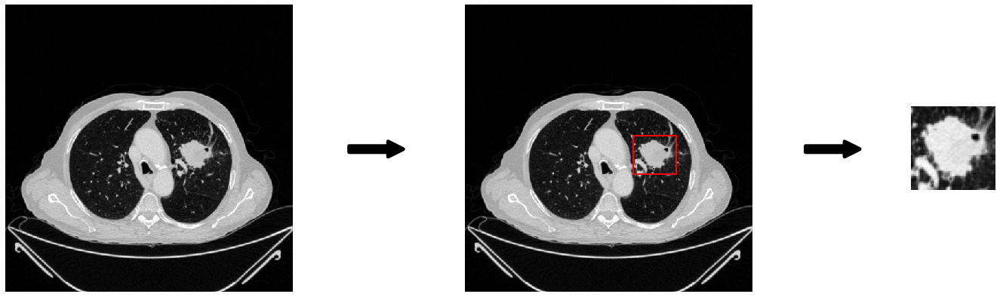

In [24]:
from skimage.morphology import disk, binary_dilation, binary_opening
from skimage.measure import label, regionprops, find_contours 

img_file = "/Storage/PauloOctavioDir/Exames/5/dicomRT/Original-dcm/IMG0206.dcm"   
msk_file = "/Storage/PauloOctavioDir/Exames/5/Segmentado/dcm/IMG0206.dcm"

mask_data = dcmread(msk_file)
image_data = dcmread(img_file)
mask = mask_data.pixel_array
image = get_hu_image_windowed(img_file)
selem = disk(1)
binary_dilated = binary_dilation(mask, selem)
bboxes = mask_to_bbox(mask)
cropped_image = crop_roi(
    image, 
    bboxes[0] - 10, 
    bboxes[1] - 10, 
    bboxes[2] + 10, 
    bboxes[3] + 10
)
mask_roi = mask_to_roi(binary_dilated, mask, bbox_extension=10)
bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10


fig = plt.figure()
fig.set_figheight(7)
fig.set_figwidth(7*5)
ax1 = plt.subplot2grid(shape=(3, 13), loc=(0, 0), rowspan=3, colspan=3)
ax2 = plt.subplot2grid(shape=(3, 13), loc=(0, 4), rowspan=3, colspan=3)
ax3 = plt.subplot2grid(shape=(3, 13), loc=(1, 8))
ax1.set_axis_off()
ax2.set_axis_off()
ax3.set_axis_off()

ax1.imshow(image, cmap='gray', interpolation='none')
ax2.imshow(image, cmap='gray', interpolation='none')
ax3.imshow(cv2.resize(cropped_image, (64,64)), cmap='gray', interpolation='none')

transFigure = fig.transFigure.inverted()
arrow1 = patches.FancyArrowPatch(
    [0.315,.5],  # posA
    [0.315 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
arrow2 = patches.FancyArrowPatch(
    [0.555,.5],  # posA
    [0.555 + .03,.5],  # posB
    transform=fig.transFigure,
    color="black",
    arrowstyle="simple",  # "normal" arrow
    mutation_scale=40,  # controls arrow head size
    linewidth=5,
)
fig.patches.append(arrow1)
fig.patches.append(arrow2)

rect = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')
ax2.add_patch(rect) 

plt.savefig('plots/exemplo_pre_processamento_ppt_3.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

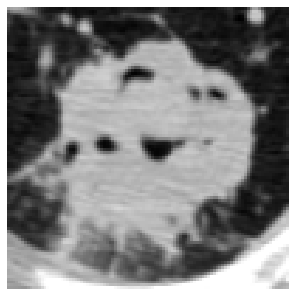

In [176]:
plt.imshow(cv2.resize(cropped_image, (100,100)), cmap='gray', interpolation='none')
plt.axis('off')
plt.savefig('plots/exemplo_nodulo_sozinho.png', dpi=300, transparent=False, bbox_inches='tight')

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:30: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


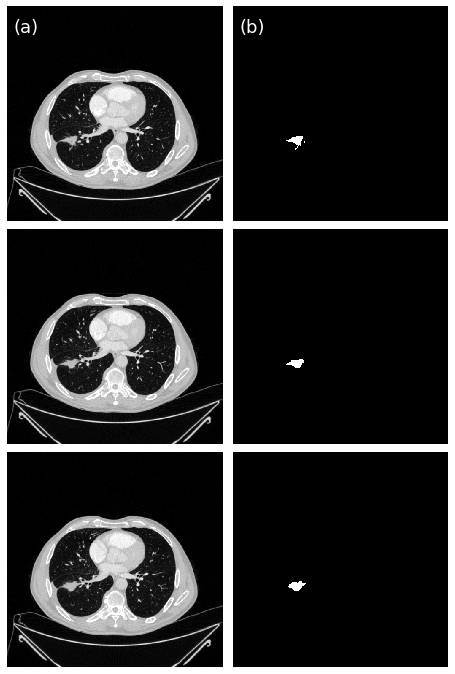

In [14]:
from skimage.morphology import disk, binary_dilation, binary_opening
from skimage.measure import label, regionprops, find_contours 


img_file1 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0172.dcm"   
msk_file1 = "/Storage/PauloOctavioDir/Exames/33/Segmentado/dcm/IMG0173.dcm" 
mask_data1 = dcmread(msk_file1)
image_data1 = dcmread(img_file1)
mask1 = mask_data1.pixel_array
image1 = get_hu_image_windowed(img_file1)

img_file2 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0173.dcm"   
msk_file2 = "/Storage/PauloOctavioDir/Exames/33/Segmentado/dcm/IMG0174.dcm"  
mask_data2 = dcmread(msk_file2)
image_data2 = dcmread(img_file2)
mask2 = mask_data2.pixel_array
image2 = get_hu_image_windowed(img_file2)

img_file3 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0174.dcm"  
msk_file3 = "/Storage/PauloOctavioDir/Exames/33/Segmentado/dcm/IMG0175.dcm"  
mask_data3 = dcmread(msk_file3)
image_data3 = dcmread(img_file3)
mask3 = mask_data3.pixel_array
image3 = get_hu_image_windowed(img_file3)

images = [image1, mask1, image2, mask2, image3, mask3]

size = 3
fig, axes = plt.subplots(3,2, figsize=(size * 2, size * 3))
fig.tight_layout(pad=-2)

list_axes = list(axes.flat)

for i, ax in enumerate(list_axes):
    ax.imshow(images[i], cmap='gray', interpolation='none')
    ax.set_axis_off()

list_axes[0].text(0.03,0.88,'('+chr(97)+')', transform=list_axes[0].transAxes, color='white', fontsize=18)
list_axes[1].text(0.03,0.88,'('+chr(98)+')', transform=list_axes[1].transAxes, color='white', fontsize=18)

plt.savefig('plots/exemplo_segmentacao_HCRP.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

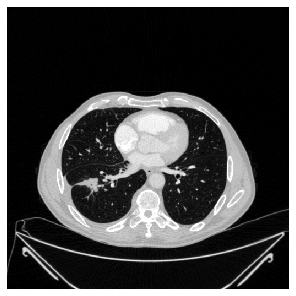

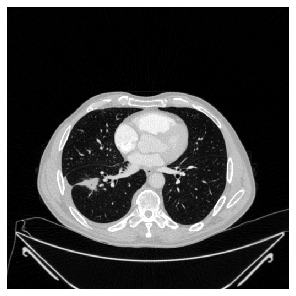

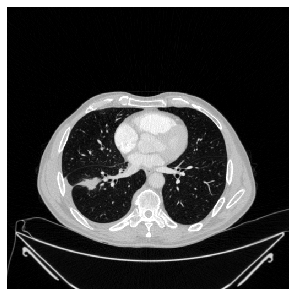

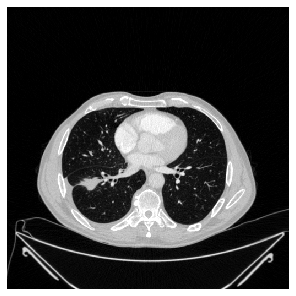

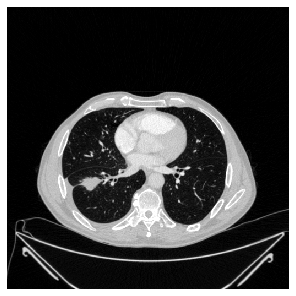

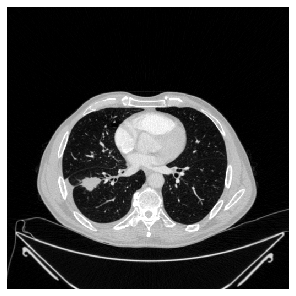

In [27]:
from skimage.morphology import disk, binary_dilation, binary_opening
from skimage.measure import label, regionprops, find_contours 


img_file0 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0171.dcm"   
image_data0 = dcmread(img_file0)
image0 = get_hu_image_windowed(img_file0)

img_file1 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0172.dcm"   
image_data1 = dcmread(img_file1)
image1 = get_hu_image_windowed(img_file1)

img_file2 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0173.dcm"   
image_data2 = dcmread(img_file2)
image2 = get_hu_image_windowed(img_file2)

img_file3 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0174.dcm"  
image_data3 = dcmread(img_file3)
image3 = get_hu_image_windowed(img_file3)

img_file4 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0175.dcm"  
image_data4 = dcmread(img_file4)
image4 = get_hu_image_windowed(img_file4)

img_file5 = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/IMG0176.dcm"  
image_data5 = dcmread(img_file5)
image5 = get_hu_image_windowed(img_file5)

images = [image0, image1, image2, image3, image4, image5]

size = 5

for i, img in enumerate(images):
    plt.imshow(img, cmap='gray', interpolation='none')
    plt.axis('off')
    plt.savefig(f'plots/exemeplos_tc{i}.png', dpi=300, transparent=True, bbox_inches='tight', pad_inches=0.0)
    plt.show()

In [140]:
plt.rcParams["savefig.bbox"] = 'tight'
def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    plt.axis('off')
    [axi.axis('off') for axi in axs.ravel()]
    for i, img in enumerate(imgs):
        img = img.detach()
        img = torchvision.transforms.functional.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    plt.show()

=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint


/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:62: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


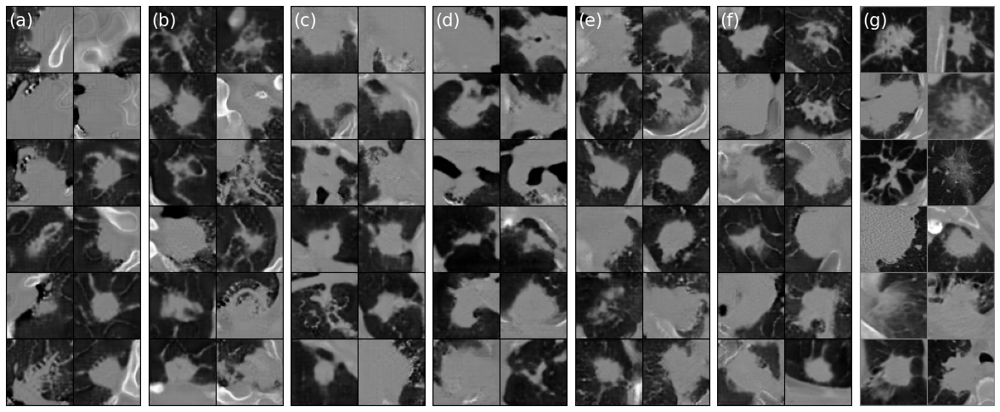

=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint
=> Loading checkpoint


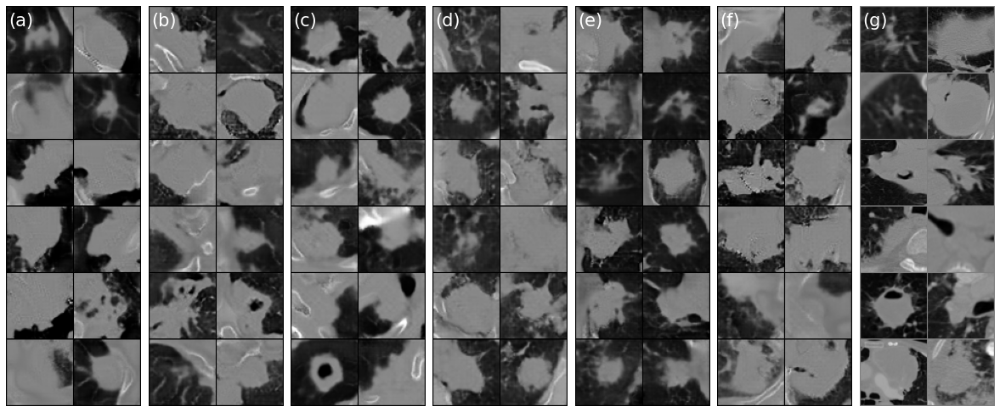

In [159]:
alpha = 1.0
step=4
z_dim=512
device="cuda" if torch.cuda.is_available() else "cpu"
learning_rate=1e-3
in_channels=512
channels_img=1
n = 12
IMAGE_SIZE = 64
BATCH_SIZE = 12
MIN_HU_VALUE = -1024
MAX_HU_VALUE = 1000
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean = [0.5],
                         std  = [0.5]),
    ])
    
for hist_type in ['adeno', 'squamous']:
    gen_checkpoints = [
        f'generator_pggan_roi_{hist_type}_epochs_30_alpha_0.75_bs_64_64_64_32_32_affn_trns_only.pth.tar',
        f'generator_pggan_roi_{hist_type}_epochs_50_alpha_0.75_bs_64_64_64_32_32_affn_trns_only.pth.tar',
        f'generator_pggan_roi_{hist_type}_epochs_75_alpha_0.75_bs_64_64_64_32_32_affn_trns_only.pth.tar',
        f'generator_pggan_roi_{hist_type}_all_data.pth.tar', 
        f'generator_pggan_roi_{hist_type}_epochs_75_lr_0.001.pth.tar',
        f'generator_pggan_roi_{hist_type}_epochs_30_30_50_50_75_alpha_0.75_bs_32_32_32_32_32_affn_trns_only.pth.tar',
    ]
    grids = []
    for i, gen_checkpoint in enumerate(gen_checkpoints):
        gen = Generator(z_dim, in_channels, img_channels=channels_img).to(device)
        opt_gen = optim.Adam(gen.parameters(), lr=learning_rate, betas=(0.0, 0.99))
        load_checkpoint(gen_checkpoint, gen, opt_gen, learning_rate)
        gen.eval()
        fake_images = []
        with torch.no_grad():
            for i in range(n):
                noise = torch.randn(1, z_dim, 1, 1).to(device)
                fake_image = gen(noise, alpha, step)
                fake_image = fake_image * 0.5 + 0.5
                fake_images.append(fake_image)
        grid = make_grid(torch.cat(fake_images, dim=0), nrow=2, padding=1)
        grids.append(grid)

    train_loader, val_loader, test_loader = get_loaders(
        train_dir = f'/Storage/PauloOctavioDir/nodule_rois/gan/{hist_type}/images',
        val_dir = '/Storage/PauloOctavioDir/splitted_folders/VGG-GAN/val/images',
        test_dir = '/Storage/PauloOctavioDir/splitted_folders/VGG-GAN/test/images',
        train_transform = transform,
        test_transform = transform,
    )

    for real_images, _ in train_loader:
        real_images_grid = make_grid(real_images, nrow=2, padding=1)
        grids.append(real_images_grid  * 0.5 + 0.5)
        break

    fig, axs = plt.subplots(ncols=7, squeeze=False, figsize=(16, 6))
    plt.axis('off')
    [axi.axis('off') for axi in axs.ravel()]
    fig.tight_layout(pad=-2)
    for i, img in enumerate(grids):
        img = img.detach()
        img = torchvision.transforms.functional.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
        axs[0, i].text(0.02,0.95,'('+chr(97 + i)+')', transform=axs[0, i].transAxes, color='white', fontsize=21)
    plt.savefig(f'plots/imagens_{hist_type}_geradas_pela_gan.png', dpi=500, transparent=False, bbox_inches='tight')
    plt.show()

In [185]:
len(fake_images)

36

=> Loading checkpoint


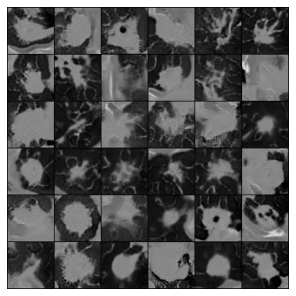

=> Loading checkpoint


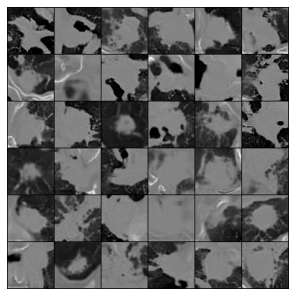

In [10]:
alpha = 1.0
step=4
z_dim=512
device="cuda" if torch.cuda.is_available() else "cpu"
learning_rate=1e-3
in_channels=512
channels_img=1
n = 36
IMAGE_SIZE = 64
BATCH_SIZE = 36
MIN_HU_VALUE = -1024
MAX_HU_VALUE = 1000
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean = [0.5],
                         std  = [0.5]),
    ])
    
for hist_type in ['adeno', 'squamous']:
    if hist_type == 'adeno':
        gen_checkpoint = f'generator_pggan_roi_{hist_type}_epochs_30_30_50_50_75_alpha_0.75_bs_32_32_32_32_32_affn_trns_only.pth.tar'
    else:
        gen_checkpoint = f'generator_pggan_roi_{hist_type}_epochs_50_alpha_0.75_bs_64_64_64_32_32_affn_trns_only.pth.tar'
    grids = []
    gen = Generator(z_dim, in_channels, img_channels=channels_img).to(device)
    opt_gen = optim.Adam(gen.parameters(), lr=learning_rate, betas=(0.0, 0.99))
    load_checkpoint(gen_checkpoint, gen, opt_gen, learning_rate)
    gen.eval()
    fake_images = []
    with torch.no_grad():
        for i in range(n):
            noise = torch.randn(1, z_dim, 1, 1).to(device)
            fake_image = gen(noise, alpha, step)
            fake_image = fake_image * 0.5 + 0.5
            fake_images.append(fake_image)
    grid = make_grid(torch.cat(fake_images, dim=0), nrow=6, padding=1)
    img = grid.detach()
    img = torchvision.transforms.functional.to_pil_image(img)
    plt.axis('off')
    plt.imshow(np.asarray(img))
    plt.savefig(f'plots/grid_{hist_type}.png', dpi=300, transparent=True, bbox_inches='tight')
    plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  """


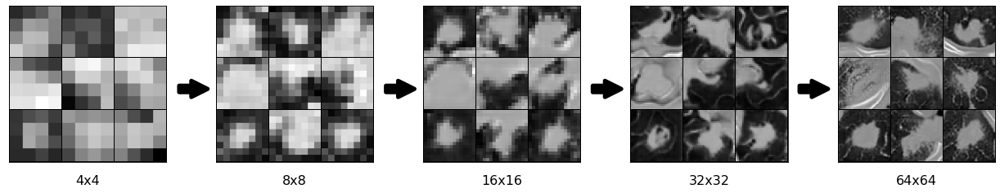

In [141]:
imgs_files_dir = '/home/mainlab1/TCCPauloLucas2/Nodule_Classification/gan_fakes/pggan_roi_adeno_epochs_30_30_50_50_75_alpha_0.75_bs_64_64_64_32_32_affn_trns_only/'

fig, axs = plt.subplots(ncols=5, squeeze=False, figsize=(18, 6))
# [axi.axis('off') for axi in axs.ravel()]
fig.tight_layout(pad=3)
for i, img_file in enumerate([
    'grid_4x4_29.png', 'grid_8x8_59.png', 'grid_16x16_109.png', 'grid_32x32_159.png', 'grid_64x64_224.png']):
    img = imageio.imread(imgs_files_dir + img_file)
    res = img_file.split('_')[1]

    axs[0, i].imshow(np.asarray(img))
    axs[0, i].set_xlabel(res, fontsize=16, labelpad=16)
    axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    x =  0.2 + (i * 0.195)
    if i != 4:
        arrow = patches.FancyArrowPatch(
            [x,.5],  # posA
            [x + .03, .5],  # posB
            transform=fig.transFigure,
            color="black",
            arrowstyle="simple",  # "normal" arrow
            mutation_scale=40,  # controls arrow head size
            linewidth=5,
        )
        fig.patches.append(arrow)
plt.savefig(f'plots/pggan_training_increasing_res.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

In [152]:
IMAGE_SIZE = 64
BATCH_SIZE = 12
MIN_HU_VALUE = -1024
MAX_HU_VALUE = 1000
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean = [0.5],
                         std  = [0.5]),
    ])

train_loader, val_loader, test_loader = get_loaders(
    train_dir = '/Storage/PauloOctavioDir/nodule_rois/gan/adeno/images',
    val_dir = '/Storage/PauloOctavioDir/splitted_folders/VGG-GAN/val/images',
    test_dir = '/Storage/PauloOctavioDir/splitted_folders/VGG-GAN/test/images',
    train_transform = transform,
    test_transform = transform,
)

for img, _ in train_loader:
    real_img_grid = make_grid(img, nrow=2, padding=1)
    break

0
1


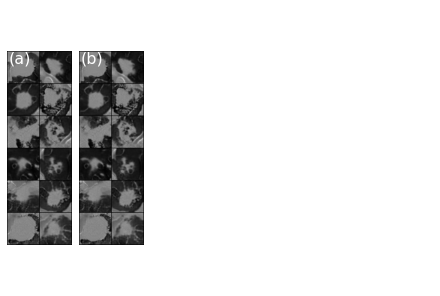

In [124]:
if not isinstance(grid, list):
    grid = [grid]
fig, axs = plt.subplots(ncols=6, squeeze=False)
plt.axis('off')
[axi.axis('off') for axi in axs.ravel()]
grids = [grid, grid]
for i, x in enumerate(grids):
    print(i)
    img = x[0]
    img = img.detach()
    img = torchvision.transforms.functional.to_pil_image(img)
    axs[0, i].imshow(np.asarray(img))
    axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    axs[0, i].text(0.02,0.94,'('+chr(97 + i)+')', transform=axs[0, i].transAxes, color='white', fontsize=16)
plt.show()
# print(gen_checkpoint)
# show(grid)
# save_image(grid.float(), f'example_{hist_type}_grid.png')

In [26]:
df = pd.read_csv('data/lung_neoplasm_database_cleaned_ds.csv')
df[df['TIPO HISTOLÓGICO'] == 'NSCLC adeno']

,Unnamed: 0,REG EXAME,DATA NASCIMENTO,SEXO,TABAGISMO PREGRESSO,DATA TC,TECNICA TC,LOBO DA LESÃO,POSIÇÃO DA LESÃO,MAIOR DIÂMETRO,ESTADIO T,ESTADIO N,ESTADIO M,DATA 1o DIAGN PATOLÓGICO,TIPO PATOLOGIA (FINAL),TIPO HISTOLÓGICO,DATA PROGRESSÃO DOENÇA,LOCAL DA PROGRESSÃO
0,0,1,1947-08-19,masc,X,2017-03-02,MDTC contraste,LID,periférica,30,2a,0,1c,2017-08-02,NaN,NSCLC adeno,NaN,NaN
1,1,2,1946-01-25,masc,X,2015-10-26,MDTC contraste,Lin,periférica,23,1b,0,1c,2015-08-12,biópsia percutânea,NSCLC adeno,2016-06-29,1
2,2,3,1942-07-30,fem,X,2016-03-14,MDTC contraste,LSD,periférica,11,1a,0,0,2016-04-13,biópsia percutânea,NSCLC adeno,2017-07-18,"5, 8, 6"
6,6,7,1950-12-24,fem,X,2013-10-23,MDTC contraste,LIE,periférica,25,1c,0,0,2013-09-27,cirurgia,NSCLC adeno,NaN,NaN
7,7,8,1951-02-22,fem,X,2014-11-19,MDTC contraste,Lin,periférica,33,2a,0,0,2016-02-25,cirurgia,NSCLC adeno,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114,114,117,1951-09-09,masc,0,2018-08-11,MDTC contraste,LSE,central,29,1c,1,1b,2018-11-08,biópsia percutânea,NSCLC adeno,NaN,NaN
115,115,118,1952-01-29,masc,X,2018-08-28,MDTC contraste,LSE,periférica,27,1c,0,0,2018-12-12,biópsia percutânea,NSCLC adeno,NaN,NaN
119,119,122,1995-08-19,fem,0,2019-01-16,MDTC contraste,LSD,central,11,1b,0,0,2019-03-07,cirurgia,NSCLC adeno,NaN,NaN
120,120,123,1956-12-07,masc,X,2019-01-25,MDTC contraste,LSD,periférica,51,3,3,1c,2019-02-01,biópsia percutânea,NSCLC adeno,NaN,NaN


In [13]:
img_file_scc = "/Storage/PauloOctavioDir/Exames/33/dicomRT/Original-dcm/"   
msk_file_scc = "/Storage/PauloOctavioDir/Exames/33/Segmentado/dcm/" 
for i in sorted(os.listdir(img_file_scc)):
    if i != 'rtss.dcm' and i != 'IMG0000.dcm':
        mask_data = dcmread(msk_file_scc + i).pixel_array
        image_data = dcmread(img_file_scc + i).pixel_array
        if mask_data.any():
            fig, axes = plt.subplots(1,2)
            axes[0].imshow(image_data)
            axes[1].imshow(mask_data)
            print(i)
            plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:51: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


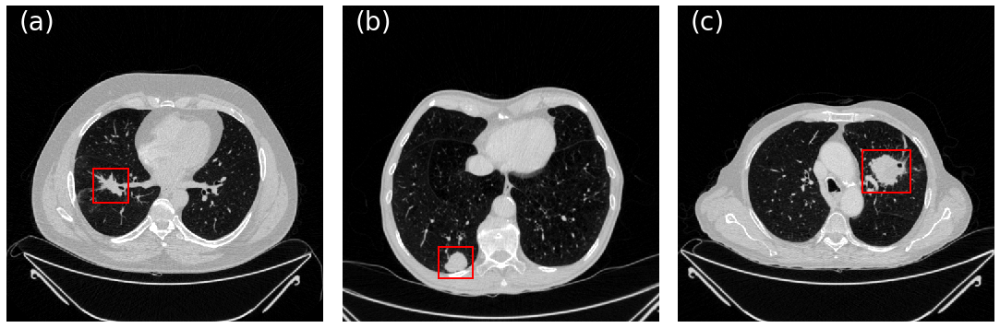

In [16]:
selem = disk(1)
binary_dilated = binary_dilation(mask, selem)

# SCC
img_file_scc = "/Storage/PauloOctavioDir/Exames/59/dicomRT/Original-dcm/IMG0160.dcm"   
msk_file_scc = "/Storage/PauloOctavioDir/Exames/59/Segmentado/dcm/IMG0160.dcm" 
mask_data_scc = dcmread(msk_file_scc)
image_data_scc = dcmread(img_file_scc)
mask_scc = mask_data_scc.pixel_array
image_scc = get_hu_image_windowed(img_file_scc)
bboxes = mask_to_bbox(mask_scc)

bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10
rect_scc = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')

# ADC
img_file_adc = "/Storage/PauloOctavioDir/Exames/70/dicomRT/Original-dcm/IMG0141.dcm"   
msk_file_adc = "/Storage/PauloOctavioDir/Exames/70/Segmentado/dcm/IMG0141.dcm" 
mask_data_adc = dcmread(msk_file_adc)
image_data_adc = dcmread(img_file_adc)
mask_adc = mask_data_adc.pixel_array
image_adc = get_hu_image_windowed(img_file_adc)
bboxes = mask_to_bbox(mask_adc)

bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10
rect_adc = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')

# LCC
img_file_lcc = "/Storage/PauloOctavioDir/Exames/5/dicomRT/Original-dcm/IMG0206.dcm"   
msk_file_lcc = "/Storage/PauloOctavioDir/Exames/5/Segmentado/dcm/IMG0206.dcm" 
mask_data_lcc = dcmread(msk_file_lcc)
image_data_lcc = dcmread(img_file_lcc)
mask_lcc = mask_data_lcc.pixel_array
image_lcc = get_hu_image_windowed(img_file_lcc)
bboxes = mask_to_bbox(mask_lcc)

bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10
rect_lcc = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')

size = 5
fig, axes = plt.subplots(1,3, figsize=(size * 3, size))
fig.tight_layout(pad=-1)

axes[0].set_axis_off()
axes[1].set_axis_off()
axes[2].set_axis_off()

axes[0].imshow(image_scc, cmap='gray', interpolation='none')
axes[1].imshow(image_adc, cmap='gray', interpolation='none')
axes[2].imshow(image_lcc, cmap='gray', interpolation='none')

transFigure = fig.transFigure.inverted()

axes[0].add_patch(rect_scc)
axes[1].add_patch(rect_adc)
axes[2].add_patch(rect_lcc)


axes[0].text(0.04,0.925,'('+chr(97)+')', transform=axes[0].transAxes, color='white', fontsize=28)
axes[1].text(0.04,0.925,'('+chr(98)+')', transform=axes[1].transAxes, color='white', fontsize=28)
axes[2].text(0.04,0.925,'('+chr(99)+')', transform=axes[2].transAxes, color='white', fontsize=28)

plt.savefig('plots/exemplo_subtipo_histologico.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

/home/mainlab1/PauloLucas/lib/python3.6/site-packages/ipykernel_launcher.py:51: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


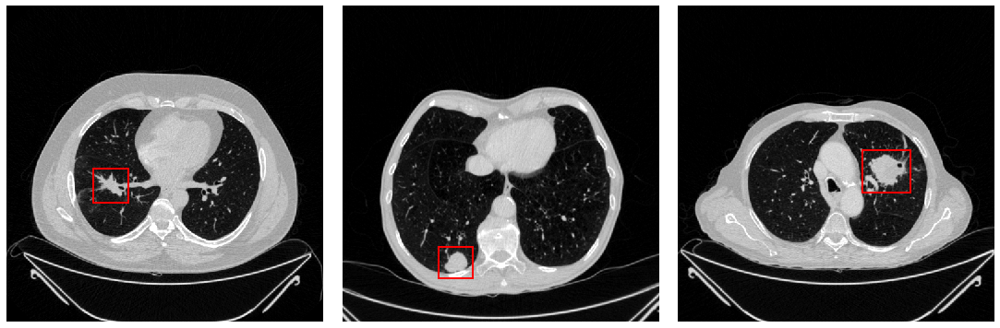

In [21]:
selem = disk(1)
# binary_dilated = binary_dilation(mask, selem)

# SCC
img_file_scc = "/Storage/PauloOctavioDir/Exames/59/dicomRT/Original-dcm/IMG0160.dcm"   
msk_file_scc = "/Storage/PauloOctavioDir/Exames/59/Segmentado/dcm/IMG0160.dcm" 
mask_data_scc = dcmread(msk_file_scc)
image_data_scc = dcmread(img_file_scc)
mask_scc = mask_data_scc.pixel_array
image_scc = get_hu_image_windowed(img_file_scc)
bboxes = mask_to_bbox(mask_scc)

bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10
rect_scc = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')

# ADC
img_file_adc = "/Storage/PauloOctavioDir/Exames/70/dicomRT/Original-dcm/IMG0141.dcm"   
msk_file_adc = "/Storage/PauloOctavioDir/Exames/70/Segmentado/dcm/IMG0141.dcm" 
mask_data_adc = dcmread(msk_file_adc)
image_data_adc = dcmread(img_file_adc)
mask_adc = mask_data_adc.pixel_array
image_adc = get_hu_image_windowed(img_file_adc)
bboxes = mask_to_bbox(mask_adc)

bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10
rect_adc = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')

# LCC
img_file_lcc = "/Storage/PauloOctavioDir/Exames/5/dicomRT/Original-dcm/IMG0206.dcm"   
msk_file_lcc = "/Storage/PauloOctavioDir/Exames/5/Segmentado/dcm/IMG0206.dcm" 
mask_data_lcc = dcmread(msk_file_lcc)
image_data_lcc = dcmread(img_file_lcc)
mask_lcc = mask_data_lcc.pixel_array
image_lcc = get_hu_image_windowed(img_file_lcc)
bboxes = mask_to_bbox(mask_lcc)

bboxes[0] = bboxes[0] - 10
bboxes[1] = bboxes[1] - 10
bboxes[2] = bboxes[2] + 10
bboxes[3] = bboxes[3] + 10
rect_lcc = patches.Rectangle((bboxes[0], bboxes[1]), bboxes[2] - bboxes[0], bboxes[3] - bboxes[1], linewidth=2, edgecolor='r', facecolor='none')

size = 5
fig, axes = plt.subplots(1,3, figsize=(size * 3, size))
fig.tight_layout(pad=-1)

axes[0].set_axis_off()
axes[1].set_axis_off()
axes[2].set_axis_off()

axes[0].imshow(image_scc, cmap='gray', interpolation='none')
axes[1].imshow(image_adc, cmap='gray', interpolation='none')
axes[2].imshow(image_lcc, cmap='gray', interpolation='none')

transFigure = fig.transFigure.inverted()

axes[0].add_patch(rect_scc)
axes[1].add_patch(rect_adc)
axes[2].add_patch(rect_lcc)


plt.savefig('plots/exemplo_tc_nodulo.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

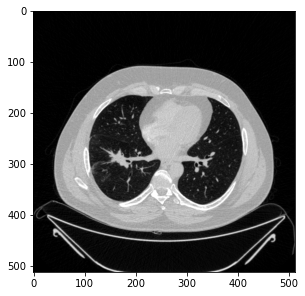

In [84]:
img = 'IMG0160'   # HCRP_LUSC_059_IMG0160
exam = '59'
img_file = f"/Storage/PauloOctavioDir/Exames/{exam}/dicomRT/Original-dcm/{img}.dcm"
msk_file = f"/Storage/PauloOctavioDir/Exames/{exam}/Segmentado/dcm/{img}.dcm"  
dicom_data = dcmread(img_file)
image_data = dicom_data.pixel_array
mask_data = dcmread(msk_file).pixel_array
intercept = int(dicom_data.RescaleIntercept)
slope = int(dicom_data.RescaleSlope)
image_data = (slope * image_data) + intercept
image = get_hu_image_windowed(img_file)

plt.imshow(image, cmap='gray')

HCRP_LUSC_087_IMG0227.dcm (110, 67)


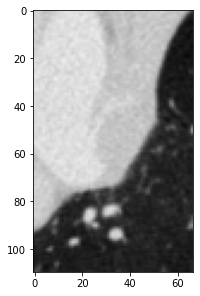

HCRP_LUSC_023_IMG0261.dcm (74, 69)


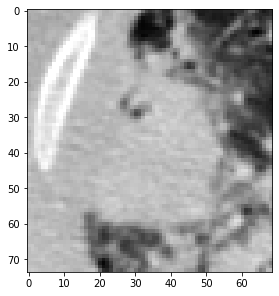

HCRP_LUSC_127_IMG0095.dcm (68, 72)


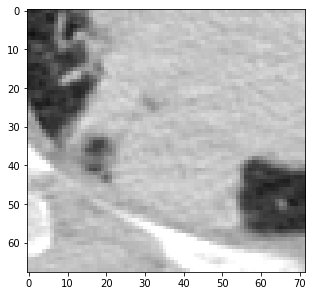

HCRP_LUSC_035_IMG0212.dcm (49, 47)


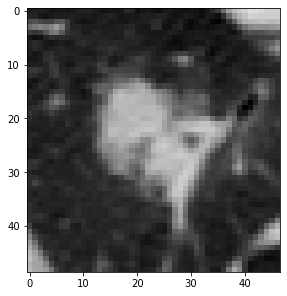

HCRP_LUSC_103_IMG0212.dcm (67, 86)


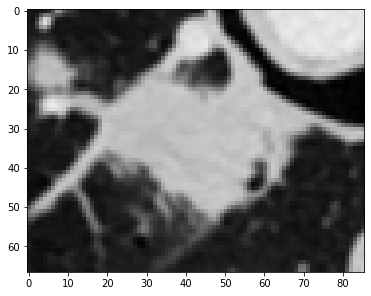

HCRP_LUSC_103_IMG0218.dcm (76, 93)


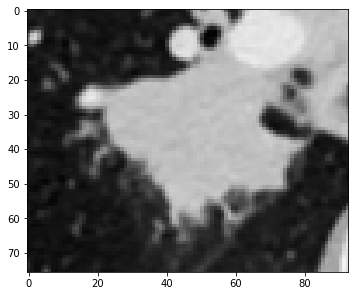

HCRP_LUSC_126_IMG0123.dcm (72, 75)


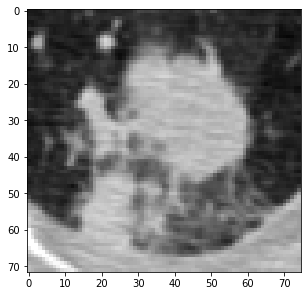

HCRP_LUSC_087_IMG0225.dcm (112, 69)


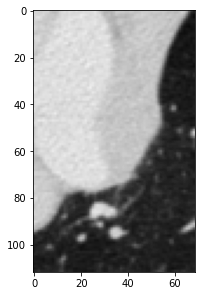

HCRP_LUSC_059_IMG0172.dcm (55, 55)


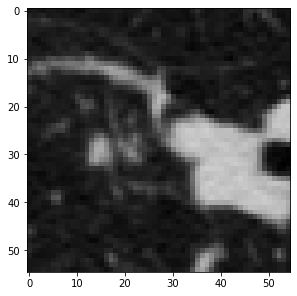

HCRP_LUSC_037_IMG0125.dcm (67, 69)


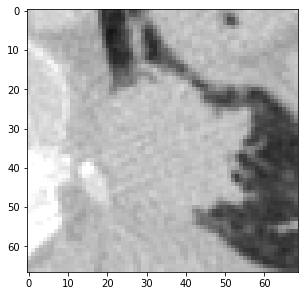

HCRP_LUSC_100_IMG0228.dcm (46, 38)


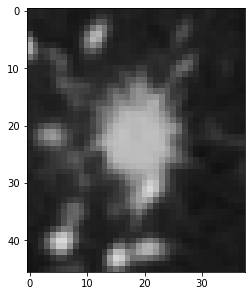

HCRP_LUSC_087_IMG0213.dcm (105, 86)


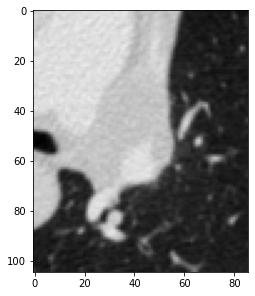

HCRP_LUSC_081_IMG0137.dcm (61, 69)


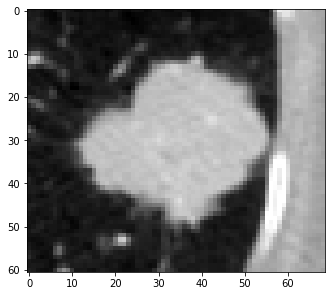

HCRP_LUSC_006_IMG0200.dcm (48, 44)


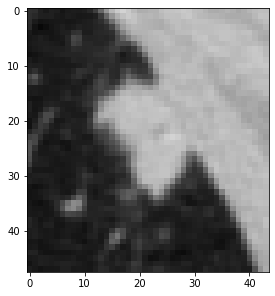

HCRP_LUSC_018_IMG0262.dcm (50, 41)


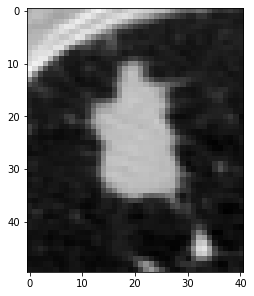

HCRP_LUSC_051_IMG0282.dcm (44, 46)


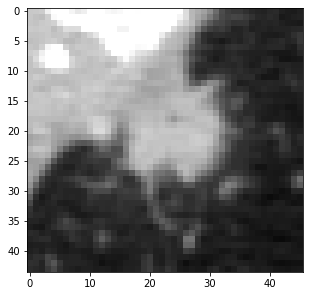

HCRP_LUSC_087_IMG0230.dcm (111, 72)


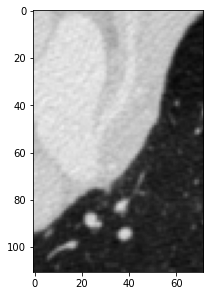

HCRP_LUSC_126_IMG0156.dcm (80, 57)


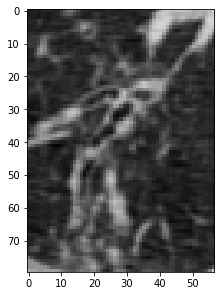

HCRP_LUSC_107_IMG0206.dcm (88, 73)


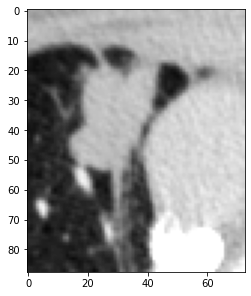

HCRP_LUSC_126_IMG0142.dcm (91, 87)


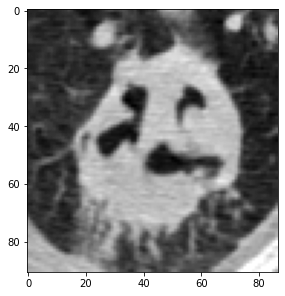

HCRP_LUSC_074_IMG0271.dcm (49, 42)


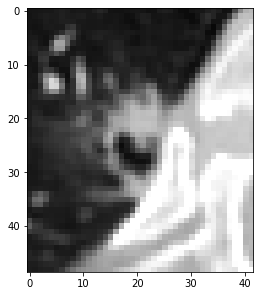

HCRP_LUSC_091_IMG0218.dcm (97, 68)


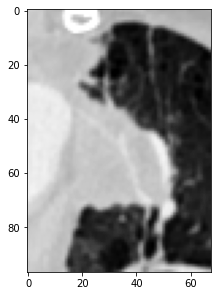

HCRP_LUSC_089_IMG0184.dcm (62, 55)


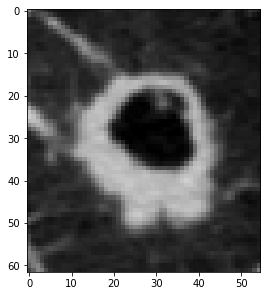

HCRP_LUSC_087_IMG0200.dcm (114, 81)


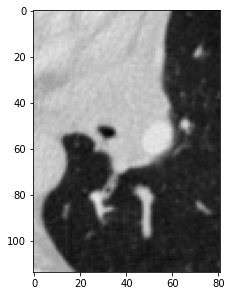

HCRP_LUSC_127_IMG0120.dcm (87, 73)


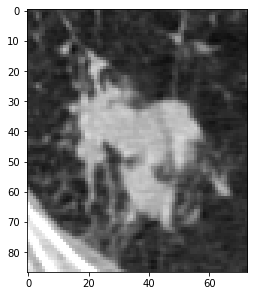

HCRP_LUSC_091_IMG0289.dcm (136, 105)


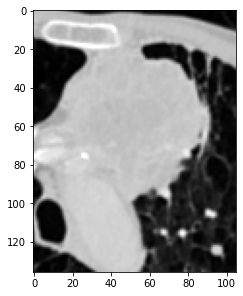

HCRP_LUSC_015_IMG0120.dcm (54, 57)


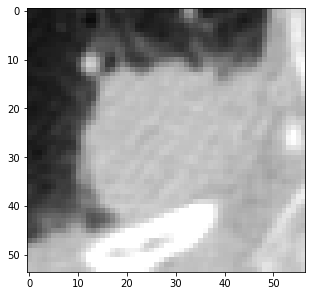

HCRP_LUSC_081_IMG0166.dcm (56, 52)


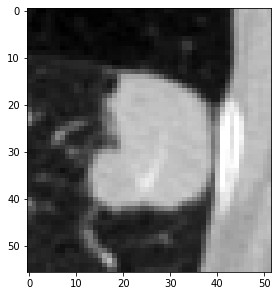

HCRP_LUSC_023_IMG0239.dcm (91, 92)


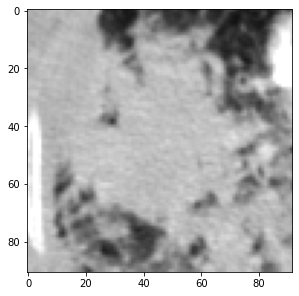

HCRP_LUSC_081_IMG0163.dcm (60, 60)


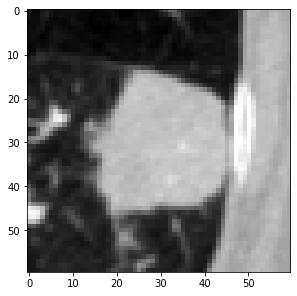

HCRP_LUSC_006_IMG0182.dcm (60, 64)


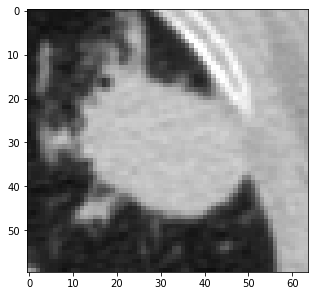

HCRP_LUSC_006_IMG0201.dcm (45, 41)


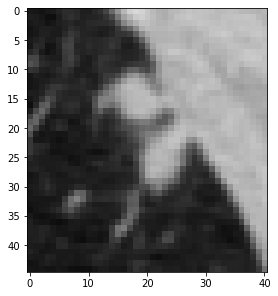

HCRP_LUSC_074_IMG0268.dcm (52, 47)


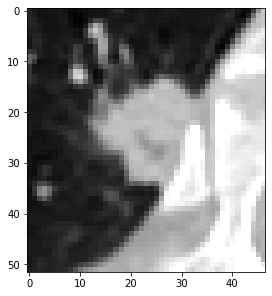

HCRP_LUSC_015_IMG0138.dcm (70, 65)


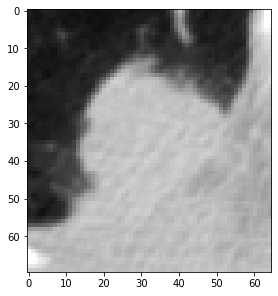

HCRP_LUSC_091_IMG0224.dcm (107, 76)


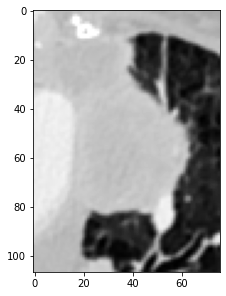

HCRP_LUSC_091_IMG0234.dcm (124, 118)


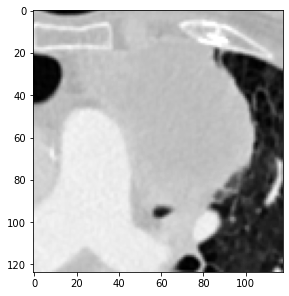

HCRP_LUSC_127_IMG0129.dcm (42, 36)


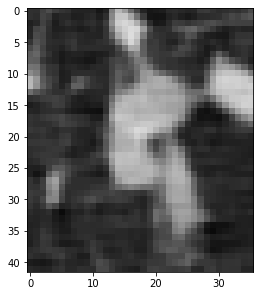

HCRP_LUSC_006_IMG0184.dcm (63, 67)


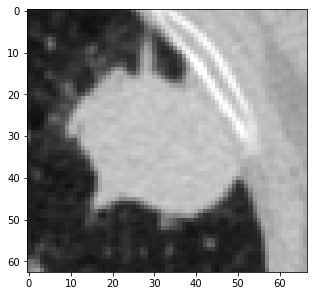

HCRP_LUSC_023_IMG0243.dcm (88, 86)


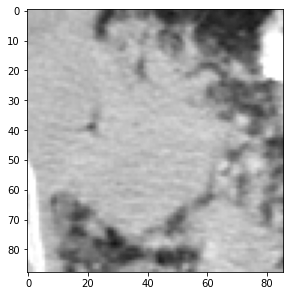

HCRP_LUSC_006_IMG0188.dcm (57, 67)


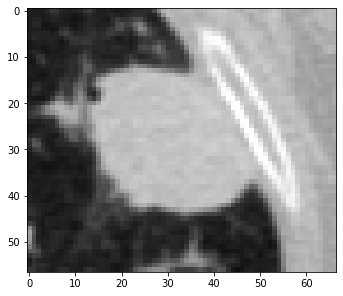

HCRP_LUSC_091_IMG0272.dcm (145, 127)


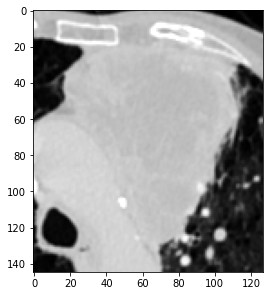

HCRP_LUSC_023_IMG0244.dcm (88, 87)


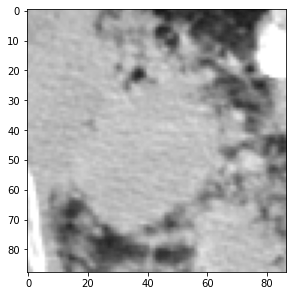

HCRP_LUSC_126_IMG0130.dcm (101, 86)


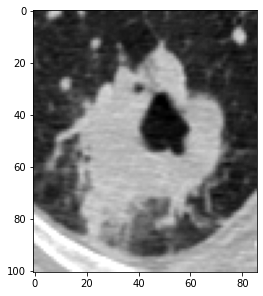

HCRP_LUSC_071_IMG0120.dcm (41, 55)


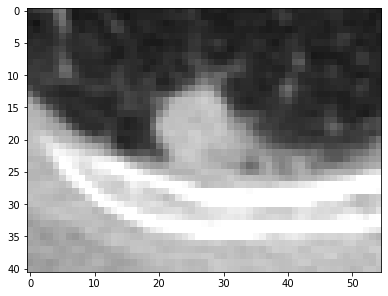

HCRP_LUSC_091_IMG0265.dcm (137, 143)


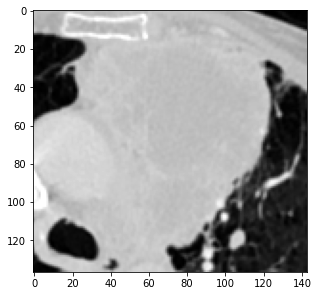

HCRP_LUSC_013_IMG0230.dcm (59, 54)


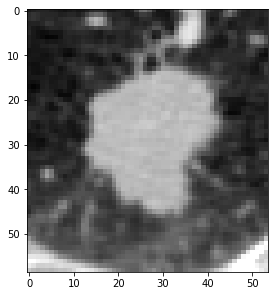

HCRP_LUSC_126_IMG0128.dcm (99, 80)


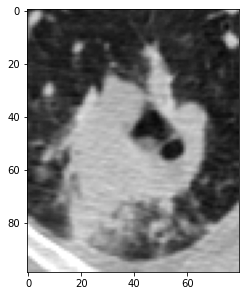

HCRP_LUSC_015_IMG0125.dcm (62, 63)


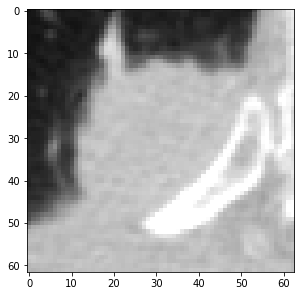

HCRP_LUSC_087_IMG0185.dcm (84, 79)


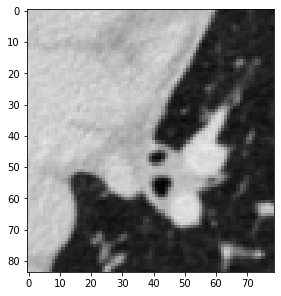

HCRP_LUSC_091_IMG0236.dcm (138, 115)


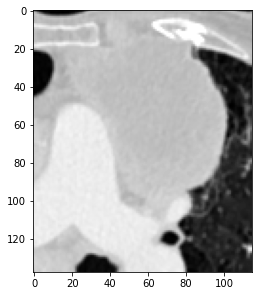

HCRP_LUSC_081_IMG0160.dcm (65, 71)


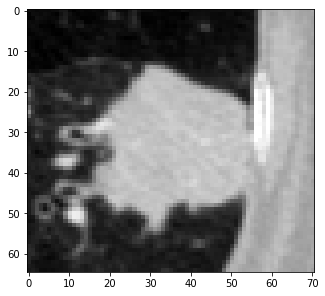

HCRP_LUSC_051_IMG0276.dcm (50, 54)


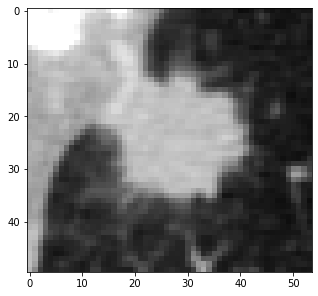

HCRP_LUSC_037_IMG0135.dcm (39, 49)


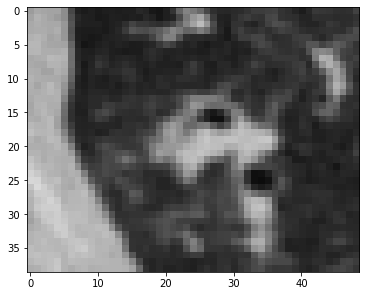

HCRP_LUSC_074_IMG0266.dcm (49, 47)


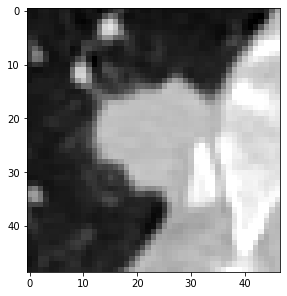

HCRP_LUSC_091_IMG0283.dcm (134, 112)


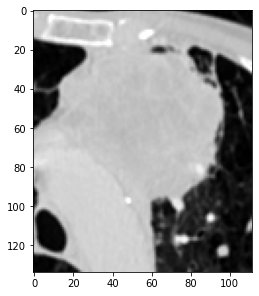

HCRP_LUSC_091_IMG0241.dcm (153, 115)


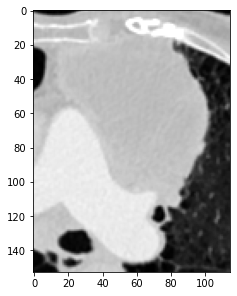

HCRP_LUSC_096_IMG0234.dcm (76, 64)


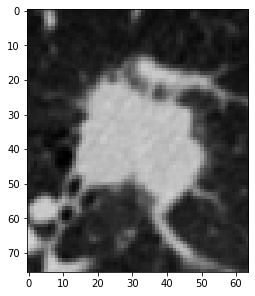

HCRP_LUSC_029_IMG0562.dcm (79, 64)


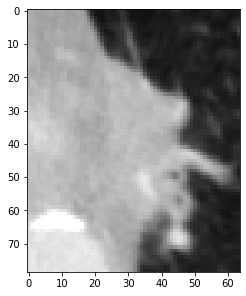

HCRP_LUSC_126_IMG0150.dcm (87, 68)


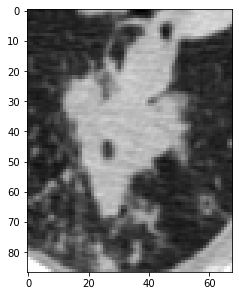

HCRP_LUSC_029_IMG0571.dcm (76, 67)


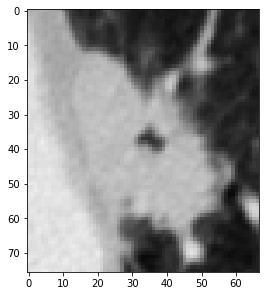

HCRP_LUSC_006_IMG0178.dcm (51, 57)


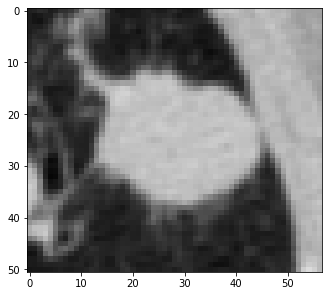

HCRP_LUSC_023_IMG0233.dcm (72, 90)


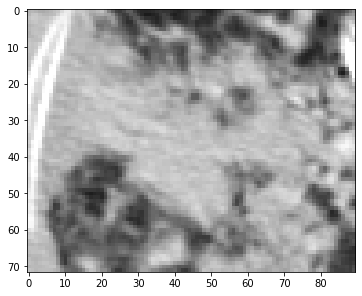

HCRP_LUSC_091_IMG0300.dcm (99, 92)


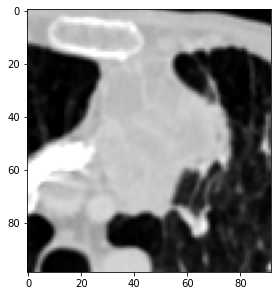

HCRP_LUSC_114_IMG0155.dcm (69, 78)


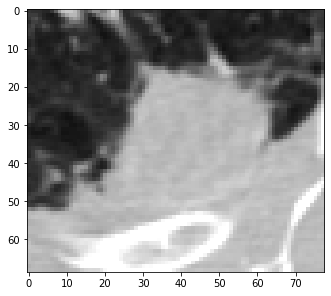

HCRP_LUSC_107_IMG0203.dcm (74, 81)


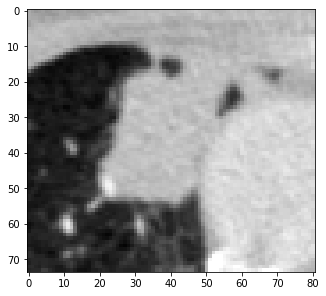

HCRP_LUSC_126_IMG0152.dcm (78, 62)


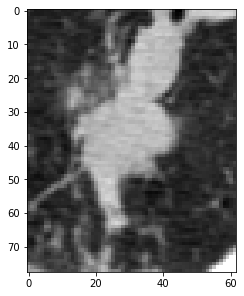

HCRP_LUSC_074_IMG0253.dcm (48, 50)


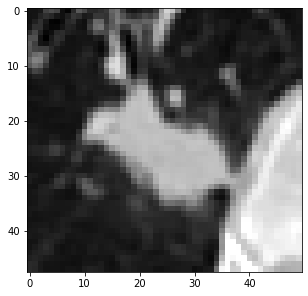

HCRP_LUSC_087_IMG0234.dcm (94, 76)


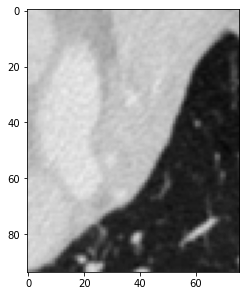

HCRP_LUSC_081_IMG0149.dcm (76, 81)


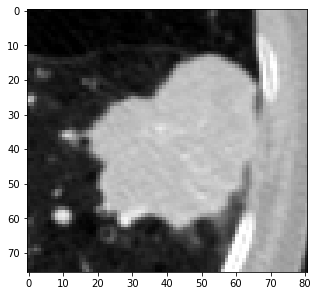

HCRP_LUSC_035_IMG0201.dcm (52, 57)


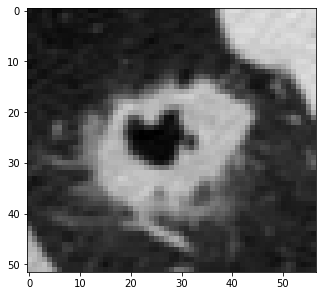

HCRP_LUSC_081_IMG0131.dcm (42, 45)


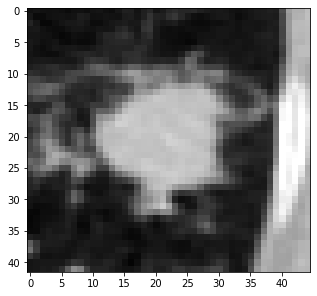

HCRP_LUSC_059_IMG0160.dcm (61, 62)


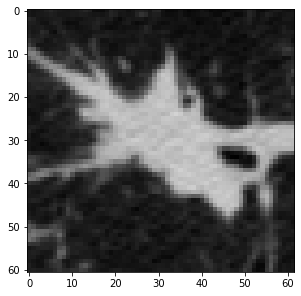

HCRP_LUSC_006_IMG0181.dcm (61, 62)


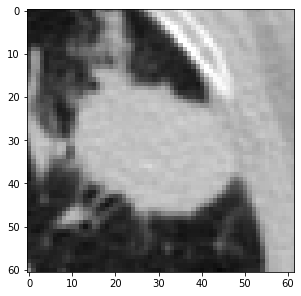

HCRP_LUSC_023_IMG0268.dcm (69, 52)


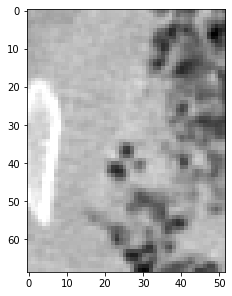

HCRP_LUSC_126_IMG0112.dcm (40, 45)


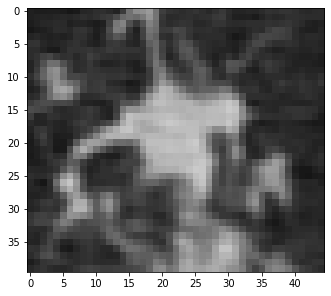

HCRP_LUSC_029_IMG0591.dcm (51, 61)


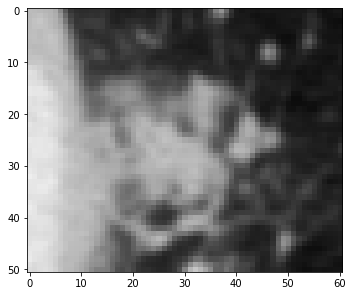

HCRP_LUSC_029_IMG0563.dcm (77, 70)


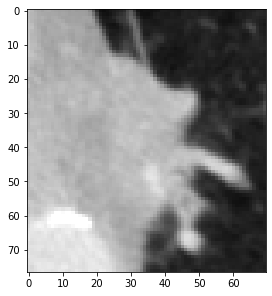

HCRP_LUSC_023_IMG0270.dcm (61, 49)


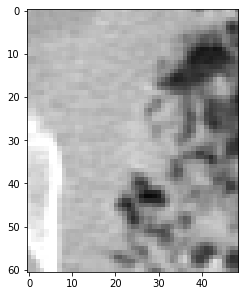

HCRP_LUSC_069_IMG0236.dcm (66, 79)


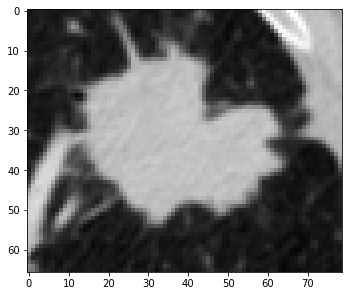

HCRP_LUSC_035_IMG0207.dcm (54, 56)


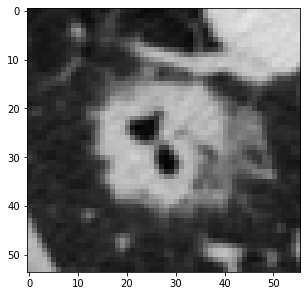

HCRP_LUSC_103_IMG0251.dcm (49, 53)


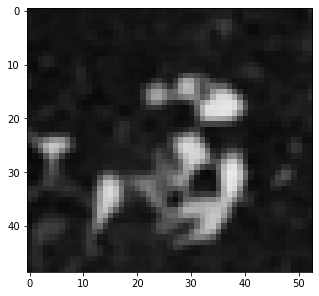

HCRP_LUSC_051_IMG0280.dcm (51, 52)


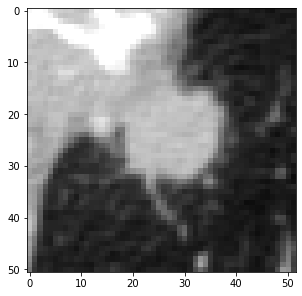

HCRP_LUSC_029_IMG0593.dcm (48, 59)


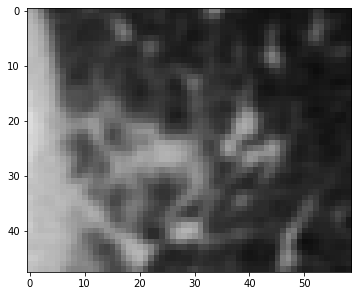

HCRP_LUSC_114_IMG0175.dcm (50, 51)


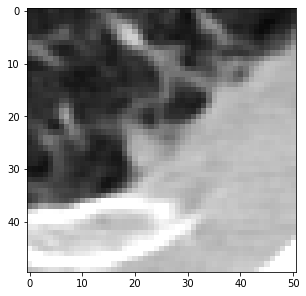

HCRP_LUSC_087_IMG0208.dcm (98, 80)


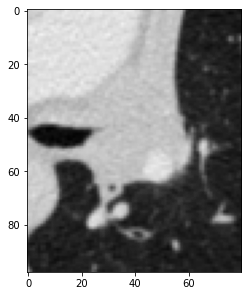

HCRP_LUSC_074_IMG0269.dcm (48, 47)


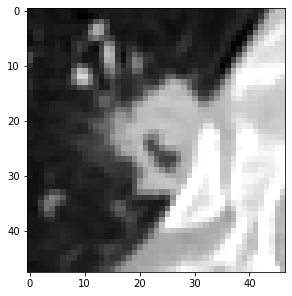

HCRP_LUSC_081_IMG0156.dcm (69, 73)


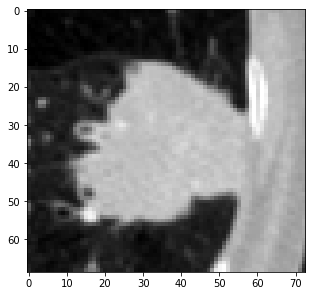

HCRP_LUSC_091_IMG0228.dcm (107, 83)


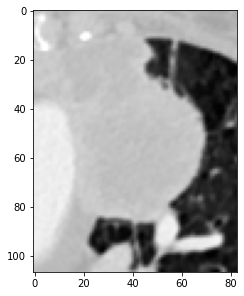

HCRP_LUSC_096_IMG0226.dcm (46, 40)


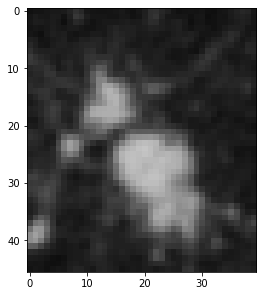

HCRP_LUSC_081_IMG0151.dcm (75, 76)


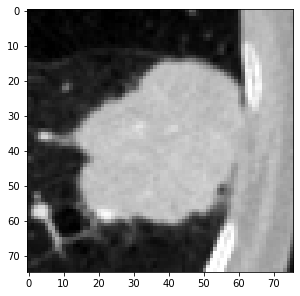

HCRP_LUSC_081_IMG0161.dcm (64, 67)


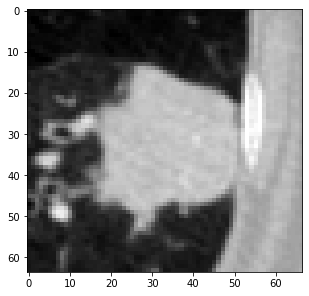

HCRP_LUSC_103_IMG0219.dcm (77, 92)


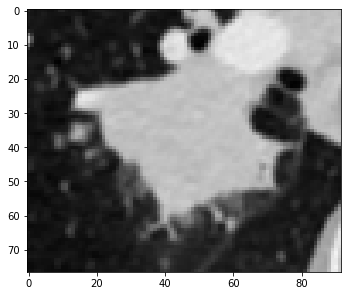

HCRP_LUSC_091_IMG0248.dcm (152, 135)


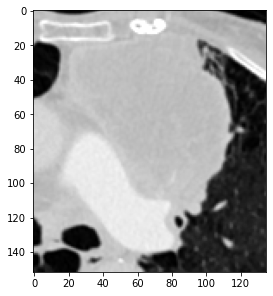

HCRP_LUSC_023_IMG0267.dcm (67, 56)


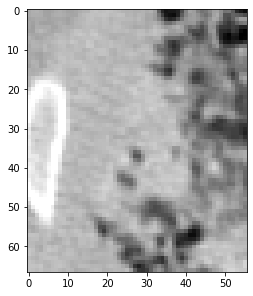

HCRP_LUSC_096_IMG0228.dcm (54, 50)


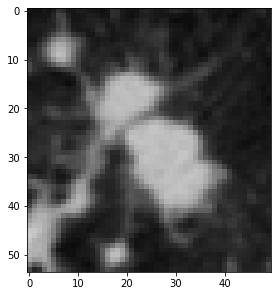

HCRP_LUSC_029_IMG0585.dcm (68, 69)


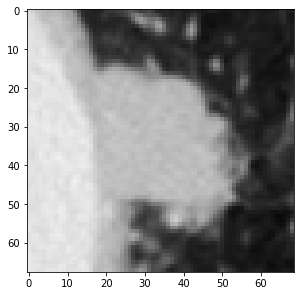

HCRP_LUSC_059_IMG0155.dcm (60, 54)


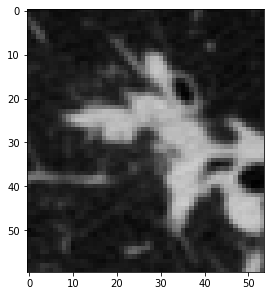

HCRP_LUSC_127_IMG0119.dcm (87, 74)


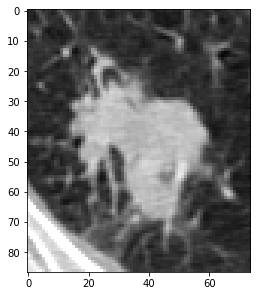

HCRP_LUSC_023_IMG0240.dcm (90, 95)


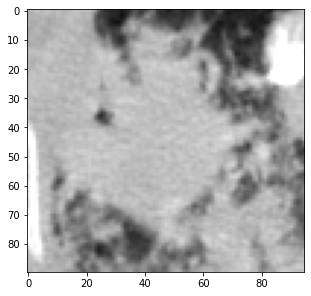

HCRP_LUSC_091_IMG0268.dcm (146, 139)


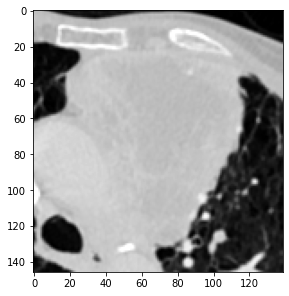

HCRP_LUSC_125_IMG0200.dcm (71, 69)


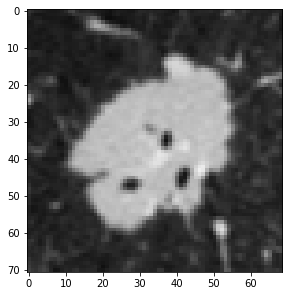

HCRP_LUSC_087_IMG0210.dcm (100, 82)


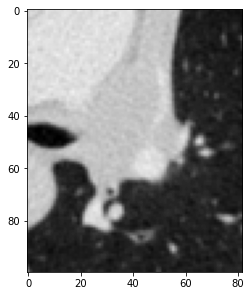

HCRP_LUSC_089_IMG0182.dcm (56, 52)


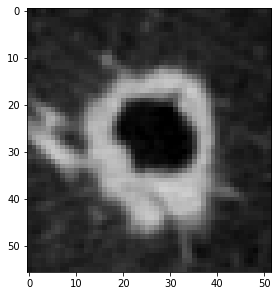

HCRP_LUSC_091_IMG0225.dcm (104, 78)


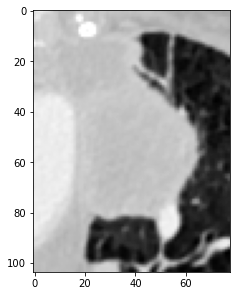

HCRP_LUSC_023_IMG0252.dcm (86, 79)


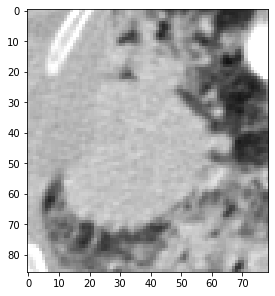

HCRP_LUSC_091_IMG0257.dcm (140, 139)


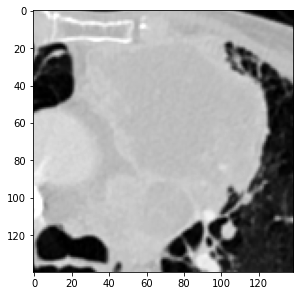

HCRP_LUSC_074_IMG0264.dcm (56, 48)


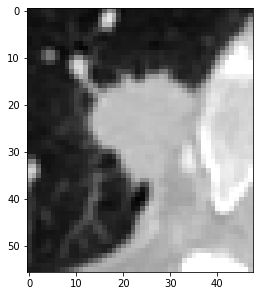

HCRP_LUSC_023_IMG0257.dcm (83, 72)


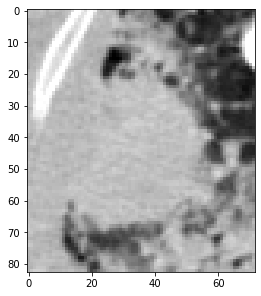

HCRP_LUSC_051_IMG0277.dcm (49, 53)


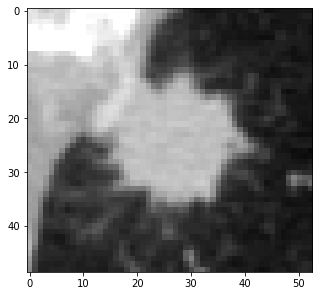

HCRP_LUSC_028_IMG0179.dcm (46, 39)


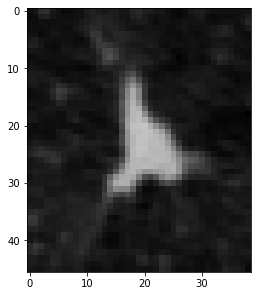

HCRP_LUSC_028_IMG0180.dcm (45, 38)


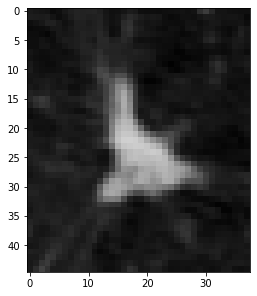

HCRP_LUSC_107_IMG0200.dcm (78, 73)


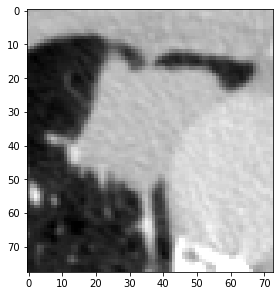

HCRP_LUSC_023_IMG0254.dcm (84, 80)


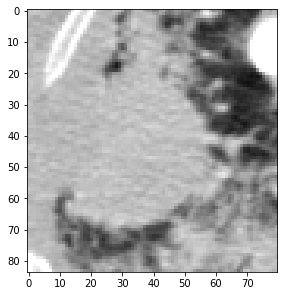

HCRP_LUSC_087_IMG0244.dcm (95, 83)


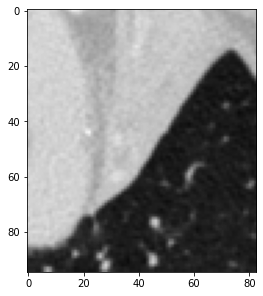

HCRP_LUSC_126_IMG0145.dcm (93, 86)


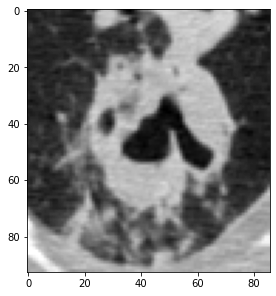

HCRP_LUSC_037_IMG0126.dcm (71, 69)


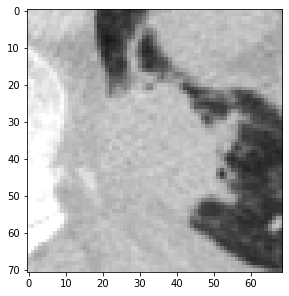

HCRP_LUSC_091_IMG0245.dcm (153, 123)


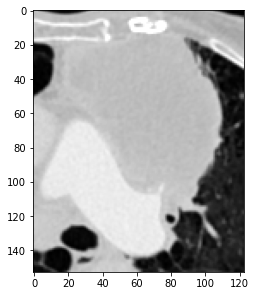

HCRP_LUSC_091_IMG0274.dcm (144, 128)


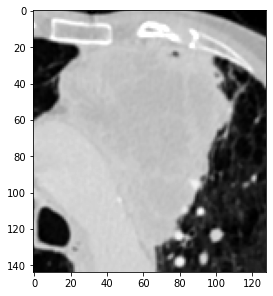

HCRP_LUSC_013_IMG0241.dcm (66, 73)


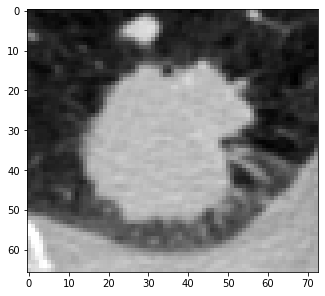

HCRP_LUSC_103_IMG0232.dcm (77, 77)


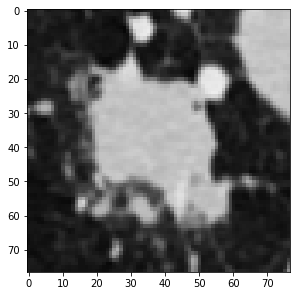

HCRP_LUSC_103_IMG0236.dcm (74, 63)


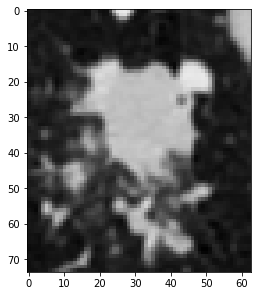

HCRP_LUSC_114_IMG0160.dcm (82, 89)


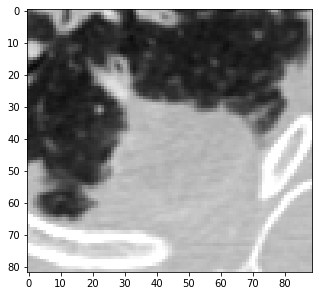

HCRP_LUSC_103_IMG0204.dcm (56, 60)


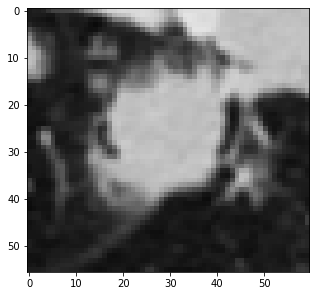

HCRP_LUSC_100_IMG0227.dcm (47, 40)


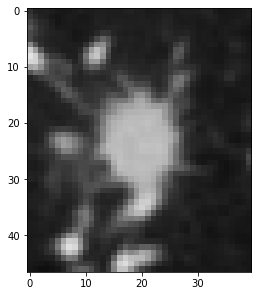

HCRP_LUSC_069_IMG0248.dcm (62, 59)


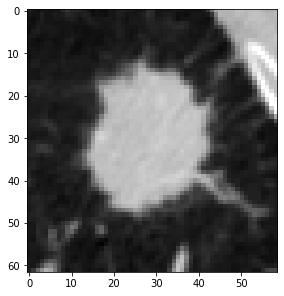

HCRP_LUSC_015_IMG0130.dcm (64, 66)


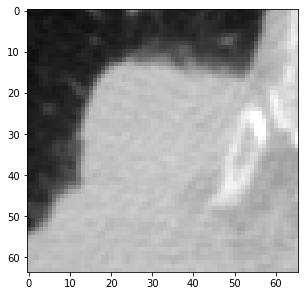

HCRP_LUSC_091_IMG0279.dcm (142, 122)


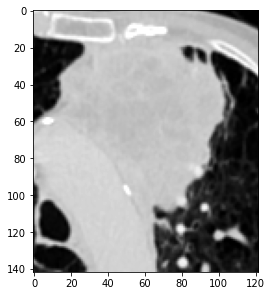

HCRP_LUSC_087_IMG0202.dcm (102, 83)


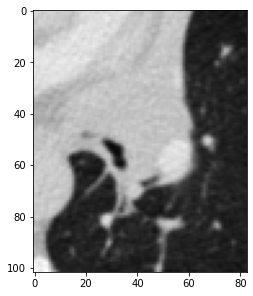

HCRP_LUSC_015_IMG0142.dcm (65, 63)


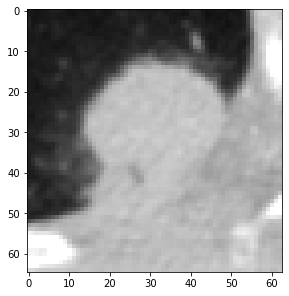

HCRP_LUSC_091_IMG0313.dcm (57, 51)


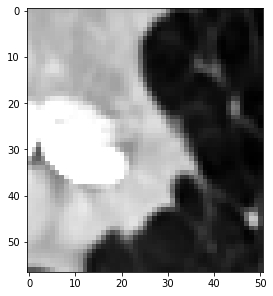

HCRP_LUSC_087_IMG0198.dcm (94, 103)


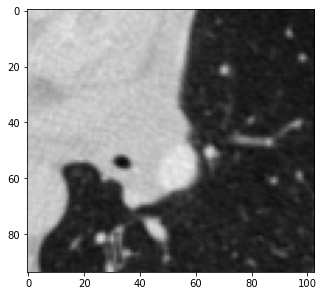

HCRP_LUSC_125_IMG0208.dcm (75, 77)


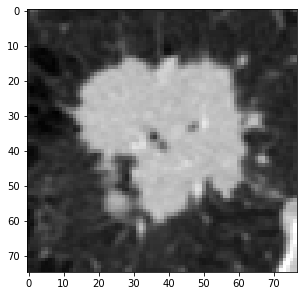

HCRP_LUSC_107_IMG0191.dcm (51, 55)


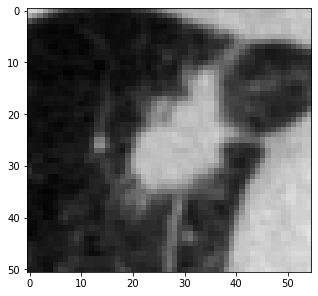

HCRP_LUSC_087_IMG0240.dcm (97, 79)


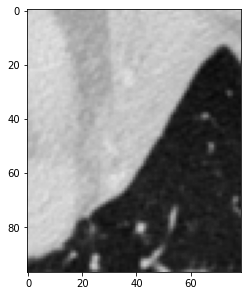

HCRP_LUSC_081_IMG0150.dcm (77, 76)


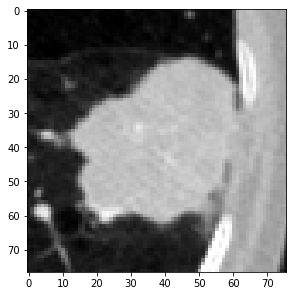

HCRP_LUSC_103_IMG0215.dcm (72, 95)


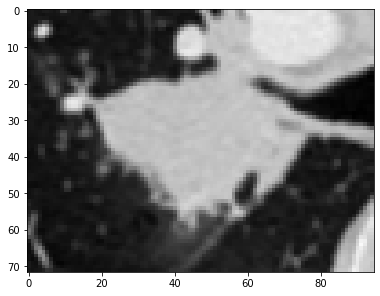

HCRP_LUSC_015_IMG0127.dcm (66, 65)


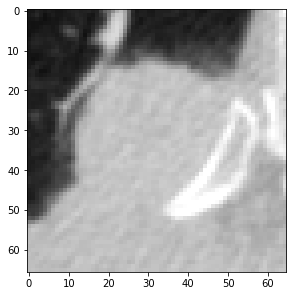

HCRP_LUSC_114_IMG0159.dcm (85, 89)


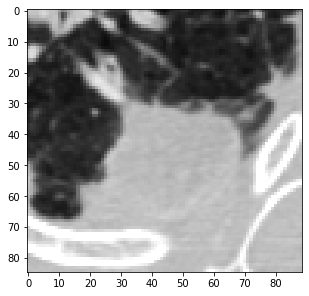

HCRP_LUSC_126_IMG0116.dcm (64, 48)


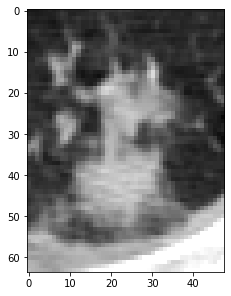

HCRP_LUSC_125_IMG0212.dcm (71, 74)


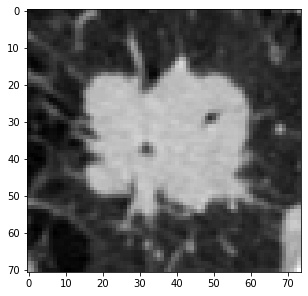

HCRP_LUSC_087_IMG0216.dcm (112, 85)


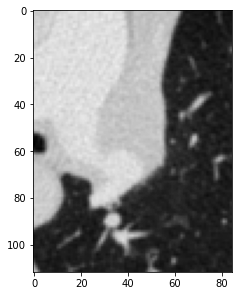

HCRP_LUSC_066_IMG0331.dcm (45, 44)


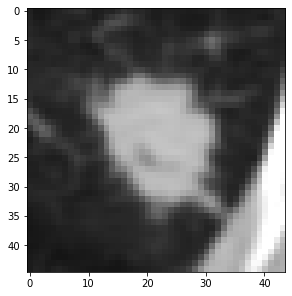

HCRP_LUSC_029_IMG0556.dcm (72, 51)


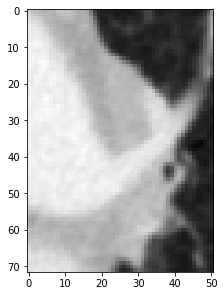

HCRP_LUSC_107_IMG0201.dcm (83, 81)


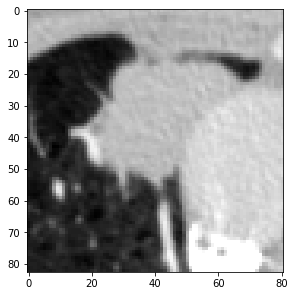

HCRP_LUSC_103_IMG0237.dcm (66, 60)


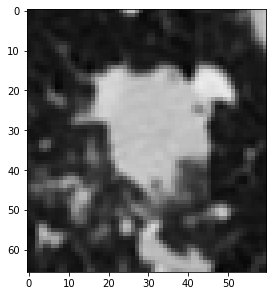

HCRP_LUSC_013_IMG0240.dcm (67, 68)


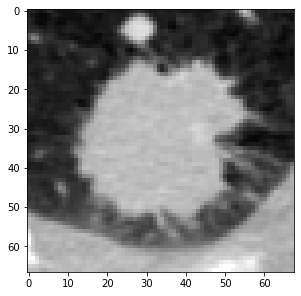

HCRP_LUSC_091_IMG0240.dcm (140, 113)


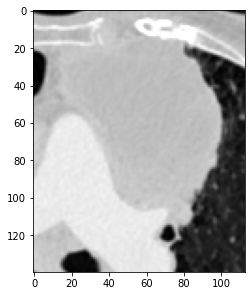

HCRP_LUSC_069_IMG0231.dcm (56, 76)


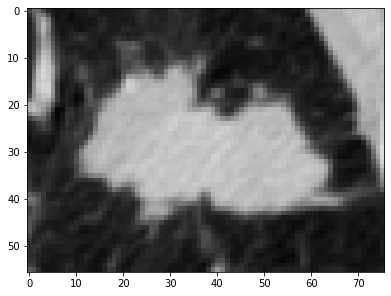

HCRP_LUSC_120_IMG0238.dcm (37, 40)


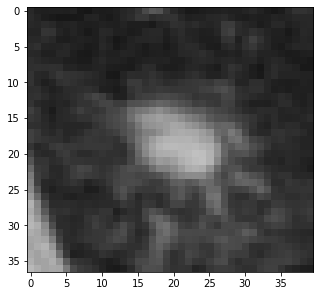

HCRP_LUSC_023_IMG0271.dcm (57, 49)


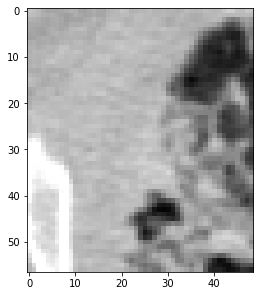

HCRP_LUSC_071_IMG0129.dcm (38, 39)


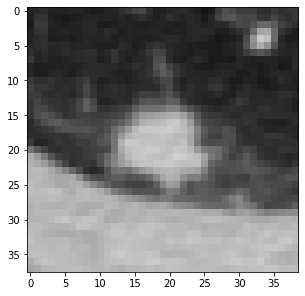

HCRP_LUSC_074_IMG0260.dcm (60, 50)


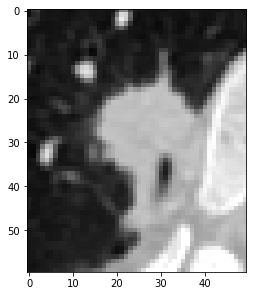

HCRP_LUSC_125_IMG0207.dcm (75, 77)


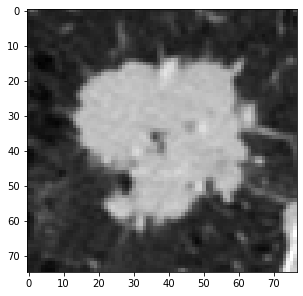

HCRP_LUSC_069_IMG0238.dcm (72, 75)


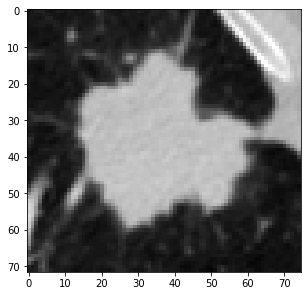

HCRP_LUSC_126_IMG0124.dcm (84, 75)


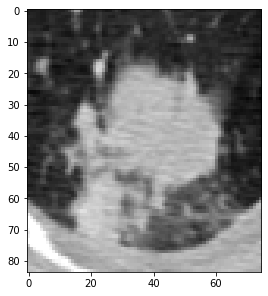

HCRP_LUSC_029_IMG0565.dcm (77, 70)


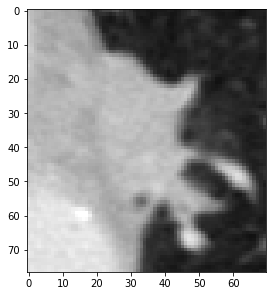

HCRP_LUSC_127_IMG0126.dcm (51, 61)


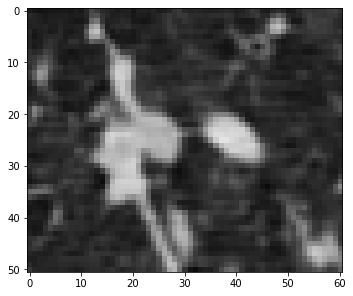

HCRP_LUSC_127_IMG0127.dcm (49, 42)


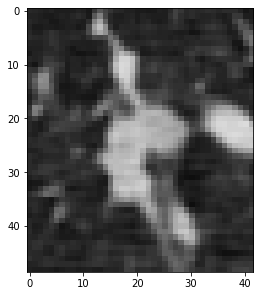

HCRP_LUSC_023_IMG0256.dcm (87, 72)


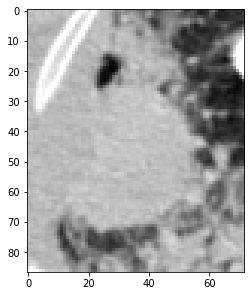

HCRP_LUSC_100_IMG0230.dcm (44, 37)


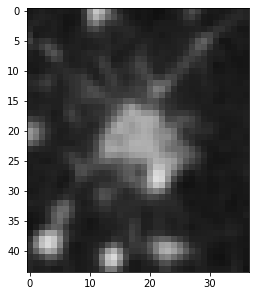

HCRP_LUSC_081_IMG0130.dcm (39, 42)


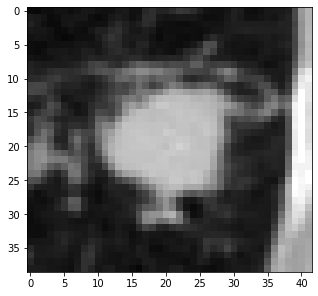

HCRP_LUSC_114_IMG0171.dcm (55, 70)


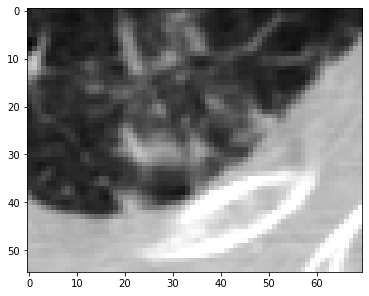

HCRP_LUSC_015_IMG0119.dcm (52, 56)


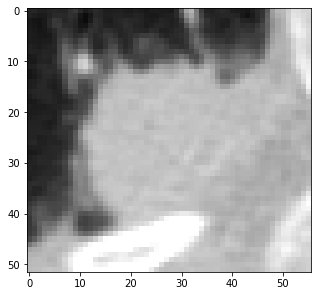

HCRP_LUSC_091_IMG0232.dcm (120, 110)


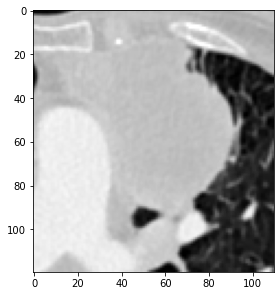

HCRP_LUSC_125_IMG0199.dcm (70, 67)


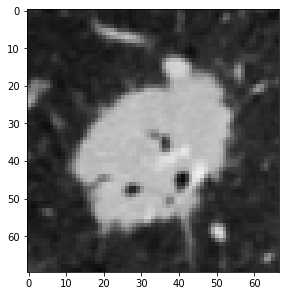

HCRP_LUSC_029_IMG0583.dcm (68, 69)


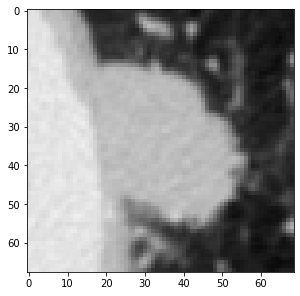

HCRP_LUSC_114_IMG0174.dcm (53, 58)


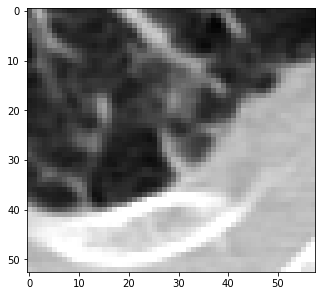

HCRP_LUSC_013_IMG0258.dcm (46, 42)


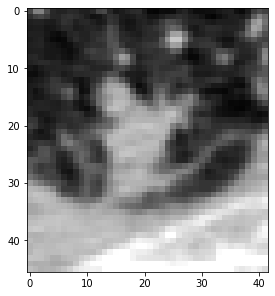

HCRP_LUSC_096_IMG0238.dcm (64, 70)


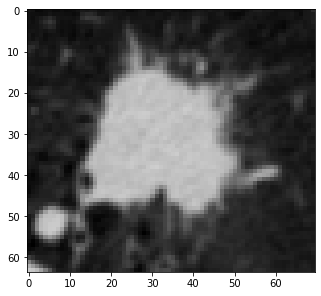

HCRP_LUSC_051_IMG0278.dcm (51, 55)


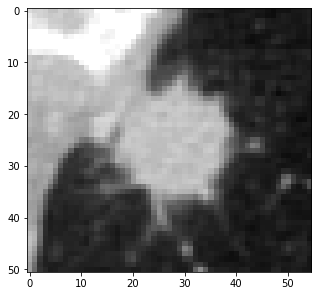

HCRP_LUSC_006_IMG0176.dcm (51, 54)


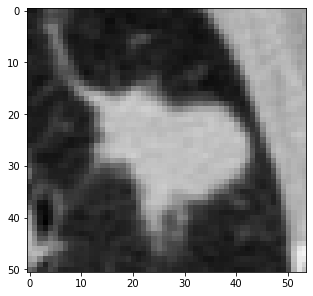

HCRP_LUSC_100_IMG0224.dcm (44, 40)


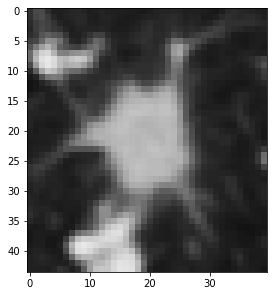

HCRP_LUSC_126_IMG0113.dcm (42, 46)


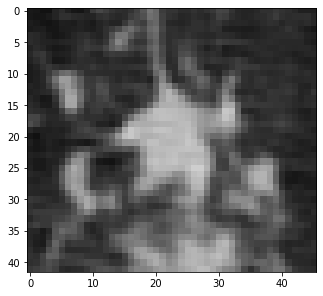

HCRP_LUSC_015_IMG0123.dcm (59, 63)


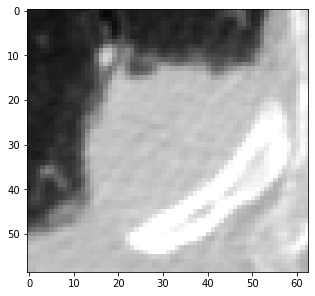

HCRP_LUSC_071_IMG0128.dcm (38, 40)


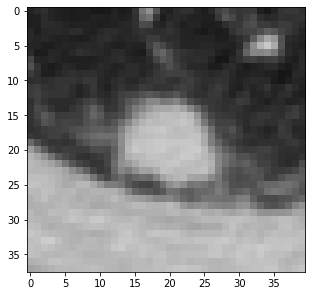

HCRP_LUSC_091_IMG0216.dcm (78, 67)


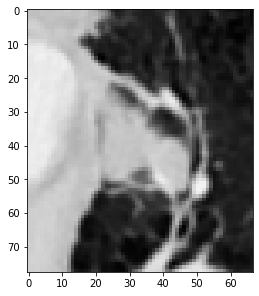

HCRP_LUSC_004_IMG0230.dcm (44, 44)


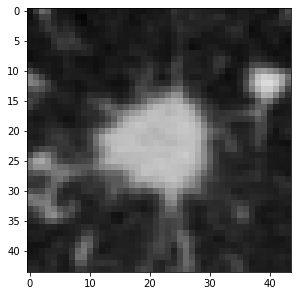

HCRP_LUSC_125_IMG0201.dcm (73, 71)


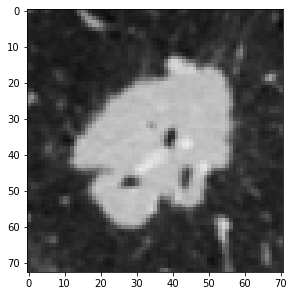

HCRP_LUSC_029_IMG0578.dcm (70, 71)


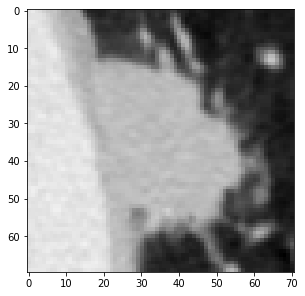

HCRP_LUSC_029_IMG0592.dcm (50, 59)


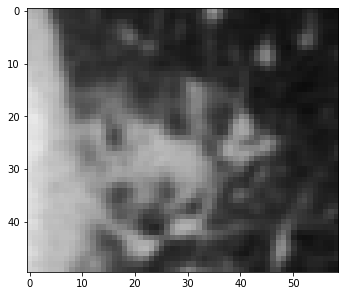

HCRP_LUSC_126_IMG0125.dcm (82, 77)


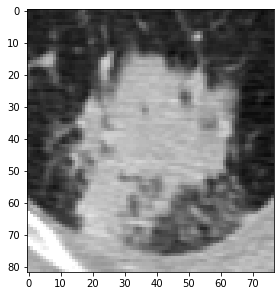

HCRP_LUSC_013_IMG0228.dcm (54, 55)


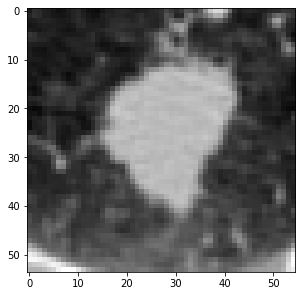

HCRP_LUSC_114_IMG0179.dcm (42, 49)


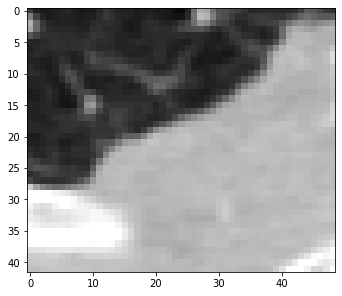

HCRP_LUSC_103_IMG0213.dcm (70, 89)


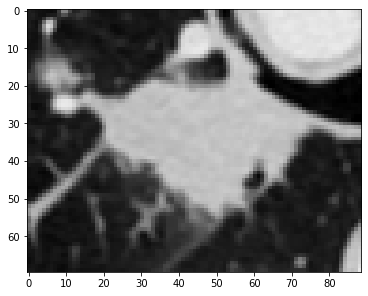

HCRP_LUSC_029_IMG0559.dcm (77, 58)


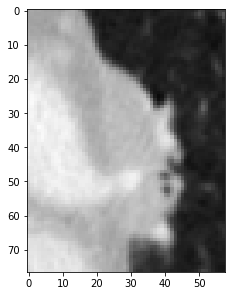

HCRP_LUSC_029_IMG0573.dcm (76, 68)


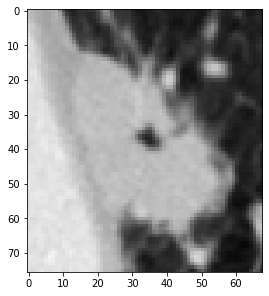

HCRP_LUSC_107_IMG0192.dcm (76, 54)


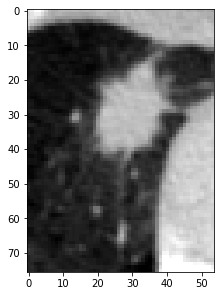

HCRP_LUSC_091_IMG0285.dcm (135, 110)


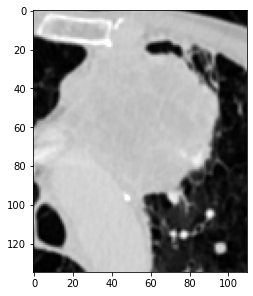

HCRP_LUSC_023_IMG0241.dcm (91, 95)


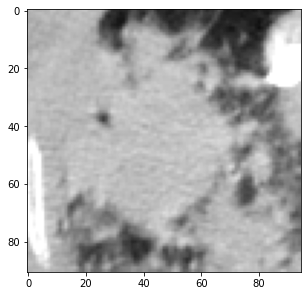

HCRP_LUSC_035_IMG0213.dcm (53, 49)


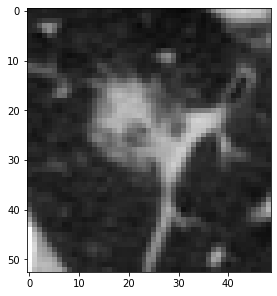

HCRP_LUSC_037_IMG0129.dcm (63, 62)


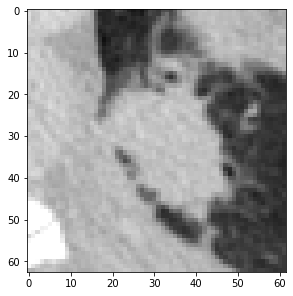

HCRP_LUSC_091_IMG0312.dcm (58, 52)


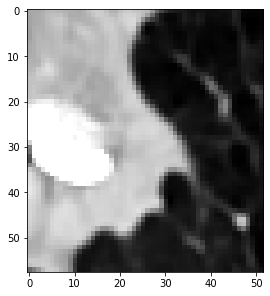

HCRP_LUSC_074_IMG0270.dcm (47, 44)


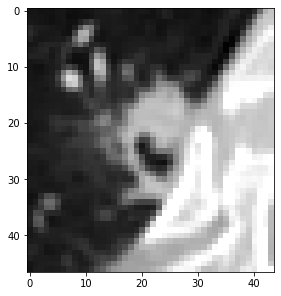

HCRP_LUSC_087_IMG0195.dcm (91, 91)


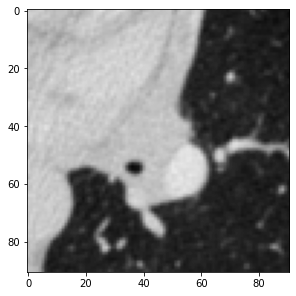

HCRP_LUSC_127_IMG0114.dcm (90, 78)


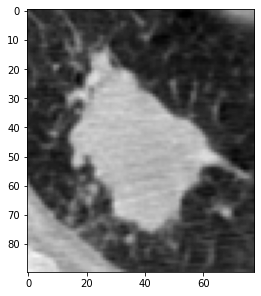

HCRP_LUSC_023_IMG0249.dcm (89, 80)


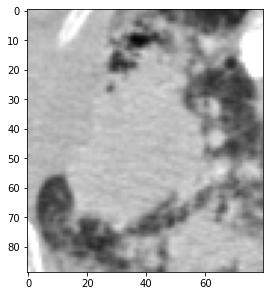

HCRP_LUSC_081_IMG0138.dcm (64, 70)


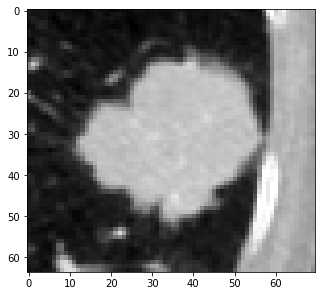

HCRP_LUSC_126_IMG0136.dcm (100, 96)


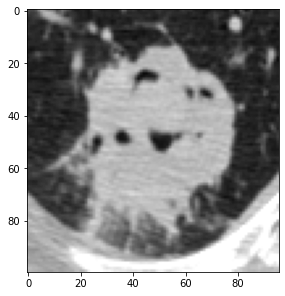

HCRP_LUSC_059_IMG0169.dcm (51, 76)


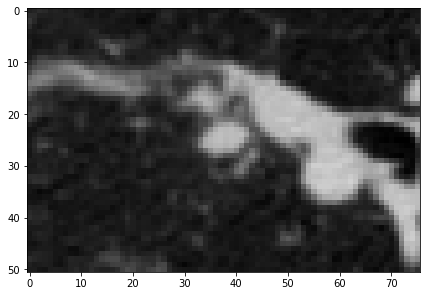

HCRP_LUSC_089_IMG0187.dcm (64, 59)


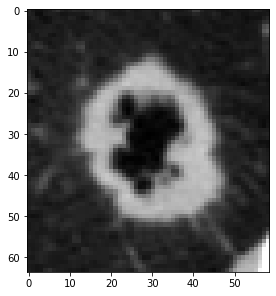

HCRP_LUSC_023_IMG0259.dcm (74, 70)


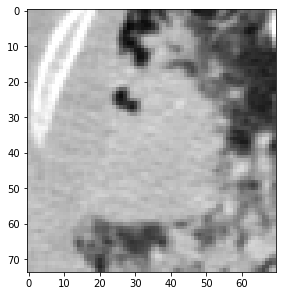

HCRP_LUSC_091_IMG0288.dcm (133, 105)


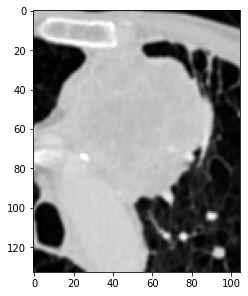

HCRP_LUSC_125_IMG0205.dcm (74, 80)


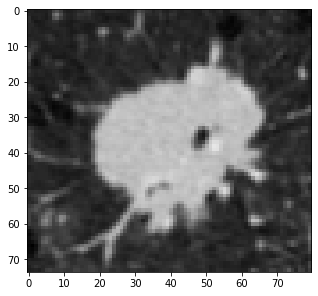

HCRP_LUSC_004_IMG0227.dcm (50, 44)


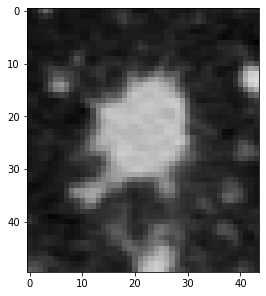

HCRP_LUSC_023_IMG0250.dcm (87, 79)


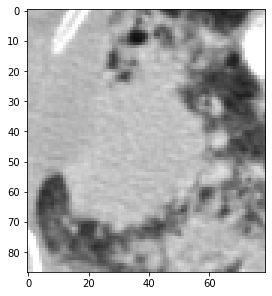

HCRP_LUSC_091_IMG0311.dcm (76, 51)


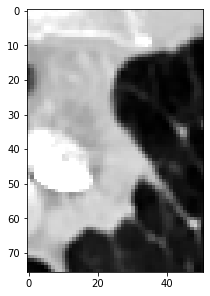

HCRP_LUSC_125_IMG0203.dcm (73, 72)


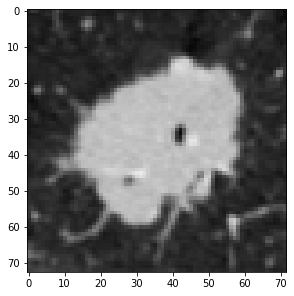

HCRP_LUSC_126_IMG0144.dcm (95, 84)


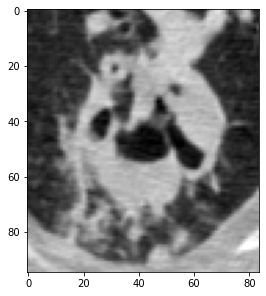

HCRP_LUSC_023_IMG0262.dcm (74, 64)


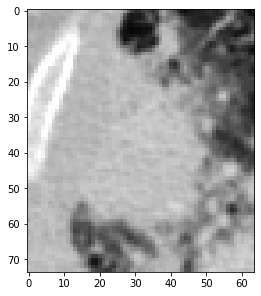

HCRP_LUSC_114_IMG0149.dcm (43, 40)


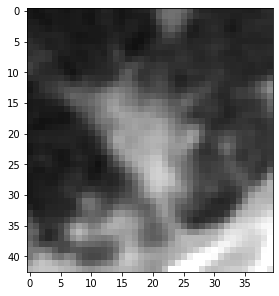

HCRP_LUSC_013_IMG0257.dcm (47, 44)


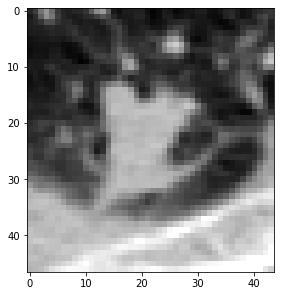

HCRP_LUSC_125_IMG0192.dcm (50, 57)


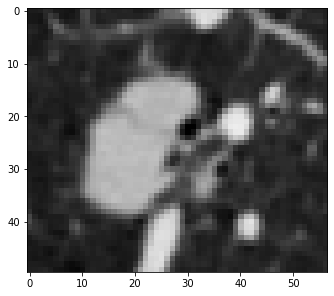

HCRP_LUSC_066_IMG0332.dcm (46, 45)


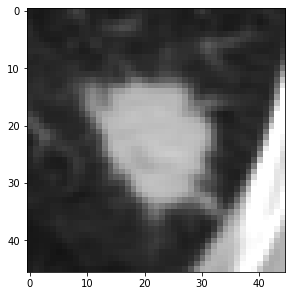

HCRP_LUSC_023_IMG0235.dcm (78, 91)


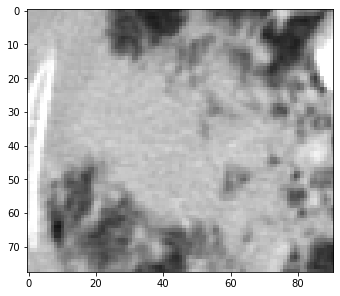

HCRP_LUSC_103_IMG0228.dcm (80, 76)


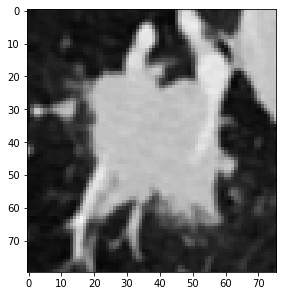

HCRP_LUSC_091_IMG0270.dcm (147, 128)


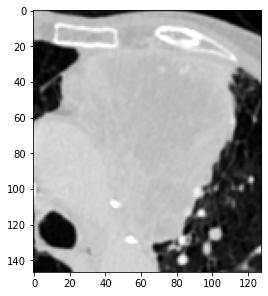

HCRP_LUSC_029_IMG0590.dcm (57, 62)


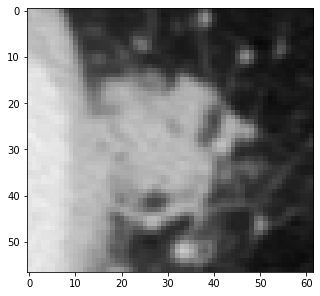

HCRP_LUSC_004_IMG0232.dcm (43, 45)


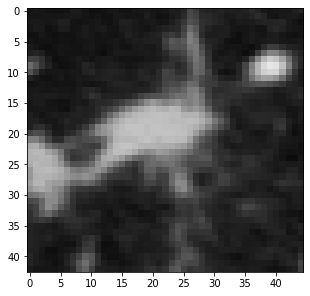

HCRP_LUSC_023_IMG0226.dcm (44, 48)


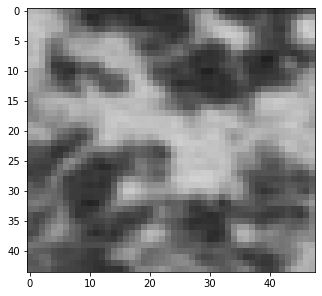

HCRP_LUSC_125_IMG0218.dcm (66, 68)


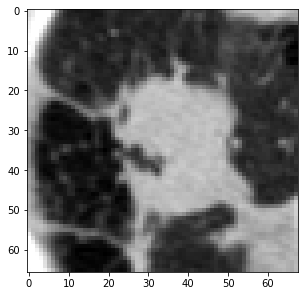

HCRP_LUSC_127_IMG0110.dcm (92, 81)


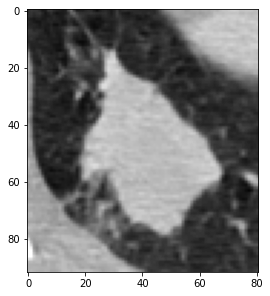

HCRP_LUSC_103_IMG0229.dcm (85, 76)


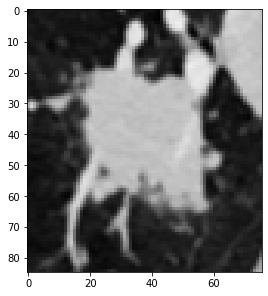

HCRP_LUSC_091_IMG0238.dcm (139, 114)


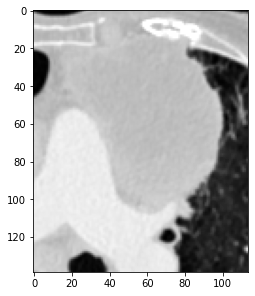

HCRP_LUSC_029_IMG0588.dcm (68, 64)


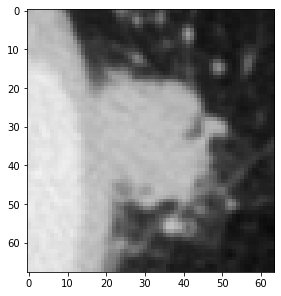

HCRP_LUSC_087_IMG0243.dcm (95, 81)


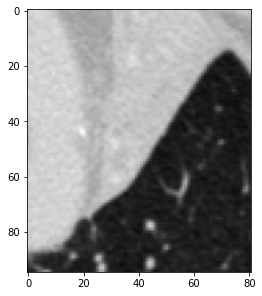

HCRP_LUSC_114_IMG0176.dcm (44, 48)


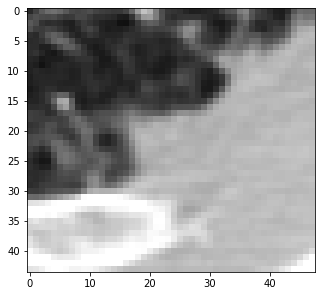

HCRP_LUSC_103_IMG0239.dcm (57, 60)


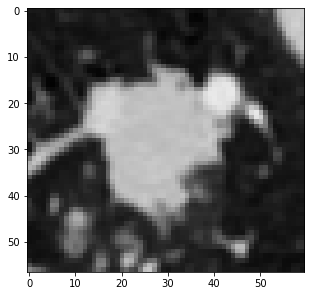

HCRP_LUSC_127_IMG0105.dcm (111, 87)


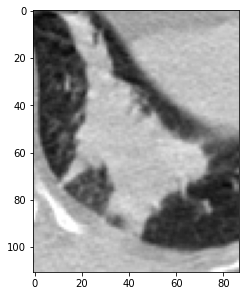

HCRP_LUSC_018_IMG0265.dcm (51, 44)


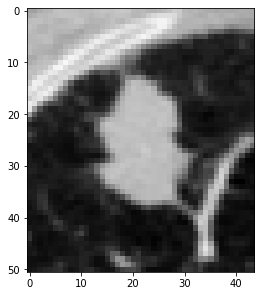

HCRP_LUSC_015_IMG0128.dcm (62, 65)


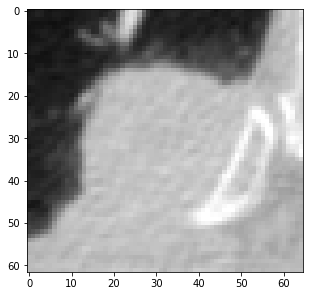

HCRP_LUSC_035_IMG0193.dcm (50, 53)


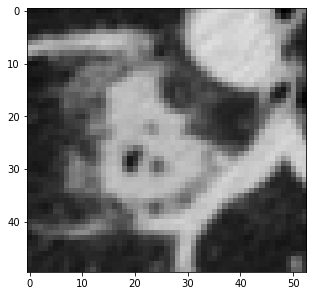

HCRP_LUSC_114_IMG0150.dcm (55, 67)


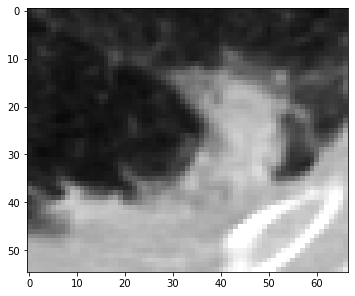

HCRP_LUSC_069_IMG0233.dcm (59, 78)


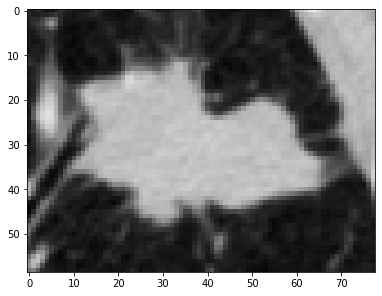

HCRP_LUSC_127_IMG0111.dcm (91, 77)


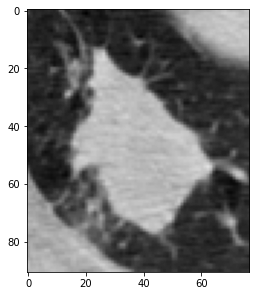

HCRP_LUSC_069_IMG0232.dcm (59, 78)


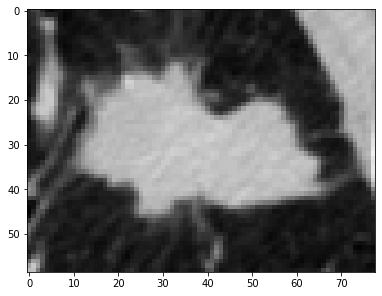

HCRP_LUSC_087_IMG0199.dcm (103, 81)


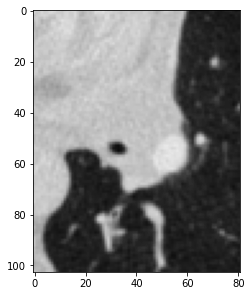

HCRP_LUSC_114_IMG0153.dcm (63, 78)


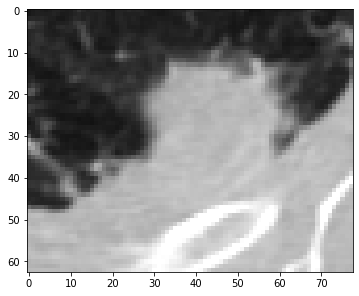

HCRP_LUSC_125_IMG0206.dcm (79, 74)


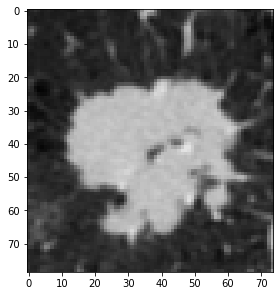

HCRP_LUSC_091_IMG0254.dcm (148, 134)


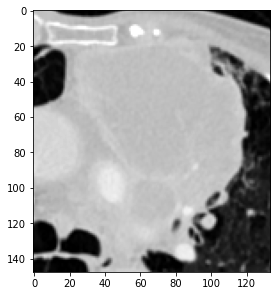

HCRP_LUSC_029_IMG0555.dcm (52, 45)


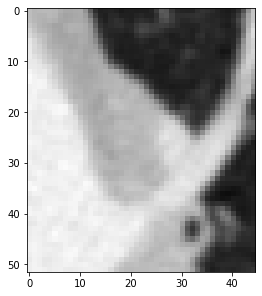

HCRP_LUSC_023_IMG0258.dcm (75, 71)


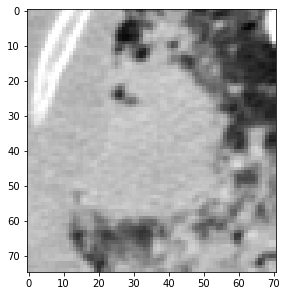

HCRP_LUSC_013_IMG0227.dcm (51, 55)


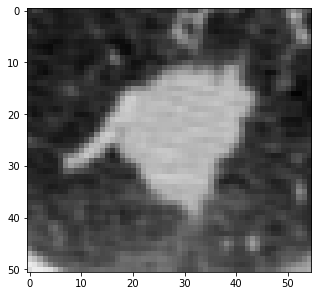

HCRP_LUSC_029_IMG0586.dcm (68, 69)


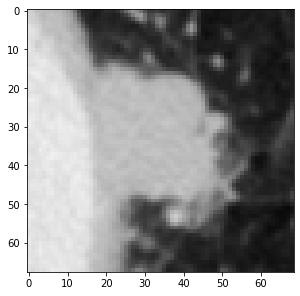

HCRP_LUSC_125_IMG0219.dcm (68, 65)


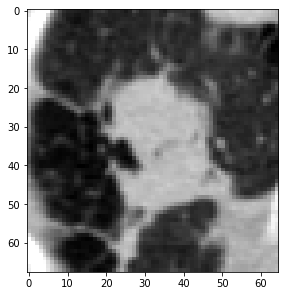

HCRP_LUSC_114_IMG0161.dcm (80, 93)


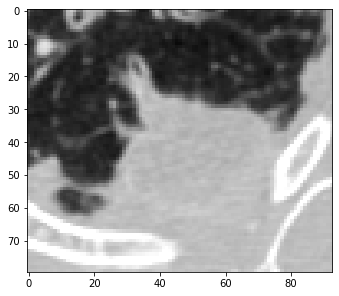

HCRP_LUSC_091_IMG0246.dcm (153, 127)


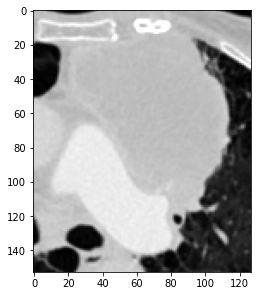

HCRP_LUSC_029_IMG0561.dcm (80, 60)


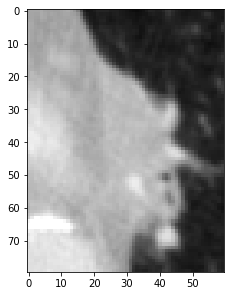

HCRP_LUSC_029_IMG0567.dcm (74, 68)


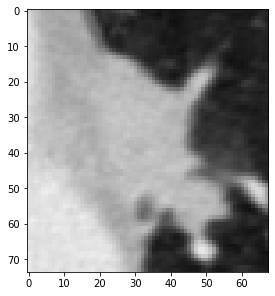

HCRP_LUSC_023_IMG0238.dcm (90, 102)


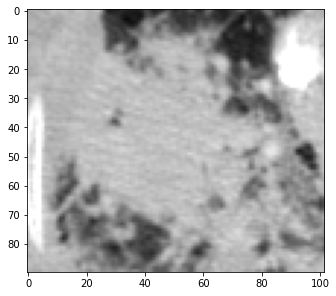

HCRP_LUSC_096_IMG0249.dcm (46, 51)


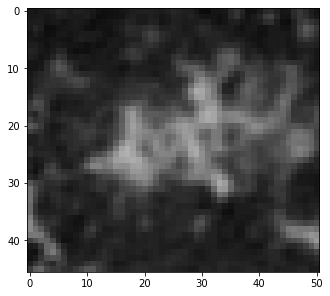

HCRP_LUSC_087_IMG0239.dcm (99, 80)


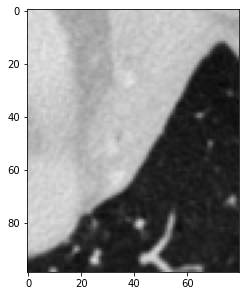

HCRP_LUSC_015_IMG0141.dcm (64, 66)


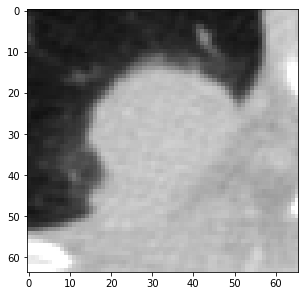

HCRP_LUSC_018_IMG0268.dcm (49, 42)


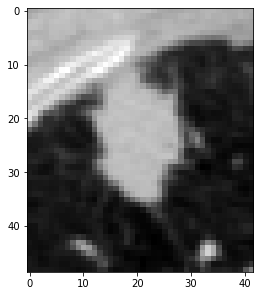

HCRP_LUSC_114_IMG0165.dcm (73, 96)


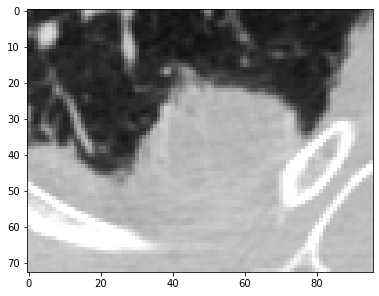

HCRP_LUSC_004_IMG0224.dcm (44, 52)


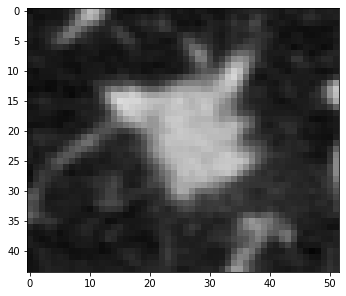

HCRP_LUSC_091_IMG0307.dcm (86, 67)


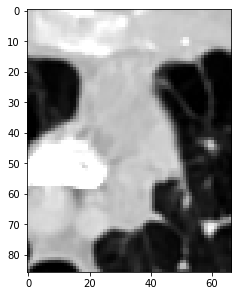

HCRP_LUSC_091_IMG0217.dcm (92, 68)


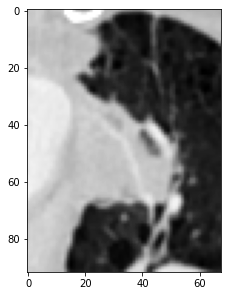

HCRP_LUSC_127_IMG0103.dcm (108, 87)


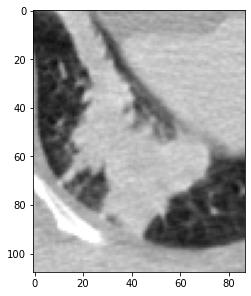

HCRP_LUSC_087_IMG0221.dcm (132, 75)


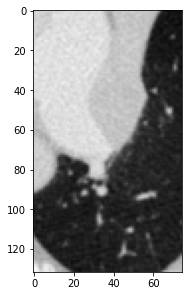

HCRP_LUSC_091_IMG0258.dcm (138, 145)


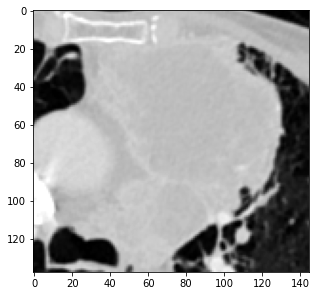

HCRP_LUSC_015_IMG0145.dcm (53, 55)


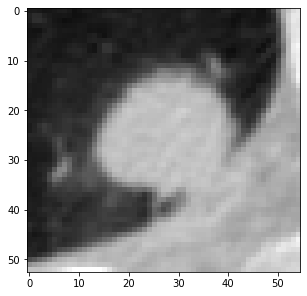

HCRP_LUSC_103_IMG0224.dcm (74, 80)


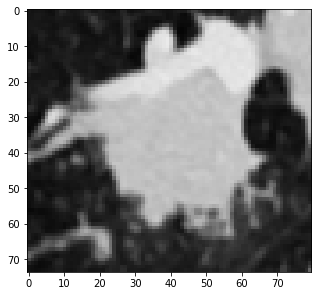

HCRP_LUSC_051_IMG0273.dcm (50, 55)


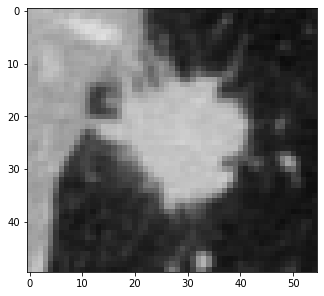

HCRP_LUSC_029_IMG0589.dcm (58, 65)


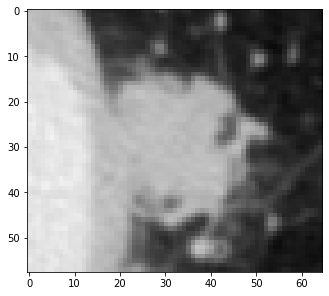

HCRP_LUSC_059_IMG0158.dcm (68, 68)


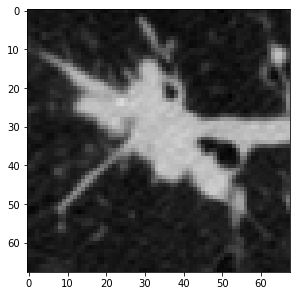

HCRP_LUSC_091_IMG0299.dcm (105, 92)


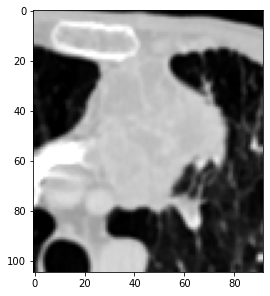

HCRP_LUSC_107_IMG0193.dcm (62, 56)


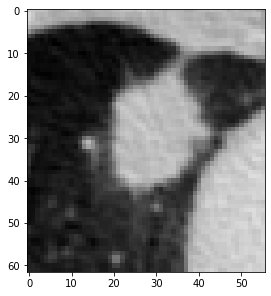

HCRP_LUSC_074_IMG0258.dcm (51, 49)


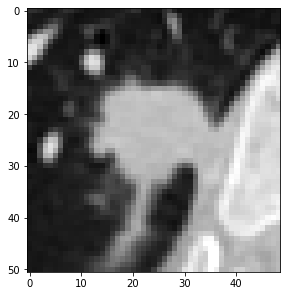

HCRP_LUSC_125_IMG0197.dcm (60, 64)


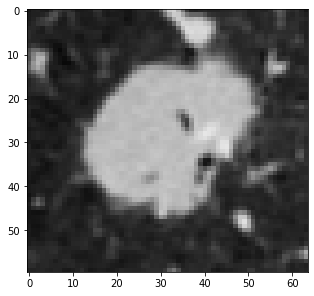

HCRP_LUSC_107_IMG0205.dcm (69, 75)


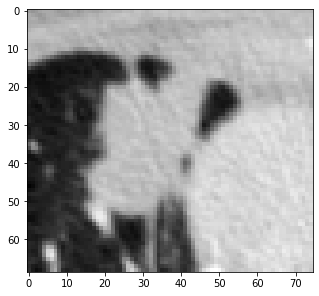

HCRP_LUSC_091_IMG0286.dcm (132, 109)


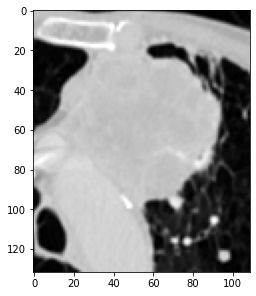

HCRP_LUSC_074_IMG0259.dcm (49, 50)


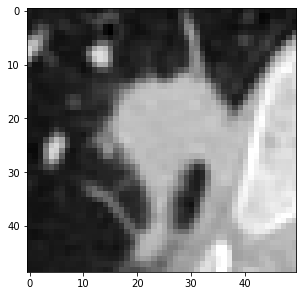

HCRP_LUSC_006_IMG0195.dcm (57, 51)


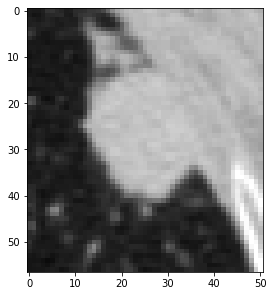

HCRP_LUSC_035_IMG0199.dcm (54, 61)


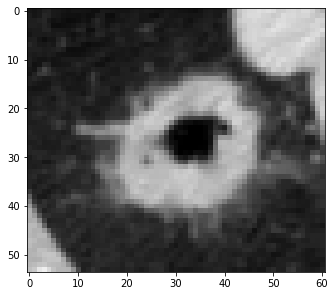

HCRP_LUSC_013_IMG0244.dcm (67, 69)


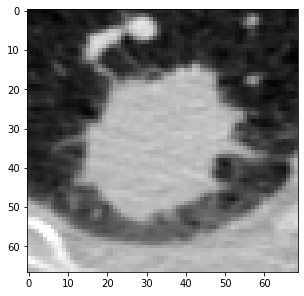

HCRP_LUSC_066_IMG0336.dcm (45, 44)


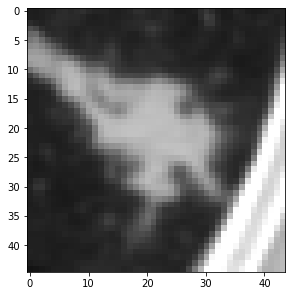

HCRP_LUSC_004_IMG0225.dcm (44, 51)


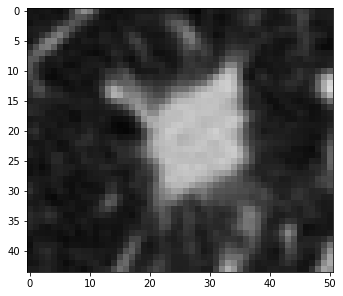

HCRP_LUSC_091_IMG0223.dcm (107, 75)


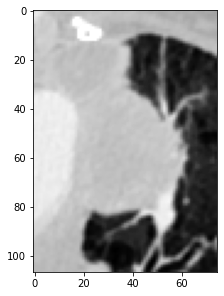

HCRP_LUSC_127_IMG0087.dcm (57, 56)


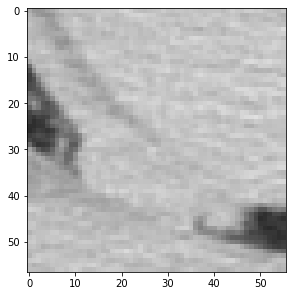

HCRP_LUSC_087_IMG0209.dcm (99, 83)


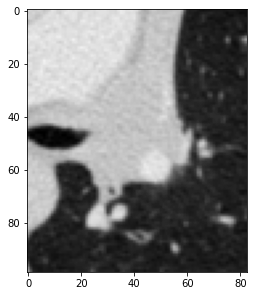

HCRP_LUSC_089_IMG0196.dcm (41, 44)


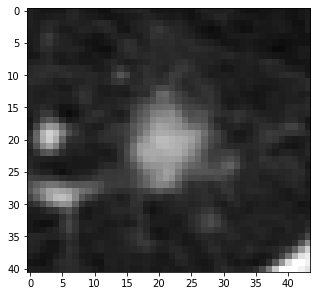

HCRP_LUSC_089_IMG0181.dcm (53, 51)


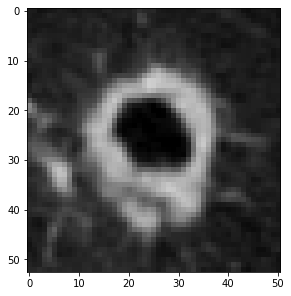

HCRP_LUSC_103_IMG0206.dcm (56, 66)


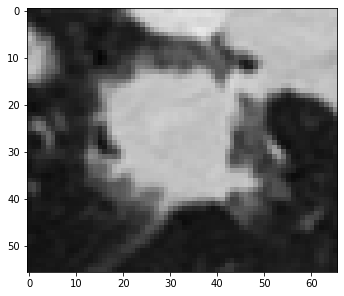

HCRP_LUSC_114_IMG0152.dcm (61, 77)


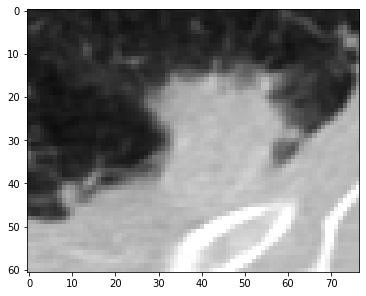

HCRP_LUSC_006_IMG0190.dcm (57, 63)


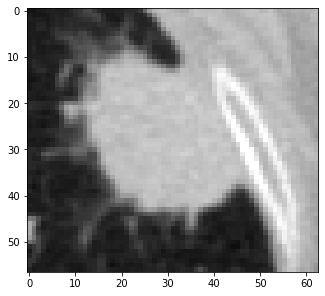

HCRP_LUSC_069_IMG0244.dcm (67, 65)


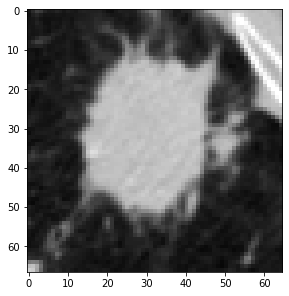

HCRP_LUSC_096_IMG0248.dcm (52, 58)


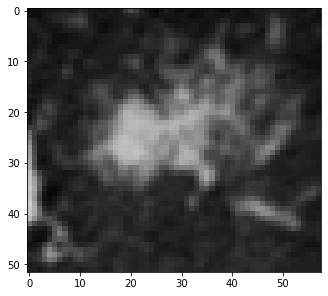

HCRP_LUSC_091_IMG0292.dcm (135, 105)


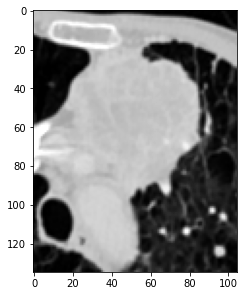

HCRP_LUSC_029_IMG0579.dcm (69, 71)


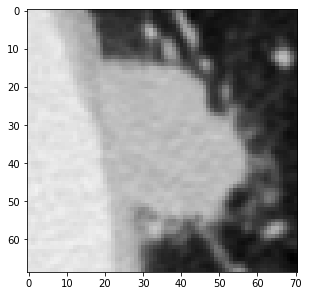

HCRP_LUSC_127_IMG0098.dcm (70, 83)


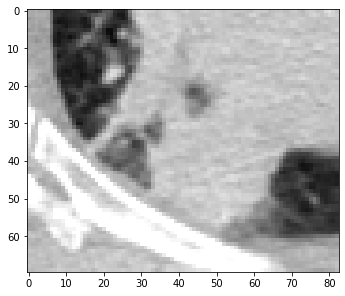

HCRP_LUSC_051_IMG0275.dcm (50, 54)


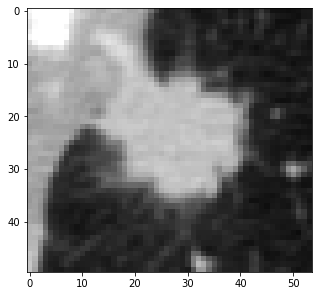

HCRP_LUSC_100_IMG0229.dcm (47, 39)


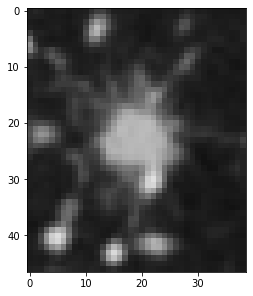

HCRP_LUSC_091_IMG0229.dcm (117, 108)


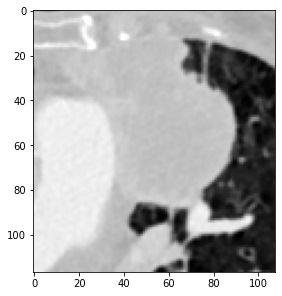

HCRP_LUSC_107_IMG0202.dcm (72, 81)


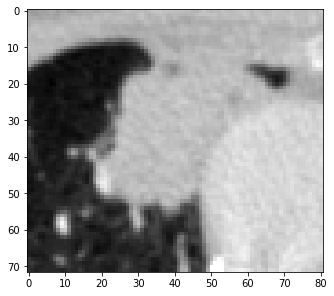

HCRP_LUSC_127_IMG0089.dcm (56, 58)


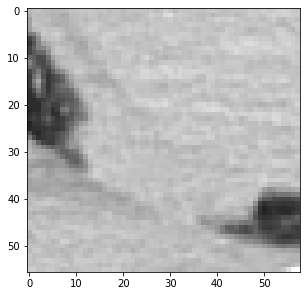

HCRP_LUSC_096_IMG0239.dcm (64, 74)


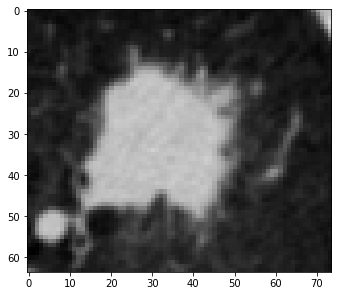

HCRP_LUSC_126_IMG0147.dcm (90, 74)


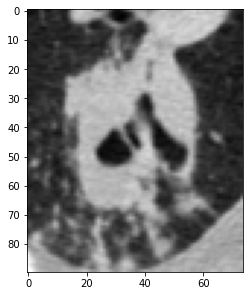

HCRP_LUSC_004_IMG0229.dcm (45, 44)


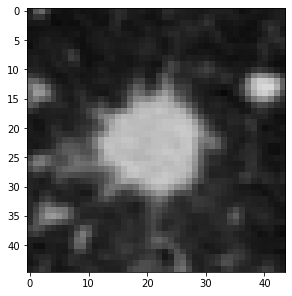

HCRP_LUSC_013_IMG0255.dcm (53, 55)


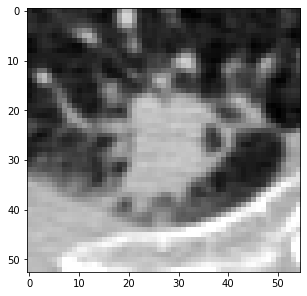

HCRP_LUSC_089_IMG0186.dcm (63, 59)


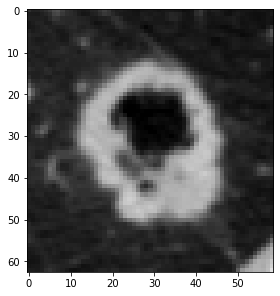

HCRP_LUSC_013_IMG0249.dcm (62, 64)


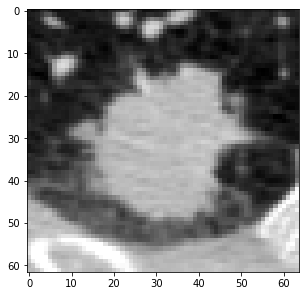

HCRP_LUSC_091_IMG0237.dcm (138, 112)


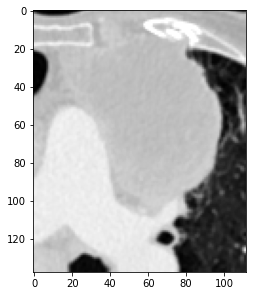

HCRP_LUSC_069_IMG0253.dcm (43, 54)


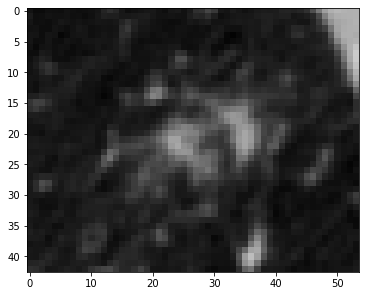

HCRP_LUSC_023_IMG0272.dcm (55, 51)


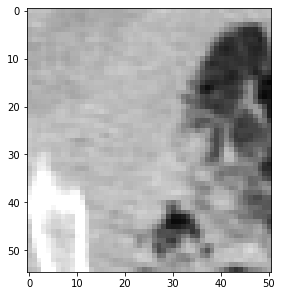

HCRP_LUSC_069_IMG0234.dcm (62, 82)


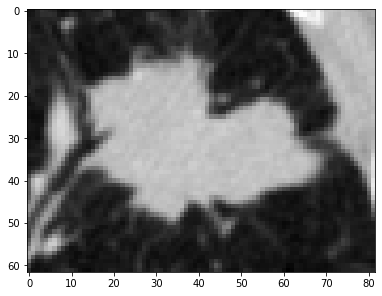

HCRP_LUSC_081_IMG0139.dcm (65, 70)


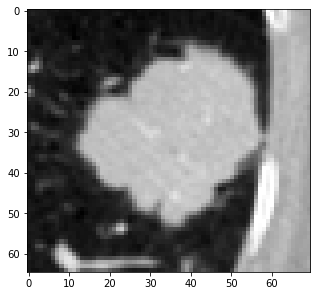

HCRP_LUSC_125_IMG0193.dcm (69, 58)


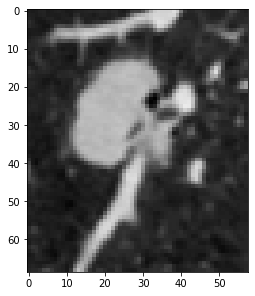

HCRP_LUSC_089_IMG0195.dcm (49, 46)


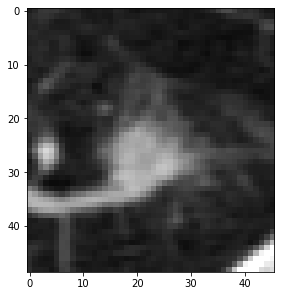

HCRP_LUSC_023_IMG0260.dcm (75, 68)


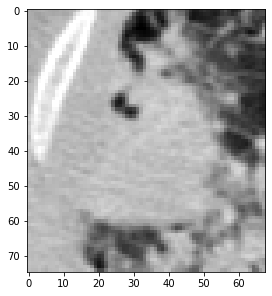

HCRP_LUSC_125_IMG0213.dcm (69, 70)


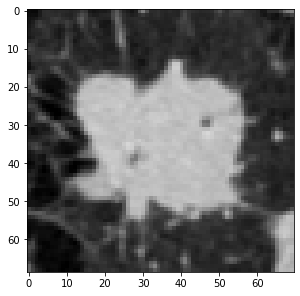

HCRP_LUSC_013_IMG0236.dcm (64, 65)


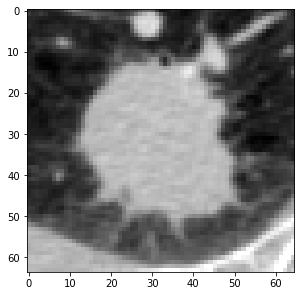

HCRP_LUSC_096_IMG0229.dcm (65, 68)


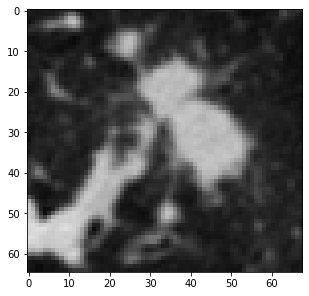

HCRP_LUSC_091_IMG0277.dcm (144, 123)


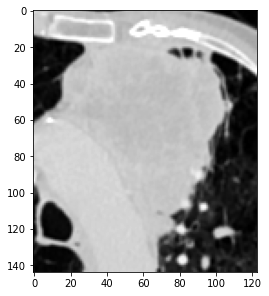

HCRP_LUSC_013_IMG0253.dcm (59, 58)


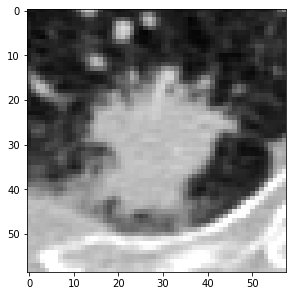

HCRP_LUSC_125_IMG0211.dcm (71, 74)


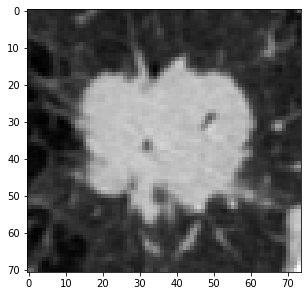

HCRP_LUSC_127_IMG0107.dcm (110, 87)


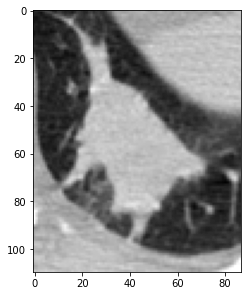

HCRP_LUSC_004_IMG0226.dcm (47, 42)


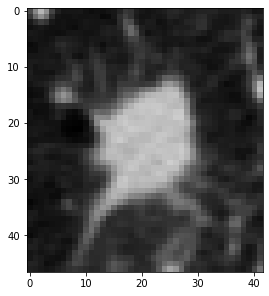

HCRP_LUSC_089_IMG0193.dcm (54, 57)


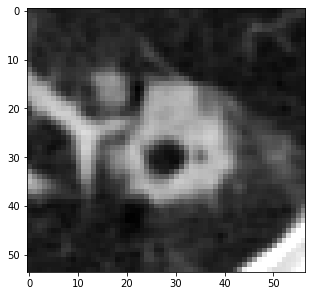

HCRP_LUSC_114_IMG0180.dcm (40, 49)


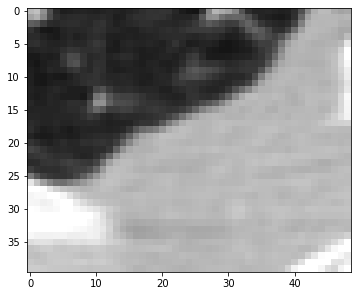

HCRP_LUSC_091_IMG0250.dcm (152, 136)


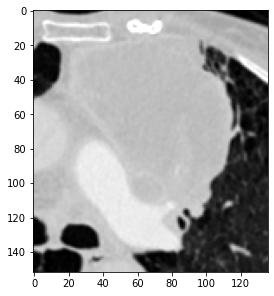

HCRP_LUSC_125_IMG0221.dcm (65, 56)


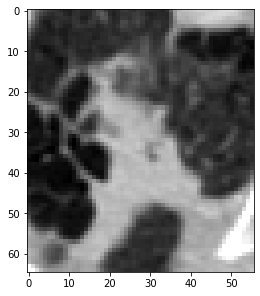

HCRP_LUSC_114_IMG0154.dcm (67, 79)


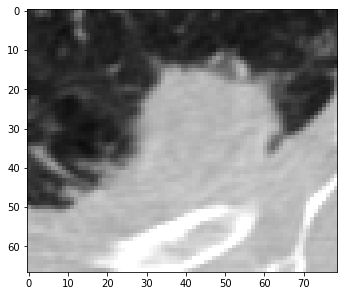

HCRP_LUSC_103_IMG0233.dcm (74, 74)


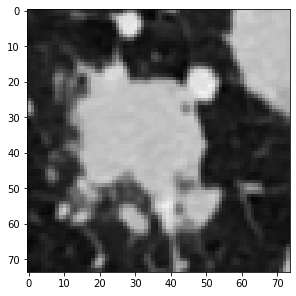

HCRP_LUSC_091_IMG0244.dcm (153, 126)


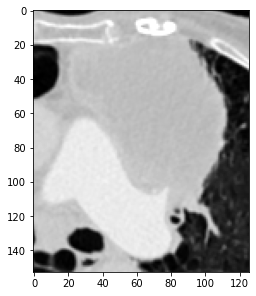

HCRP_LUSC_091_IMG0259.dcm (139, 140)


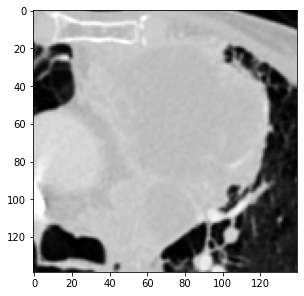

HCRP_LUSC_066_IMG0335.dcm (47, 45)


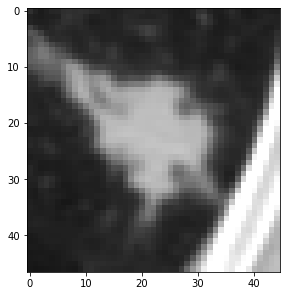

HCRP_LUSC_087_IMG0236.dcm (96, 78)


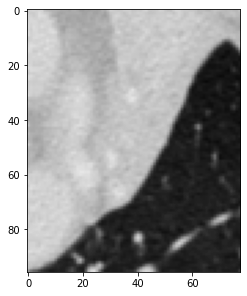

HCRP_LUSC_091_IMG0220.dcm (98, 71)


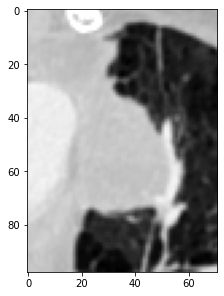

HCRP_LUSC_091_IMG0266.dcm (141, 141)


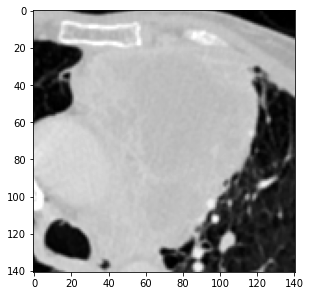

HCRP_LUSC_087_IMG0206.dcm (93, 80)


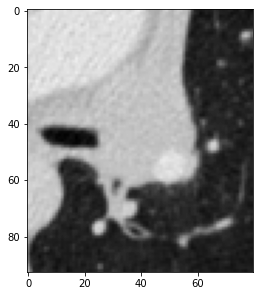

HCRP_LUSC_091_IMG0303.dcm (98, 89)


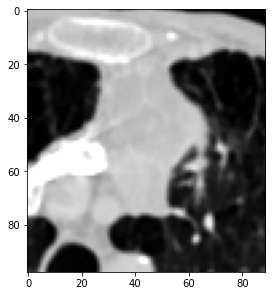

HCRP_LUSC_087_IMG0219.dcm (127, 73)


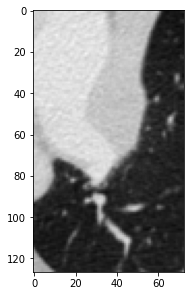

HCRP_LUSC_126_IMG0154.dcm (78, 58)


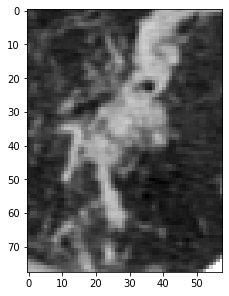

HCRP_LUSC_035_IMG0190.dcm (42, 43)


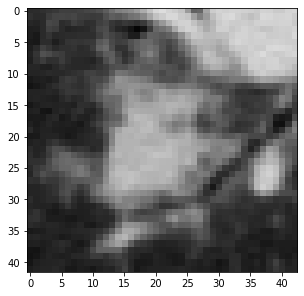

HCRP_LUSC_029_IMG0564.dcm (77, 69)


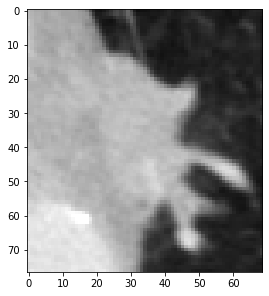

HCRP_LUSC_087_IMG0229.dcm (110, 70)


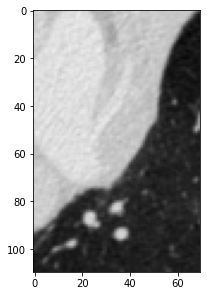

HCRP_LUSC_013_IMG0243.dcm (66, 69)


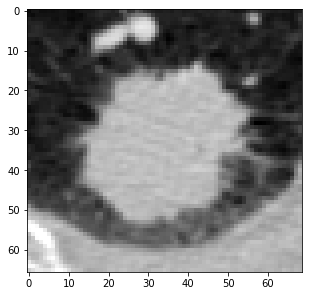

HCRP_LUSC_127_IMG0124.dcm (57, 74)


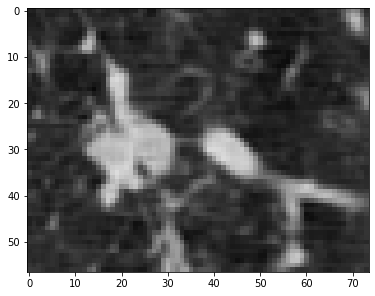

HCRP_LUSC_028_IMG0182.dcm (44, 43)


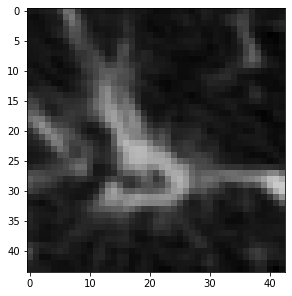

HCRP_LUSC_127_IMG0090.dcm (54, 60)


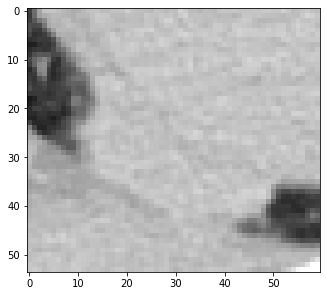

HCRP_LUSC_069_IMG0251.dcm (54, 54)


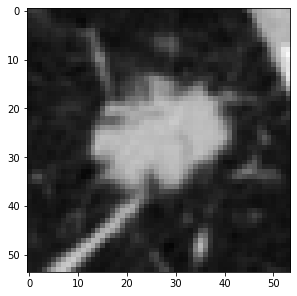

HCRP_LUSC_023_IMG0227.dcm (46, 51)


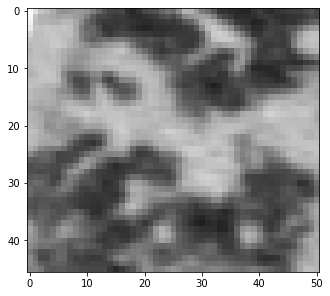

HCRP_LUSC_015_IMG0143.dcm (60, 61)


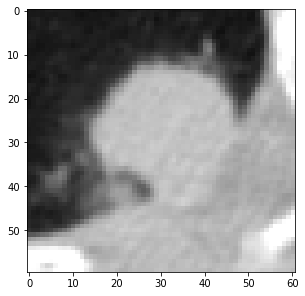

HCRP_LUSC_013_IMG0251.dcm (61, 60)


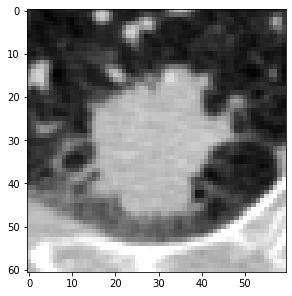

HCRP_LUSC_107_IMG0199.dcm (70, 72)


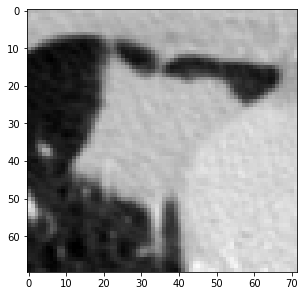

HCRP_LUSC_035_IMG0200.dcm (53, 61)


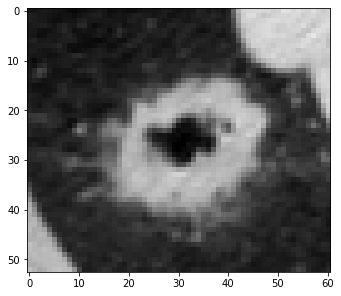

HCRP_LUSC_125_IMG0214.dcm (68, 72)


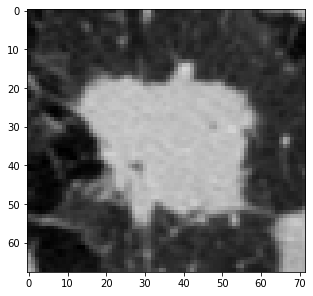

HCRP_LUSC_081_IMG0132.dcm (46, 47)


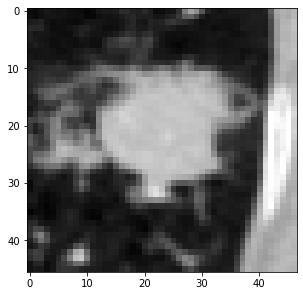

HCRP_LUSC_013_IMG0226.dcm (49, 54)


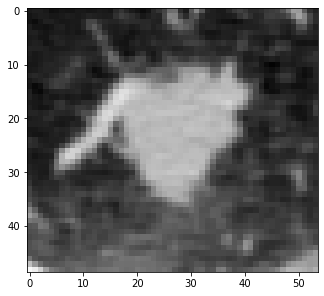

HCRP_LUSC_066_IMG0334.dcm (46, 45)


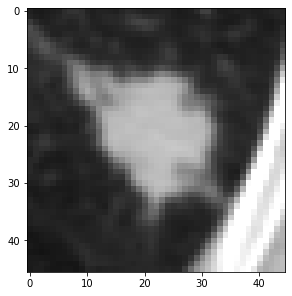

HCRP_LUSC_091_IMG0260.dcm (141, 145)


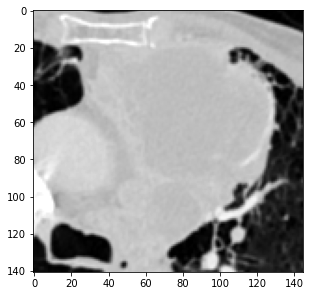

HCRP_LUSC_023_IMG0246.dcm (88, 82)


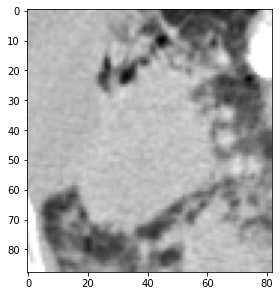

HCRP_LUSC_023_IMG0248.dcm (88, 81)


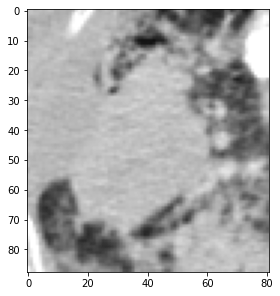

HCRP_LUSC_103_IMG0209.dcm (62, 87)


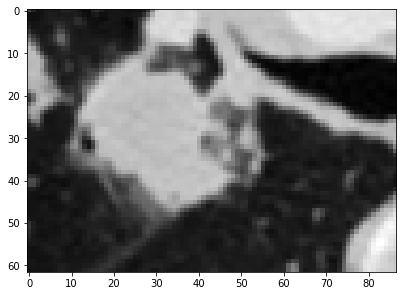

HCRP_LUSC_035_IMG0203.dcm (54, 62)


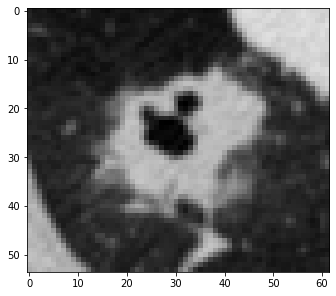

HCRP_LUSC_015_IMG0131.dcm (64, 67)


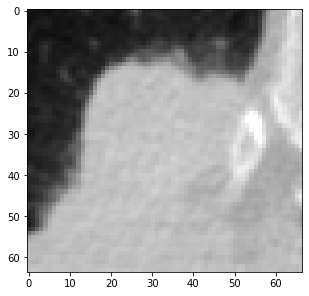

HCRP_LUSC_126_IMG0114.dcm (44, 51)


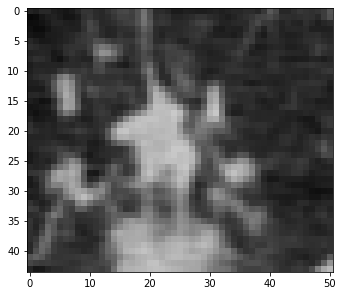

HCRP_LUSC_071_IMG0125.dcm (47, 47)


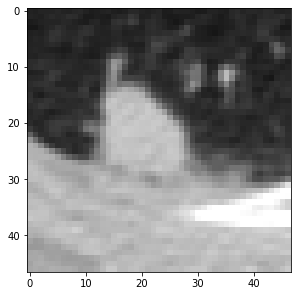

HCRP_LUSC_013_IMG0242.dcm (66, 69)


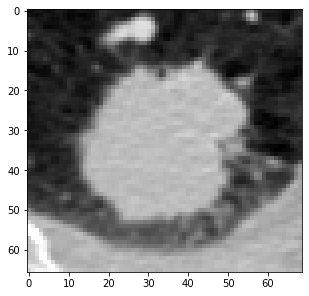

HCRP_LUSC_087_IMG0189.dcm (82, 83)


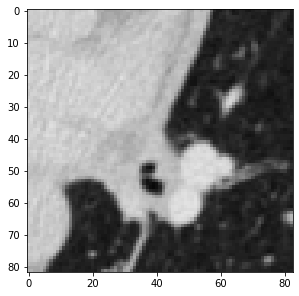

HCRP_LUSC_081_IMG0169.dcm (51, 48)


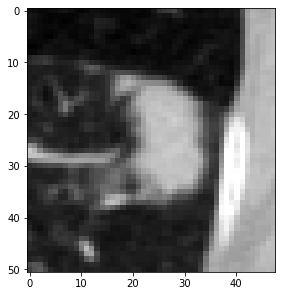

HCRP_LUSC_069_IMG0250.dcm (58, 55)


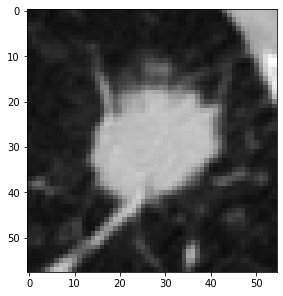

HCRP_LUSC_013_IMG0256.dcm (50, 49)


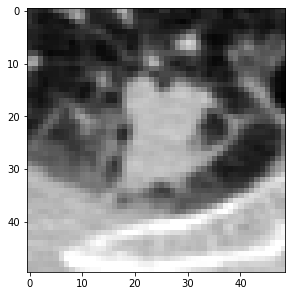

HCRP_LUSC_091_IMG0269.dcm (146, 131)


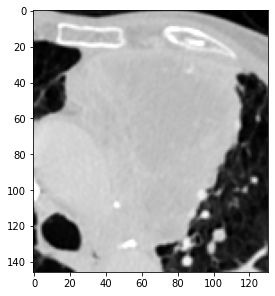

HCRP_LUSC_081_IMG0152.dcm (73, 75)


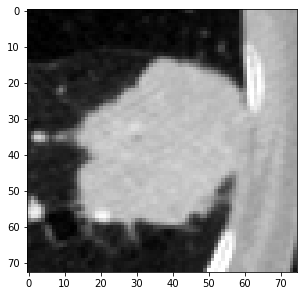

HCRP_LUSC_107_IMG0204.dcm (77, 78)


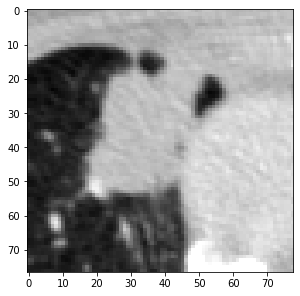

HCRP_LUSC_074_IMG0262.dcm (58, 48)


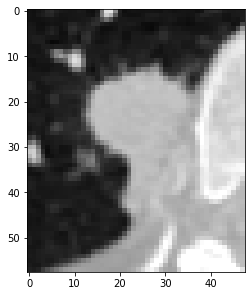

HCRP_LUSC_015_IMG0146.dcm (50, 52)


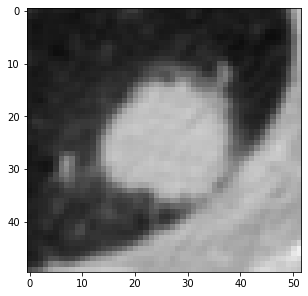

HCRP_LUSC_096_IMG0246.dcm (55, 61)


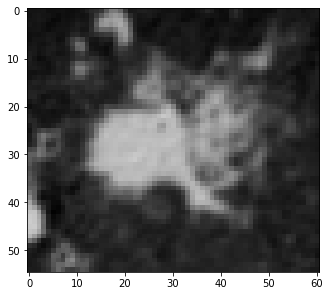

HCRP_LUSC_087_IMG0242.dcm (95, 81)


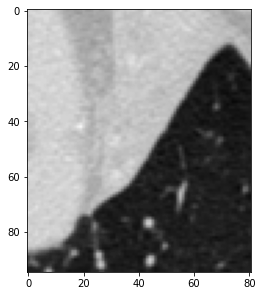

HCRP_LUSC_029_IMG0554.dcm (49, 42)


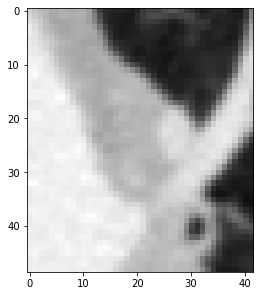

HCRP_LUSC_089_IMG0179.dcm (45, 45)


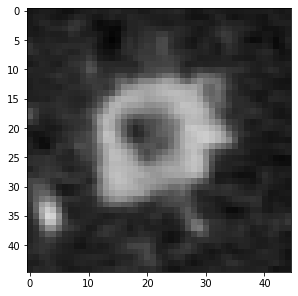

HCRP_LUSC_120_IMG0237.dcm (38, 43)


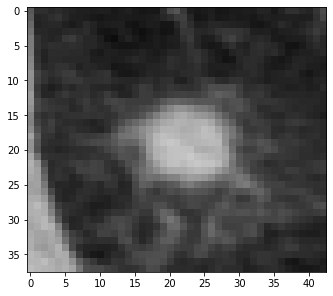

HCRP_LUSC_126_IMG0135.dcm (103, 98)


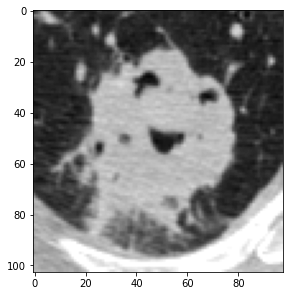

HCRP_LUSC_127_IMG0116.dcm (88, 81)


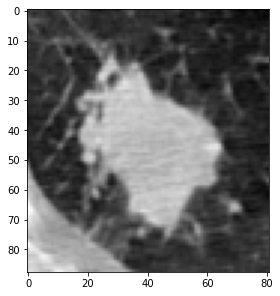

HCRP_LUSC_091_IMG0230.dcm (118, 106)


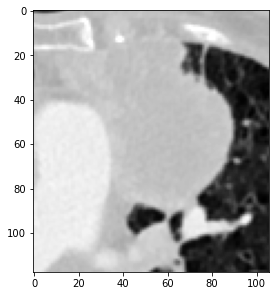

HCRP_LUSC_059_IMG0154.dcm (38, 33)


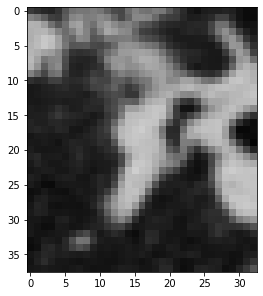

HCRP_LUSC_107_IMG0210.dcm (62, 51)


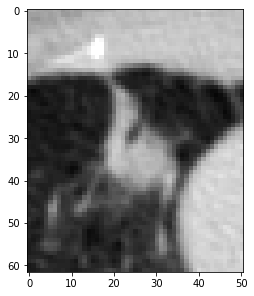

HCRP_LUSC_126_IMG0134.dcm (102, 87)


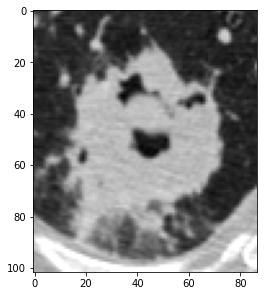

HCRP_LUSC_069_IMG0226.dcm (43, 48)


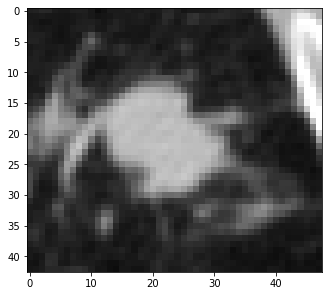

HCRP_LUSC_081_IMG0155.dcm (71, 72)


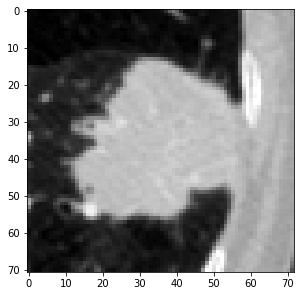

HCRP_LUSC_006_IMG0192.dcm (62, 64)


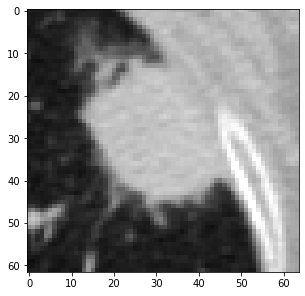

HCRP_LUSC_103_IMG0221.dcm (81, 86)


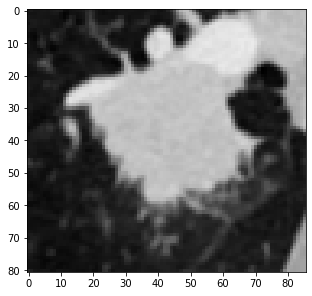

HCRP_LUSC_126_IMG0117.dcm (66, 56)


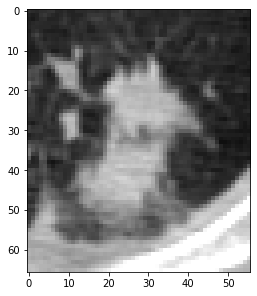

HCRP_LUSC_074_IMG0257.dcm (49, 50)


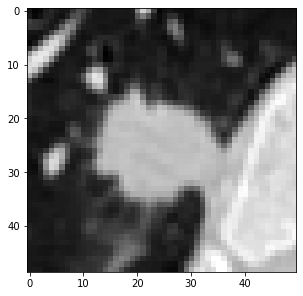

HCRP_LUSC_037_IMG0134.dcm (48, 51)


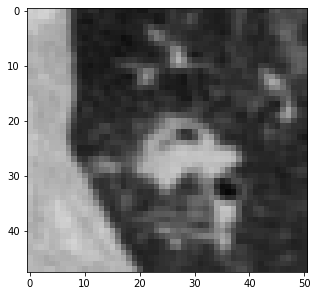

HCRP_LUSC_125_IMG0217.dcm (65, 81)


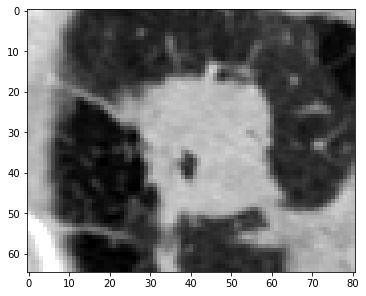

HCRP_LUSC_114_IMG0162.dcm (79, 96)


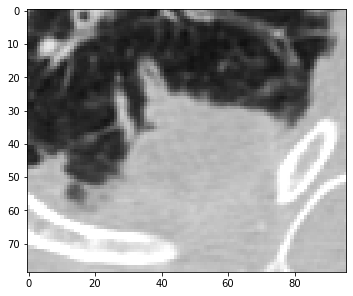

HCRP_LUSC_091_IMG0294.dcm (130, 97)


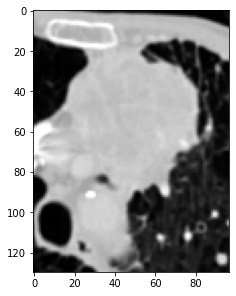

HCRP_LUSC_096_IMG0233.dcm (79, 66)


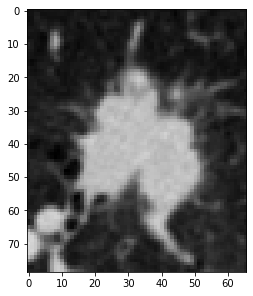

HCRP_LUSC_096_IMG0235.dcm (70, 65)


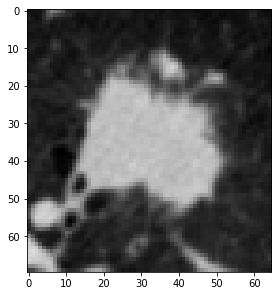

HCRP_LUSC_015_IMG0149.dcm (44, 41)


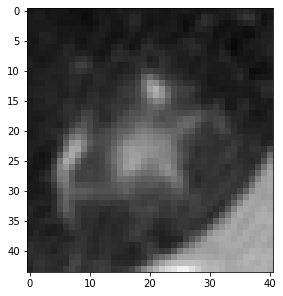

HCRP_LUSC_051_IMG0279.dcm (53, 53)


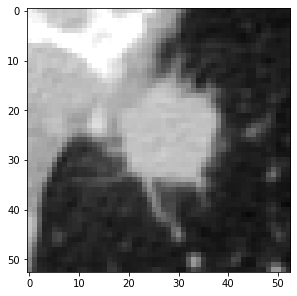

HCRP_LUSC_126_IMG0141.dcm (100, 82)


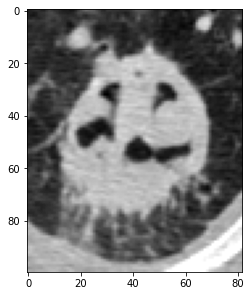

HCRP_LUSC_091_IMG0227.dcm (105, 81)


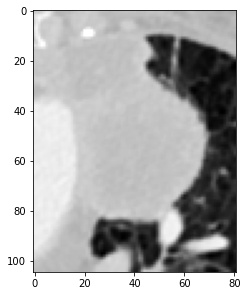

HCRP_LUSC_013_IMG0248.dcm (62, 65)


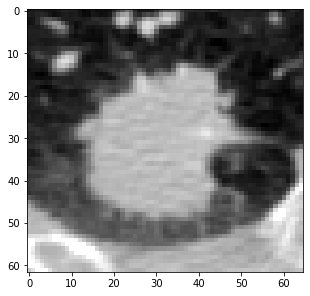

HCRP_LUSC_029_IMG0582.dcm (68, 69)


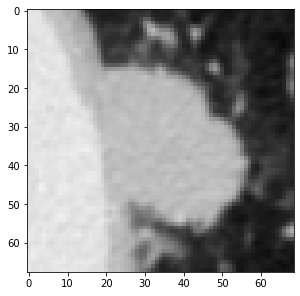

HCRP_LUSC_126_IMG0119.dcm (64, 61)


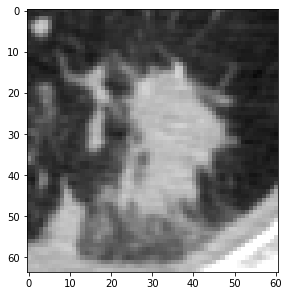

HCRP_LUSC_035_IMG0208.dcm (52, 55)


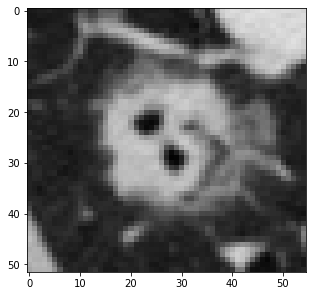

HCRP_LUSC_051_IMG0270.dcm (46, 45)


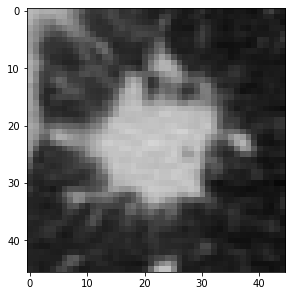

HCRP_LUSC_015_IMG0122.dcm (59, 62)


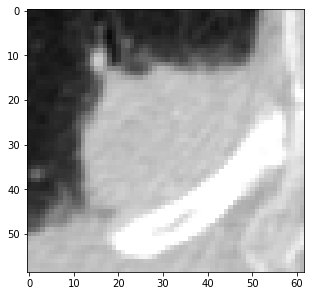

HCRP_LUSC_035_IMG0196.dcm (55, 58)


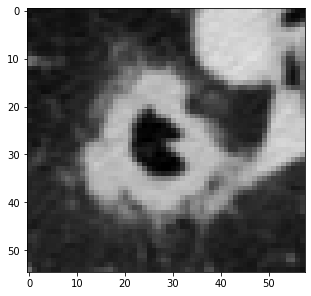

HCRP_LUSC_091_IMG0242.dcm (153, 119)


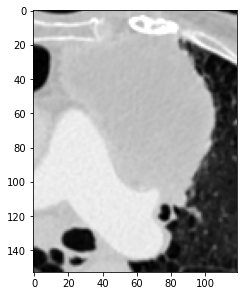

HCRP_LUSC_035_IMG0205.dcm (54, 58)


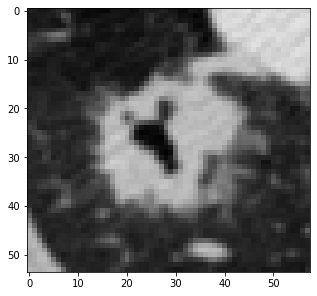

HCRP_LUSC_029_IMG0581.dcm (69, 69)


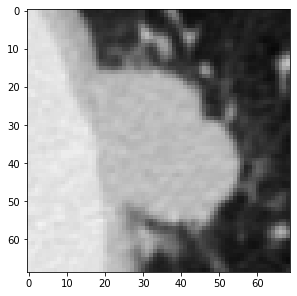

HCRP_LUSC_018_IMG0273.dcm (41, 41)


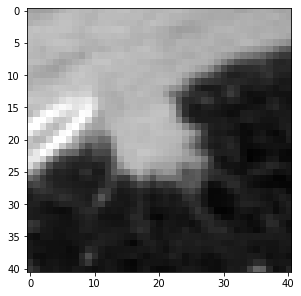

HCRP_LUSC_087_IMG0192.dcm (85, 82)


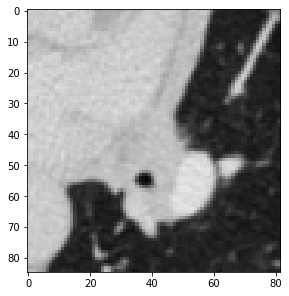

HCRP_LUSC_066_IMG0337.dcm (44, 44)


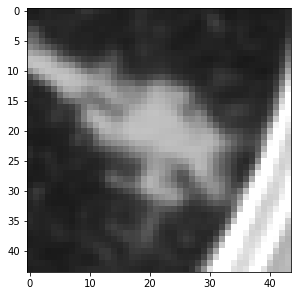

HCRP_LUSC_004_IMG0231.dcm (45, 44)


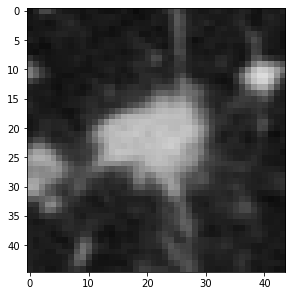

HCRP_LUSC_126_IMG0127.dcm (89, 79)


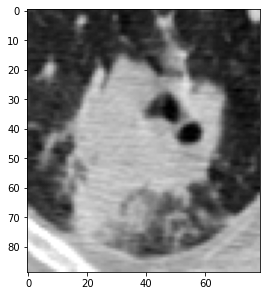

HCRP_LUSC_126_IMG0138.dcm (107, 94)


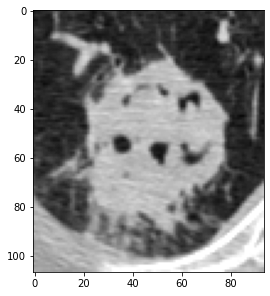

HCRP_LUSC_107_IMG0208.dcm (88, 56)


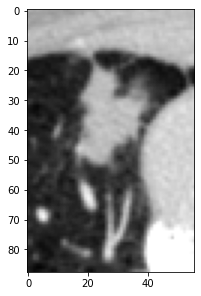

HCRP_LUSC_066_IMG0339.dcm (37, 42)


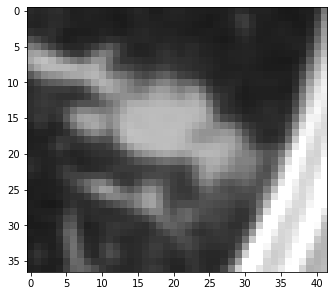

HCRP_LUSC_013_IMG0250.dcm (62, 65)


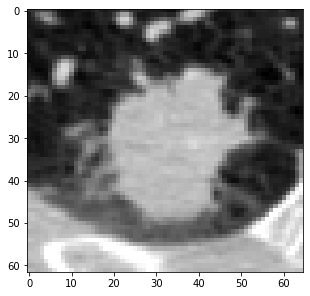

HCRP_LUSC_127_IMG0104.dcm (110, 89)


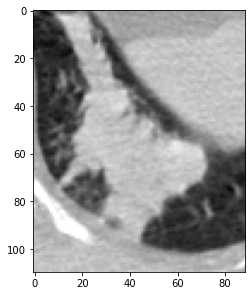

HCRP_LUSC_013_IMG0252.dcm (60, 59)


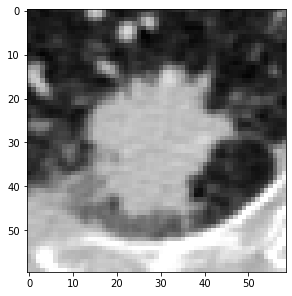

HCRP_LUSC_035_IMG0191.dcm (45, 42)


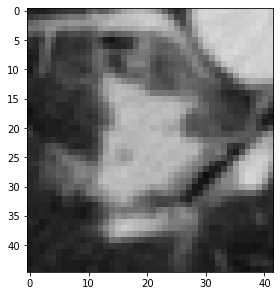

HCRP_LUSC_103_IMG0231.dcm (78, 74)


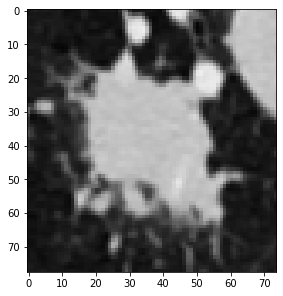

HCRP_LUSC_100_IMG0223.dcm (43, 39)


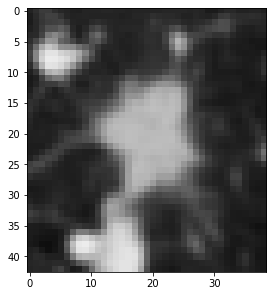

HCRP_LUSC_107_IMG0198.dcm (65, 67)


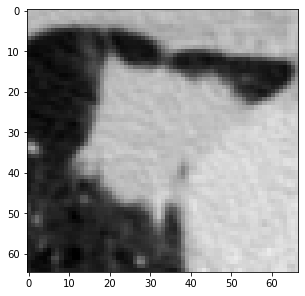

HCRP_LUSC_059_IMG0173.dcm (55, 54)


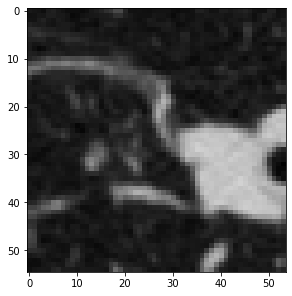

HCRP_LUSC_035_IMG0209.dcm (50, 56)


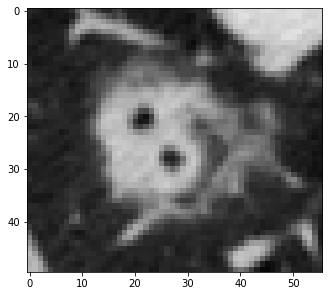

HCRP_LUSC_015_IMG0139.dcm (69, 65)


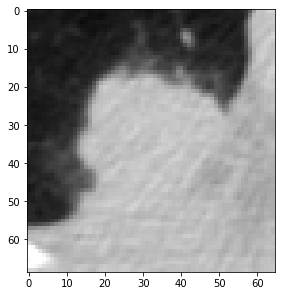

HCRP_LUSC_018_IMG0260.dcm (46, 39)


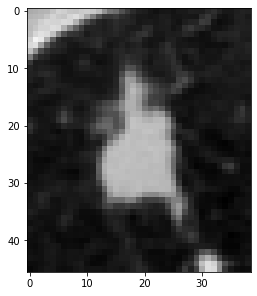

HCRP_LUSC_126_IMG0139.dcm (102, 92)


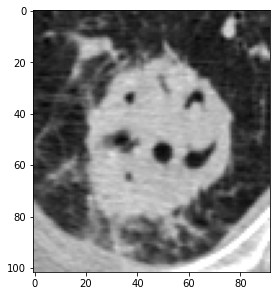

HCRP_LUSC_127_IMG0088.dcm (57, 57)


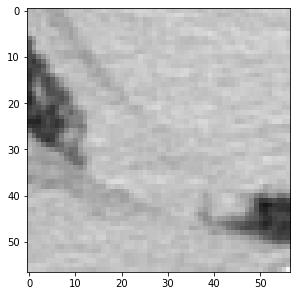

HCRP_LUSC_023_IMG0265.dcm (75, 58)


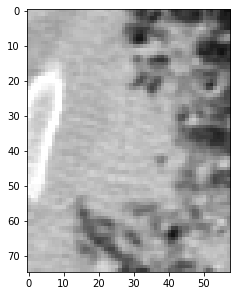

HCRP_LUSC_071_IMG0123.dcm (45, 46)


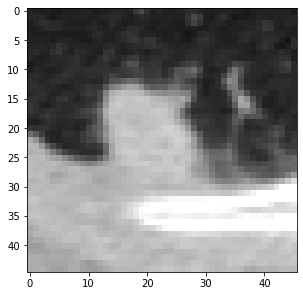

HCRP_LUSC_127_IMG0117.dcm (86, 78)


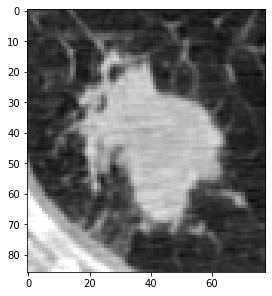

HCRP_LUSC_037_IMG0128.dcm (67, 65)


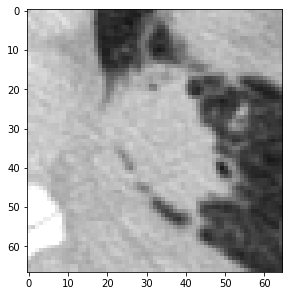

HCRP_LUSC_125_IMG0191.dcm (46, 54)


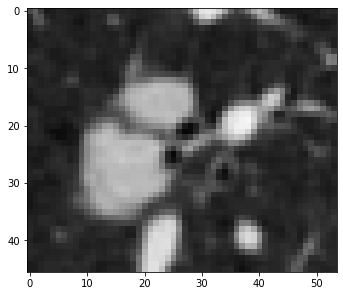

HCRP_LUSC_023_IMG0229.dcm (60, 73)


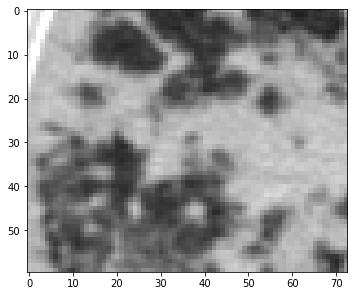

HCRP_LUSC_091_IMG0297.dcm (116, 93)


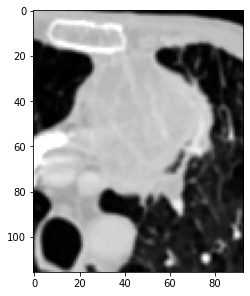

HCRP_LUSC_087_IMG0207.dcm (94, 80)


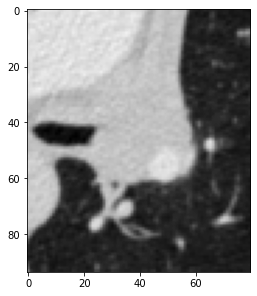

HCRP_LUSC_023_IMG0264.dcm (71, 60)


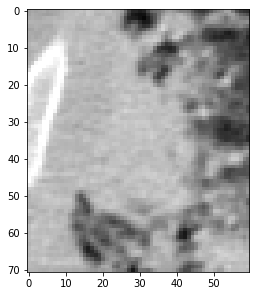

HCRP_LUSC_087_IMG0226.dcm (112, 68)


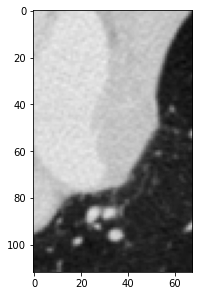

HCRP_LUSC_125_IMG0202.dcm (74, 71)


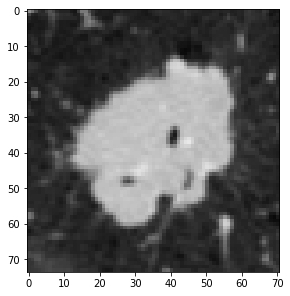

HCRP_LUSC_126_IMG0148.dcm (92, 72)


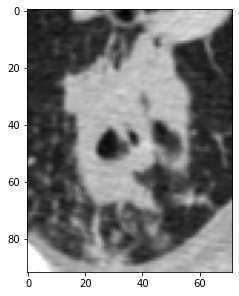

HCRP_LUSC_028_IMG0174.dcm (43, 41)


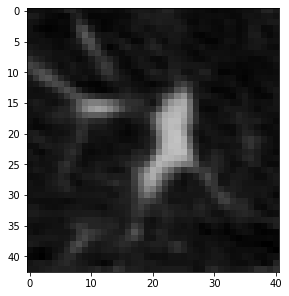

HCRP_LUSC_091_IMG0261.dcm (140, 144)


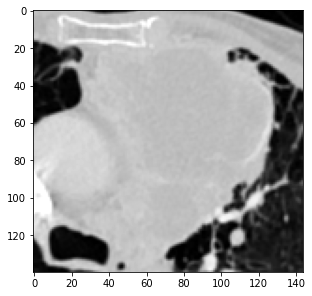

HCRP_LUSC_087_IMG0212.dcm (100, 83)


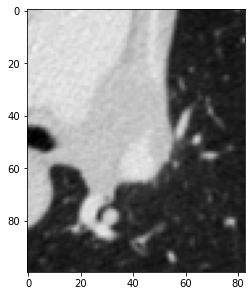

HCRP_LUSC_103_IMG0247.dcm (50, 56)


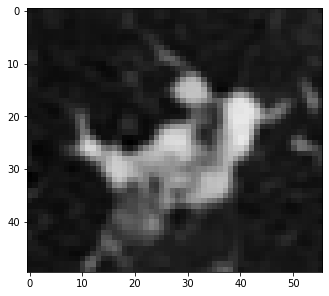

HCRP_LUSC_091_IMG0251.dcm (152, 135)


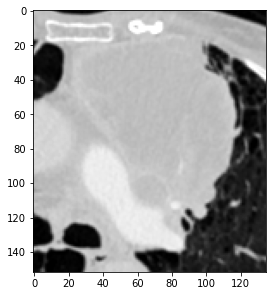

HCRP_LUSC_103_IMG0225.dcm (78, 82)


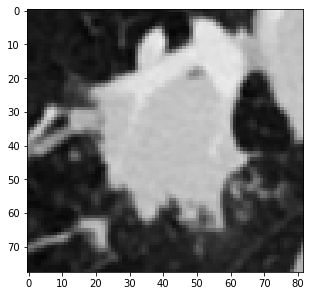

HCRP_LUSC_091_IMG0264.dcm (140, 145)


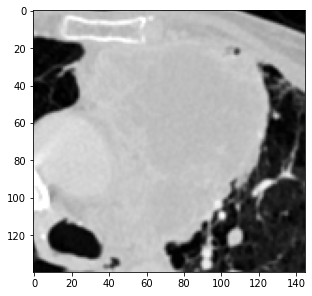

HCRP_LUSC_091_IMG0301.dcm (100, 91)


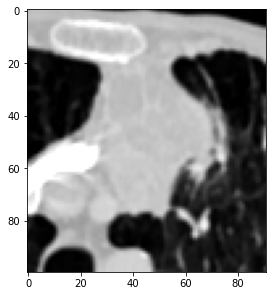

HCRP_LUSC_087_IMG0228.dcm (110, 68)


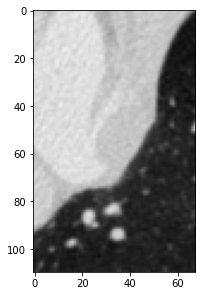

HCRP_LUSC_087_IMG0223.dcm (110, 73)


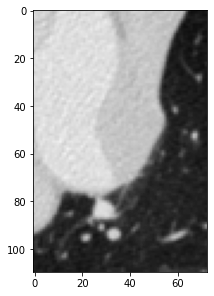

HCRP_LUSC_081_IMG0140.dcm (70, 70)


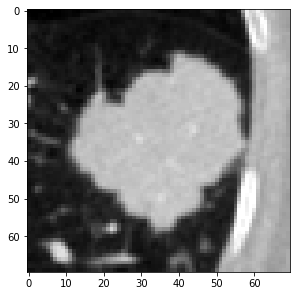

HCRP_LUSC_103_IMG0250.dcm (51, 54)


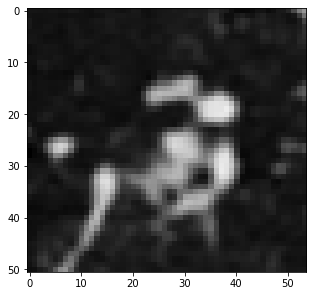

HCRP_LUSC_103_IMG0200.dcm (46, 47)


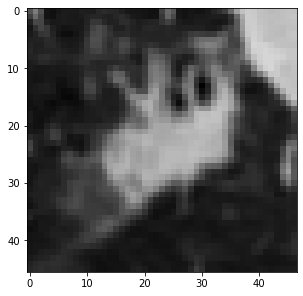

HCRP_LUSC_089_IMG0190.dcm (64, 58)


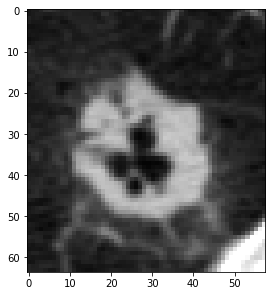

HCRP_LUSC_127_IMG0102.dcm (109, 91)


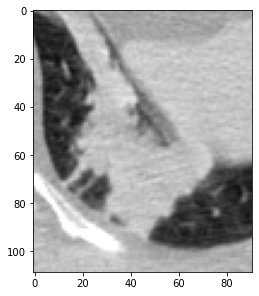

HCRP_LUSC_091_IMG0306.dcm (88, 79)


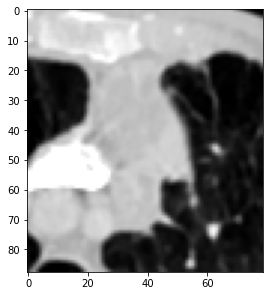

HCRP_LUSC_071_IMG0119.dcm (39, 53)


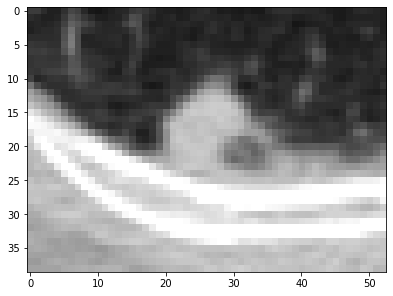

HCRP_LUSC_004_IMG0228.dcm (49, 45)


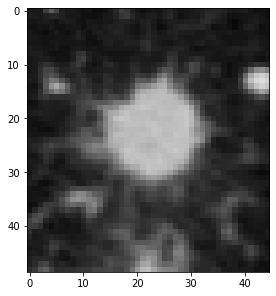

HCRP_LUSC_103_IMG0203.dcm (54, 60)


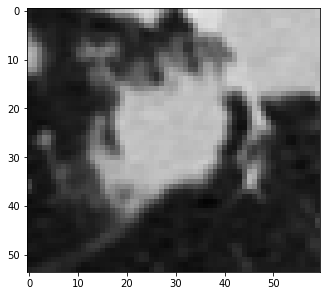

HCRP_LUSC_126_IMG0155.dcm (78, 58)


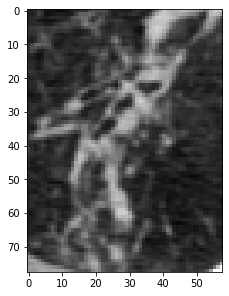

HCRP_LUSC_081_IMG0164.dcm (59, 59)


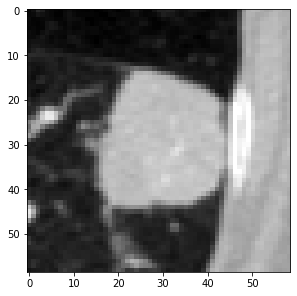

HCRP_LUSC_069_IMG0227.dcm (43, 61)


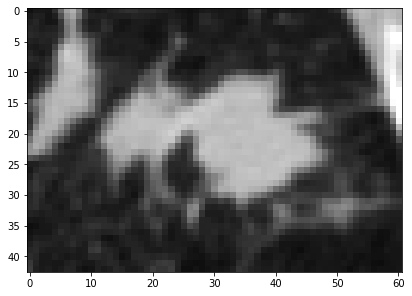

HCRP_LUSC_081_IMG0144.dcm (77, 76)


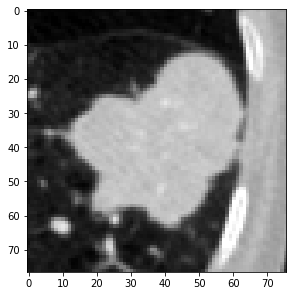

HCRP_LUSC_127_IMG0096.dcm (70, 76)


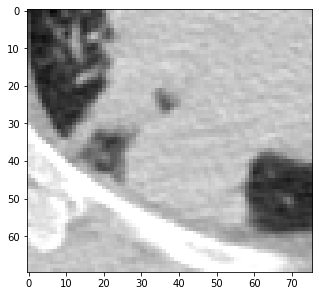

HCRP_LUSC_006_IMG0199.dcm (48, 47)


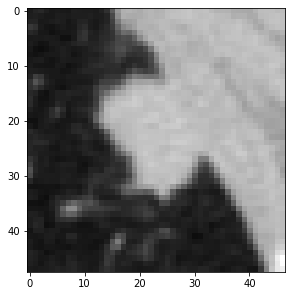

HCRP_LUSC_037_IMG0127.dcm (71, 67)


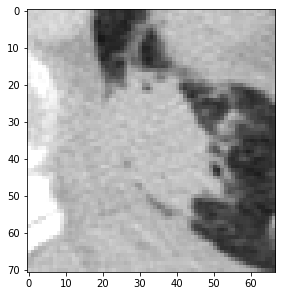

HCRP_LUSC_126_IMG0118.dcm (63, 56)


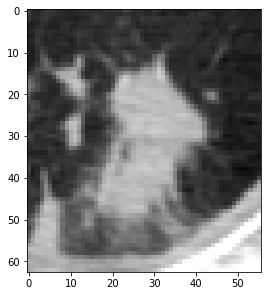

HCRP_LUSC_087_IMG0183.dcm (86, 81)


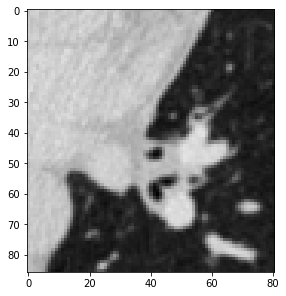

HCRP_LUSC_114_IMG0166.dcm (64, 79)


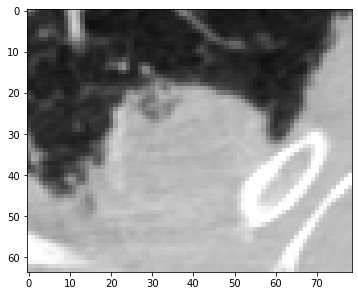

HCRP_LUSC_071_IMG0122.dcm (43, 48)


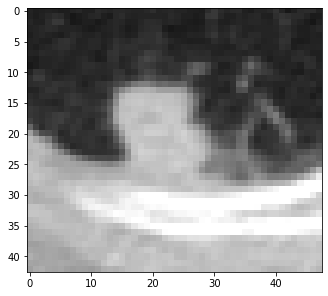

HCRP_LUSC_037_IMG0130.dcm (64, 58)


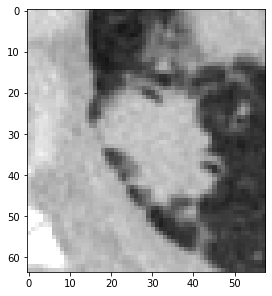

HCRP_LUSC_066_IMG0329.dcm (39, 43)


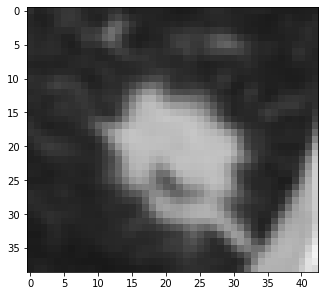

HCRP_LUSC_103_IMG0208.dcm (59, 68)


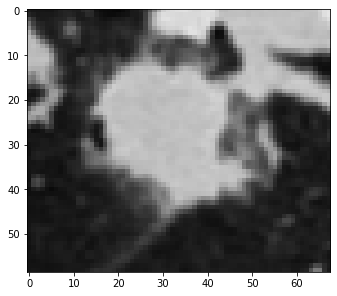

HCRP_LUSC_087_IMG0218.dcm (126, 73)


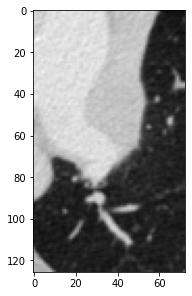

HCRP_LUSC_074_IMG0255.dcm (54, 50)


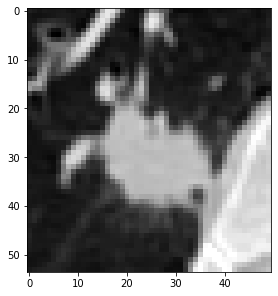

HCRP_LUSC_066_IMG0333.dcm (47, 45)


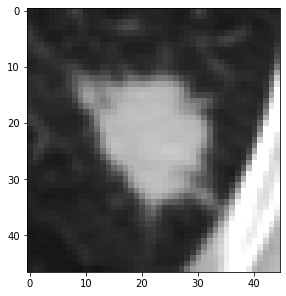

HCRP_LUSC_114_IMG0167.dcm (64, 73)


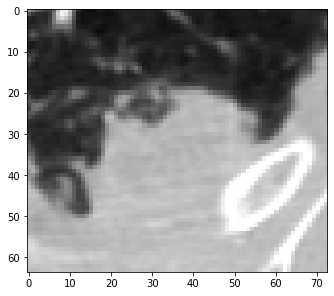

HCRP_LUSC_114_IMG0170.dcm (55, 68)


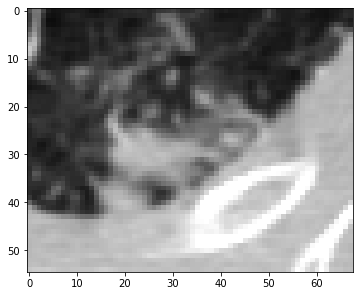

HCRP_LUSC_096_IMG0231.dcm (72, 68)


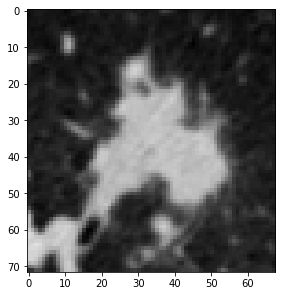

HCRP_LUSC_114_IMG0173.dcm (49, 55)


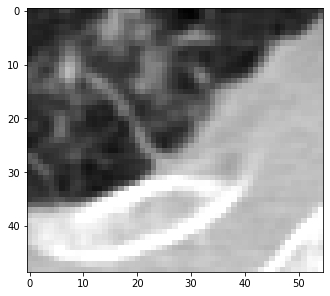

HCRP_LUSC_029_IMG0587.dcm (69, 65)


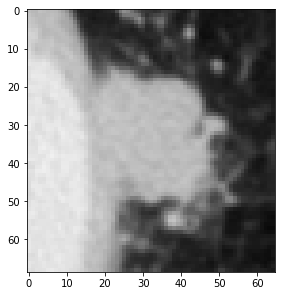

HCRP_LUSC_103_IMG0199.dcm (42, 46)


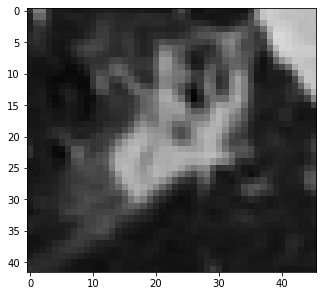

HCRP_LUSC_126_IMG0133.dcm (103, 88)


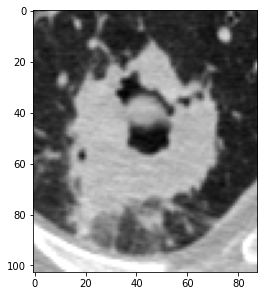

HCRP_LUSC_096_IMG0230.dcm (66, 68)


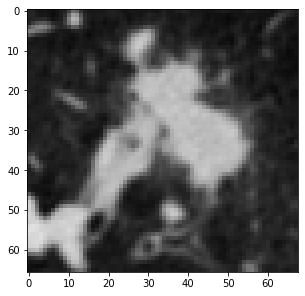

HCRP_LUSC_069_IMG0230.dcm (56, 74)


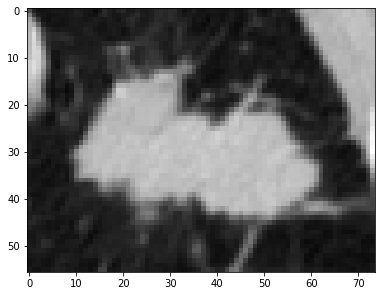

HCRP_LUSC_126_IMG0151.dcm (82, 66)


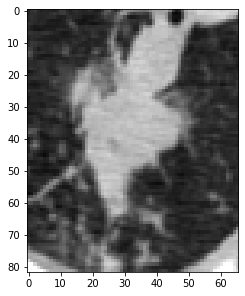

HCRP_LUSC_091_IMG0263.dcm (139, 143)


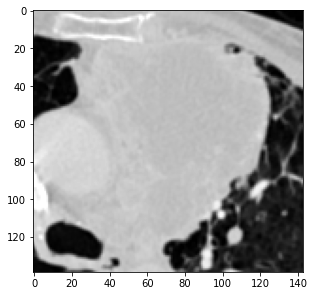

HCRP_LUSC_127_IMG0112.dcm (90, 78)


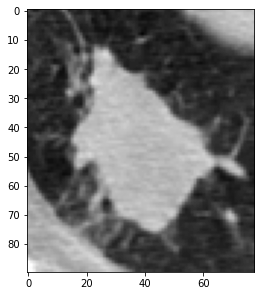

HCRP_LUSC_087_IMG0241.dcm (98, 81)


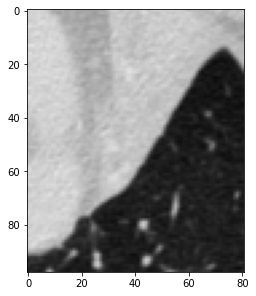

HCRP_LUSC_013_IMG0259.dcm (45, 40)


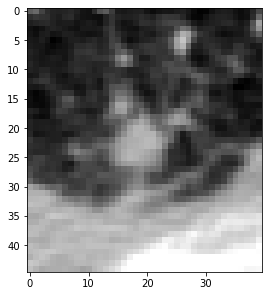

HCRP_LUSC_103_IMG0207.dcm (57, 67)


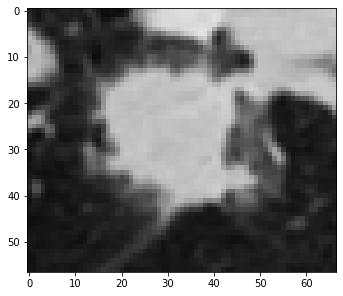

HCRP_LUSC_103_IMG0248.dcm (50, 54)


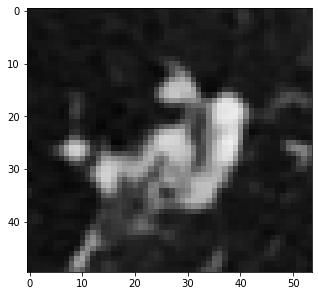

HCRP_LUSC_074_IMG0261.dcm (60, 48)


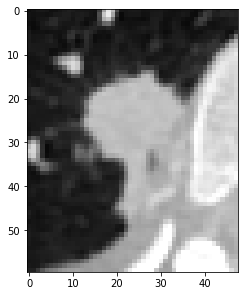

HCRP_LUSC_023_IMG0245.dcm (90, 87)


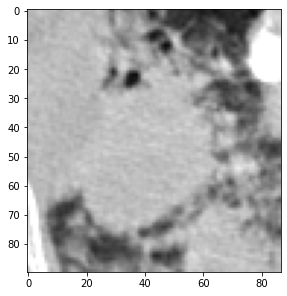

HCRP_LUSC_059_IMG0168.dcm (52, 76)


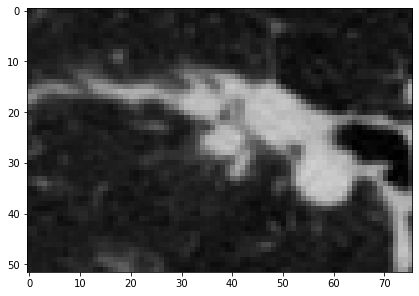

HCRP_LUSC_103_IMG0234.dcm (74, 67)


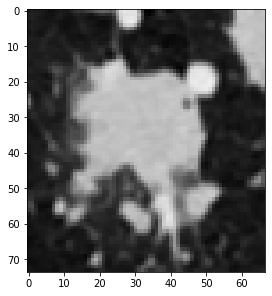

HCRP_LUSC_015_IMG0147.dcm (48, 50)


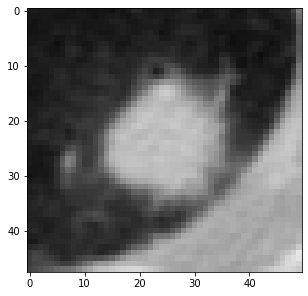

HCRP_LUSC_089_IMG0178.dcm (42, 41)


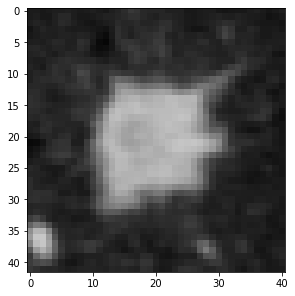

HCRP_LUSC_071_IMG0118.dcm (40, 54)


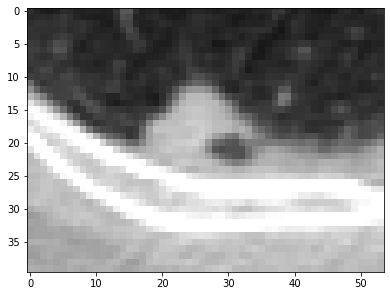

HCRP_LUSC_096_IMG0227.dcm (52, 50)


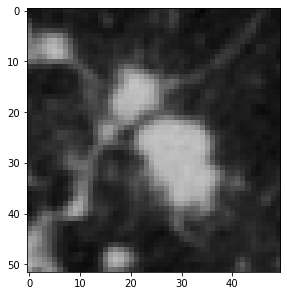

HCRP_LUSC_081_IMG0148.dcm (77, 82)


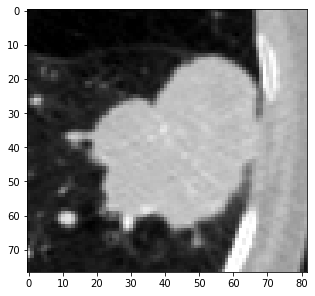

HCRP_LUSC_127_IMG0108.dcm (106, 85)


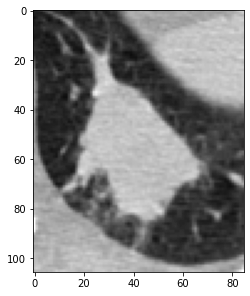

HCRP_LUSC_013_IMG0229.dcm (57, 54)


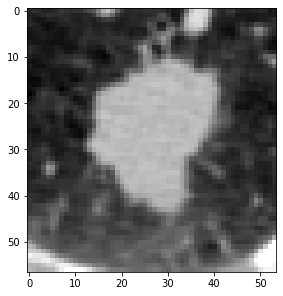

HCRP_LUSC_059_IMG0161.dcm (62, 68)


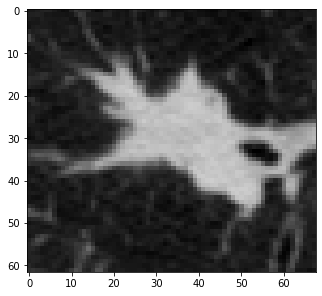

HCRP_LUSC_051_IMG0269.dcm (41, 44)


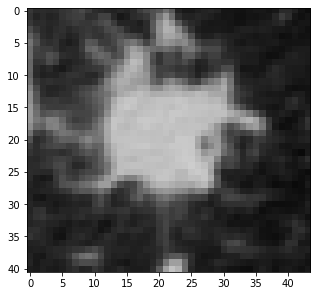

HCRP_LUSC_081_IMG0147.dcm (77, 82)


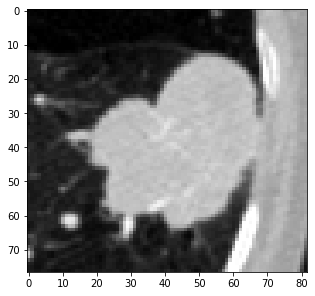

HCRP_LUSC_059_IMG0162.dcm (61, 69)


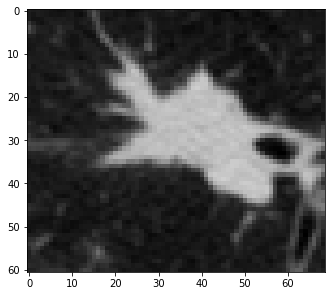

HCRP_LUSC_069_IMG0228.dcm (50, 72)


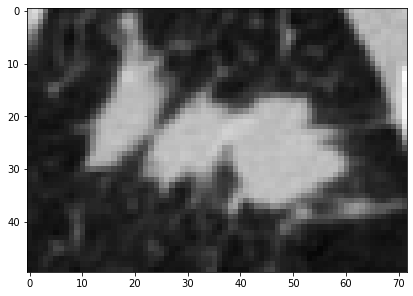

HCRP_LUSC_059_IMG0157.dcm (68, 68)


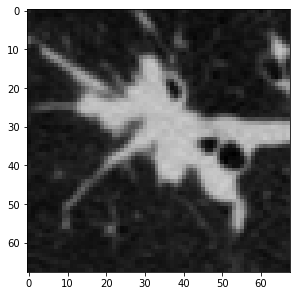

HCRP_LUSC_091_IMG0233.dcm (120, 111)


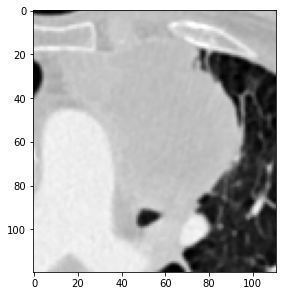

HCRP_LUSC_103_IMG0222.dcm (79, 83)


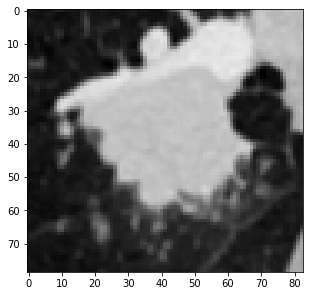

HCRP_LUSC_069_IMG0249.dcm (60, 56)


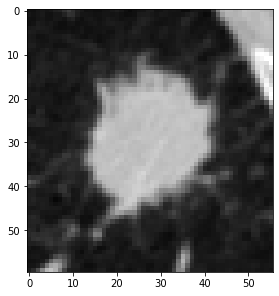

HCRP_LUSC_029_IMG0577.dcm (74, 73)


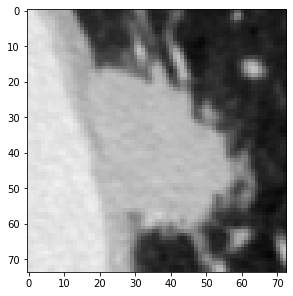

HCRP_LUSC_091_IMG0296.dcm (120, 95)


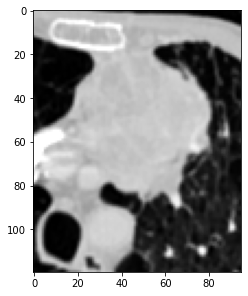

HCRP_LUSC_087_IMG0188.dcm (83, 82)


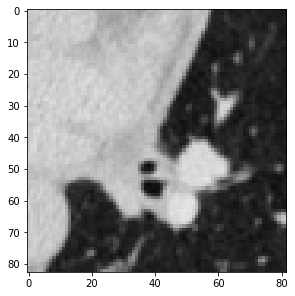

HCRP_LUSC_091_IMG0309.dcm (82, 60)


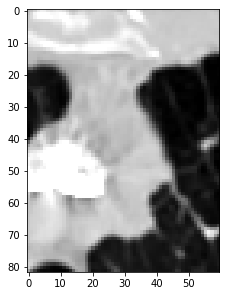

HCRP_LUSC_023_IMG0263.dcm (73, 62)


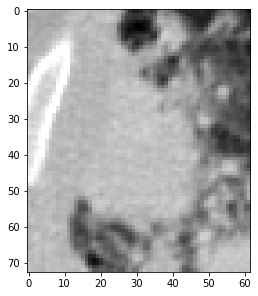

HCRP_LUSC_081_IMG0142.dcm (74, 72)


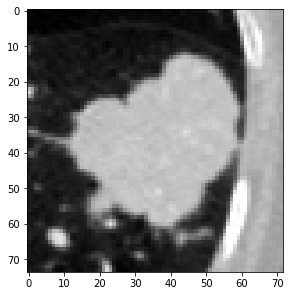

HCRP_LUSC_059_IMG0170.dcm (53, 58)


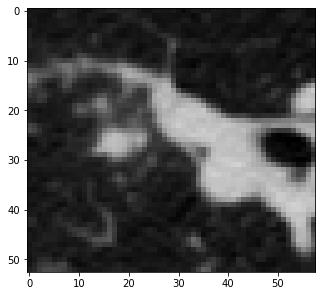

HCRP_LUSC_006_IMG0193.dcm (60, 59)


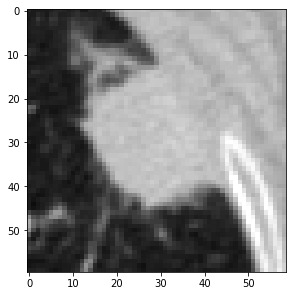

HCRP_LUSC_096_IMG0244.dcm (61, 62)


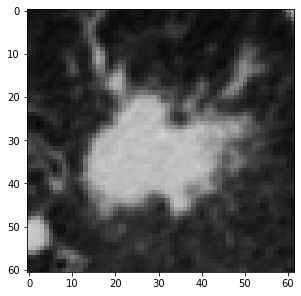

HCRP_LUSC_015_IMG0137.dcm (69, 67)


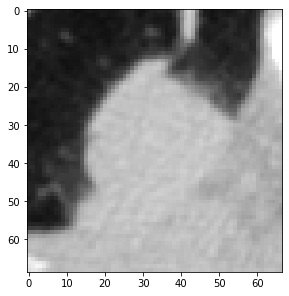

HCRP_LUSC_015_IMG0136.dcm (70, 71)


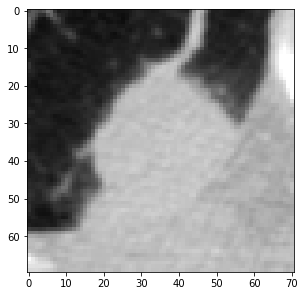

HCRP_LUSC_127_IMG0093.dcm (59, 69)


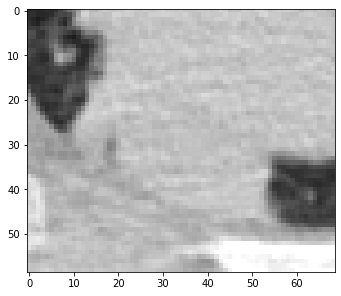

HCRP_LUSC_081_IMG0167.dcm (54, 51)


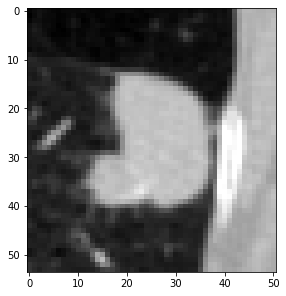

HCRP_LUSC_006_IMG0191.dcm (61, 63)


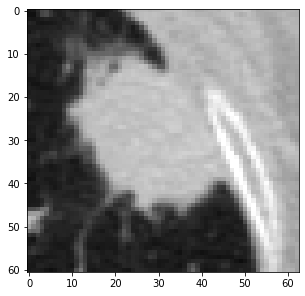

HCRP_LUSC_081_IMG0134.dcm (49, 59)


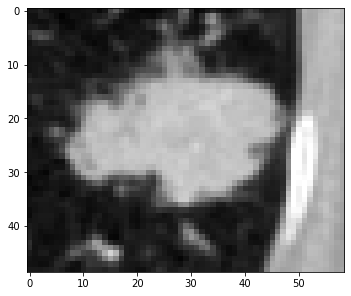

HCRP_LUSC_023_IMG0269.dcm (66, 51)


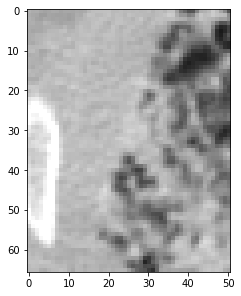

HCRP_LUSC_013_IMG0246.dcm (66, 66)


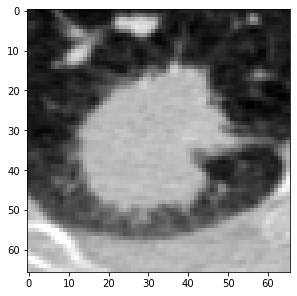

HCRP_LUSC_126_IMG0143.dcm (95, 86)


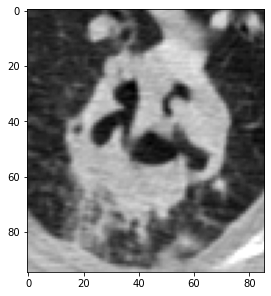

HCRP_LUSC_107_IMG0190.dcm (49, 48)


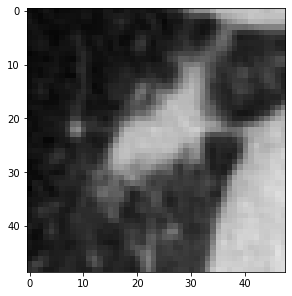

HCRP_LUSC_103_IMG0216.dcm (74, 96)


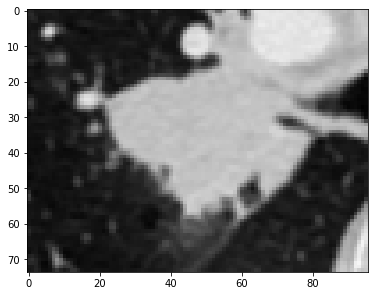

HCRP_LUSC_103_IMG0217.dcm (74, 97)


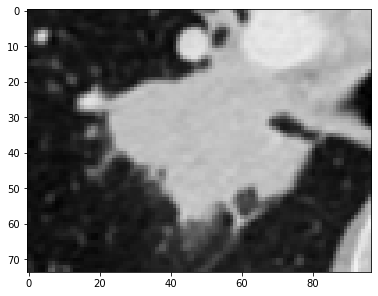

HCRP_LUSC_035_IMG0202.dcm (52, 59)


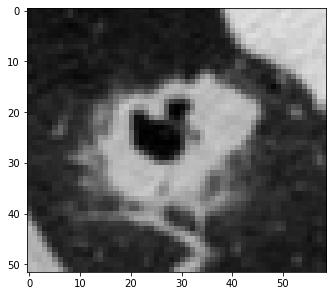

HCRP_LUSC_103_IMG0226.dcm (77, 80)


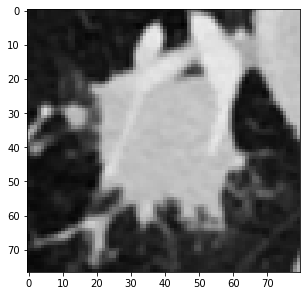

HCRP_LUSC_126_IMG0149.dcm (88, 70)


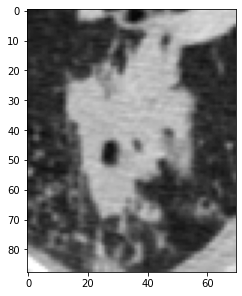

HCRP_LUSC_091_IMG0295.dcm (128, 95)


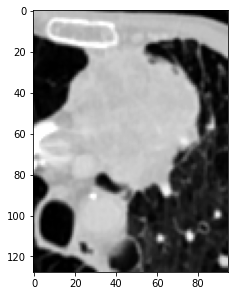

HCRP_LUSC_096_IMG0241.dcm (63, 66)


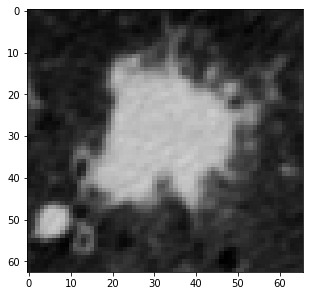

HCRP_LUSC_107_IMG0197.dcm (64, 67)


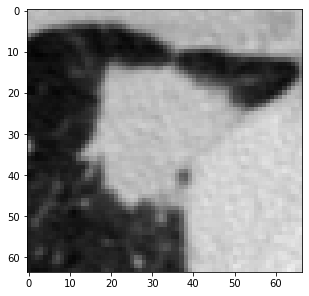

HCRP_LUSC_103_IMG0211.dcm (67, 86)


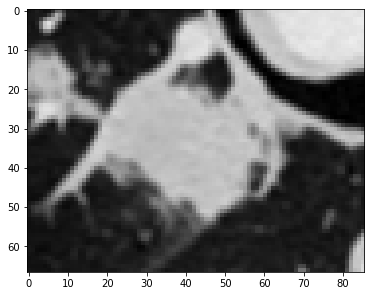

HCRP_LUSC_015_IMG0126.dcm (64, 65)


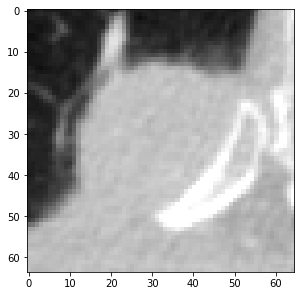

HCRP_LUSC_069_IMG0247.dcm (64, 58)


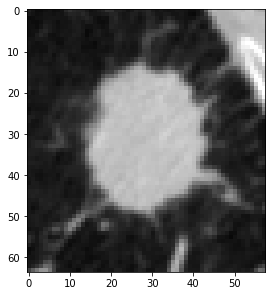

HCRP_LUSC_023_IMG0236.dcm (82, 92)


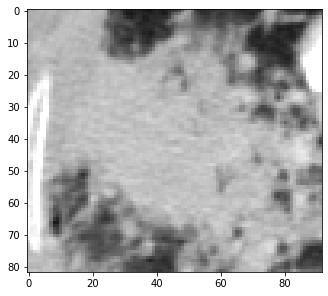

HCRP_LUSC_103_IMG0220.dcm (79, 89)


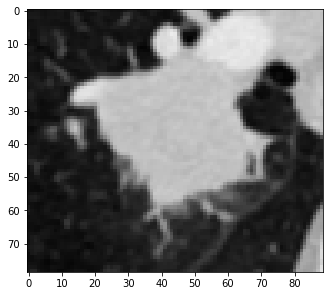

HCRP_LUSC_029_IMG0575.dcm (75, 73)


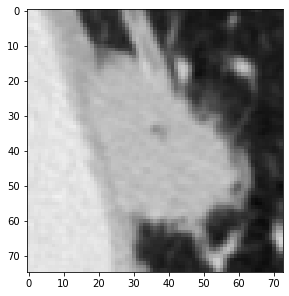

HCRP_LUSC_087_IMG0191.dcm (87, 84)


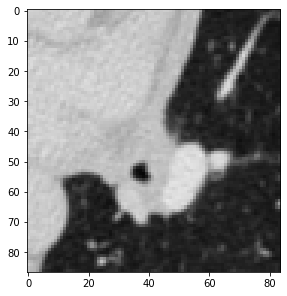

HCRP_LUSC_091_IMG0284.dcm (135, 112)


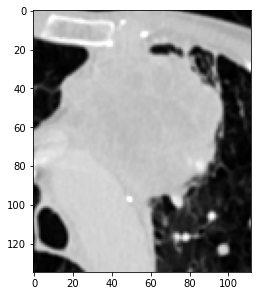

HCRP_LUSC_006_IMG0189.dcm (57, 64)


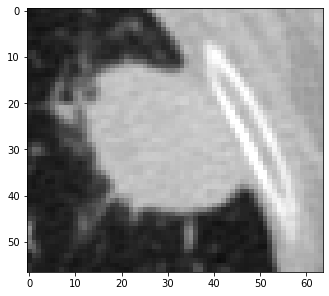

HCRP_LUSC_125_IMG0224.dcm (56, 53)


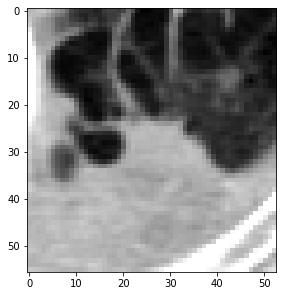

HCRP_LUSC_125_IMG0194.dcm (70, 58)


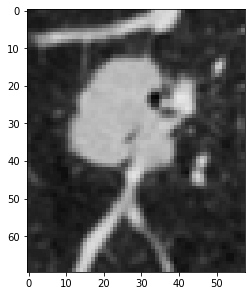

HCRP_LUSC_089_IMG0185.dcm (62, 58)


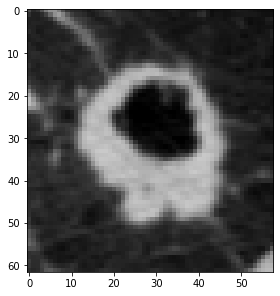

HCRP_LUSC_037_IMG0131.dcm (63, 58)


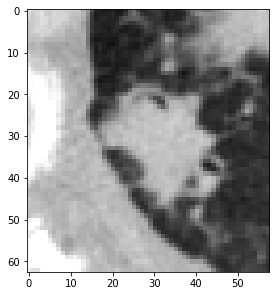

HCRP_LUSC_096_IMG0236.dcm (62, 65)


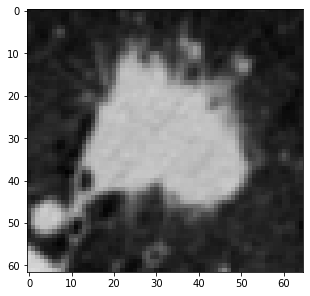

HCRP_LUSC_013_IMG0234.dcm (60, 60)


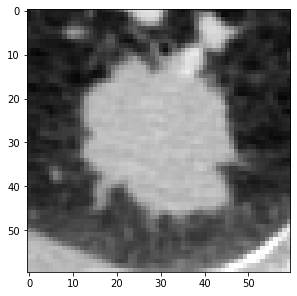

HCRP_LUSC_127_IMG0106.dcm (112, 87)


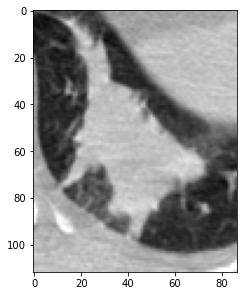

HCRP_LUSC_069_IMG0240.dcm (75, 74)


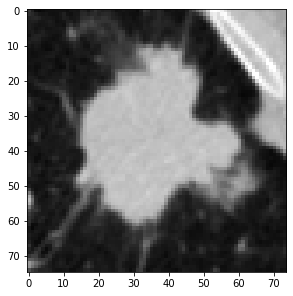

HCRP_LUSC_023_IMG0225.dcm (41, 42)


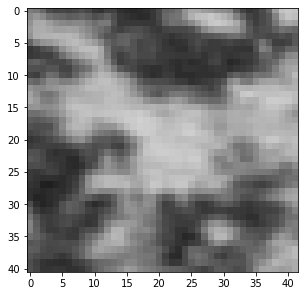

HCRP_LUSC_087_IMG0217.dcm (116, 85)


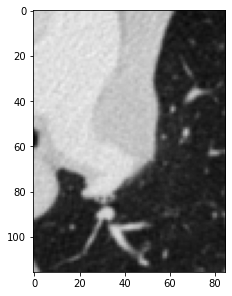

HCRP_LUSC_127_IMG0113.dcm (89, 79)


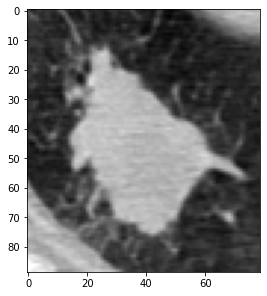

HCRP_LUSC_127_IMG0100.dcm (101, 88)


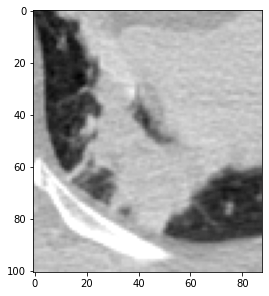

HCRP_LUSC_096_IMG0243.dcm (61, 63)


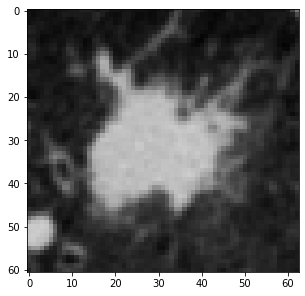

HCRP_LUSC_126_IMG0146.dcm (89, 83)


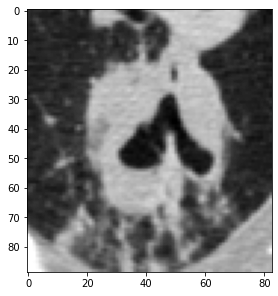

HCRP_LUSC_087_IMG0204.dcm (95, 83)


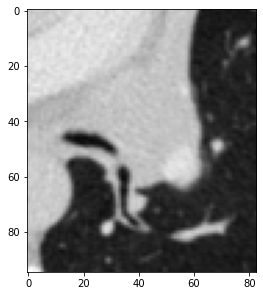

HCRP_LUSC_127_IMG0099.dcm (76, 82)


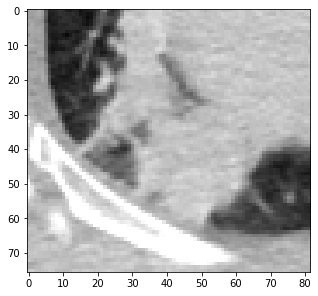

HCRP_LUSC_091_IMG0243.dcm (152, 127)


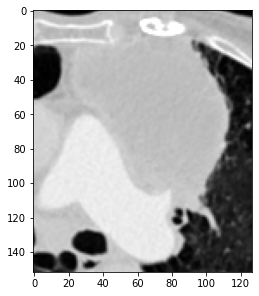

HCRP_LUSC_035_IMG0198.dcm (55, 57)


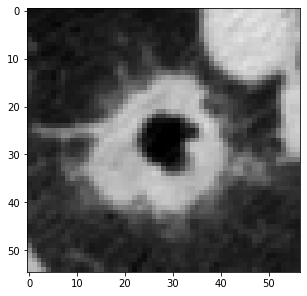

HCRP_LUSC_126_IMG0137.dcm (107, 95)


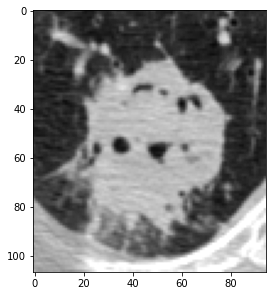

HCRP_LUSC_087_IMG0211.dcm (99, 83)


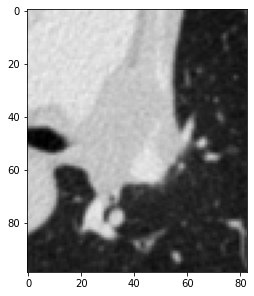

HCRP_LUSC_091_IMG0235.dcm (130, 115)


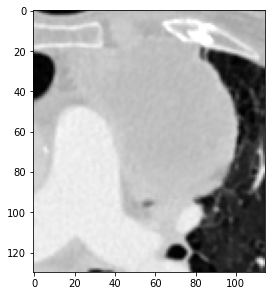

HCRP_LUSC_015_IMG0132.dcm (65, 68)


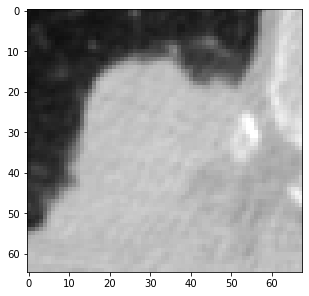

HCRP_LUSC_029_IMG0574.dcm (76, 74)


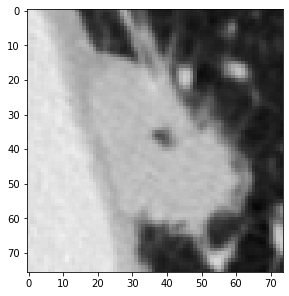

HCRP_LUSC_087_IMG0215.dcm (109, 82)


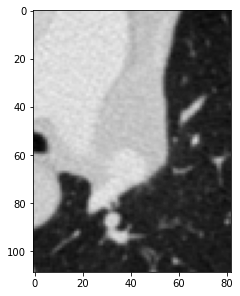

HCRP_LUSC_114_IMG0156.dcm (70, 80)


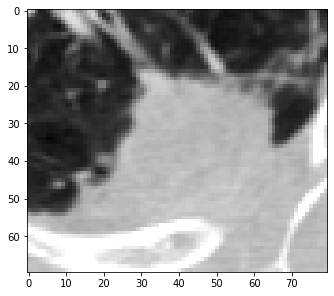

HCRP_LUSC_089_IMG0191.dcm (62, 58)


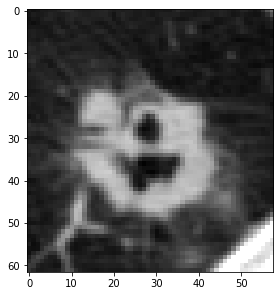

HCRP_LUSC_023_IMG0232.dcm (68, 90)


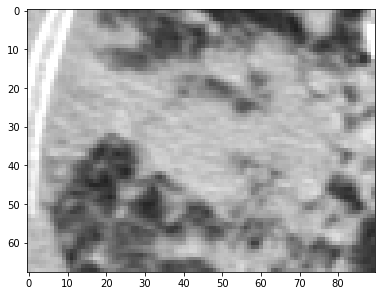

HCRP_LUSC_069_IMG0237.dcm (71, 77)


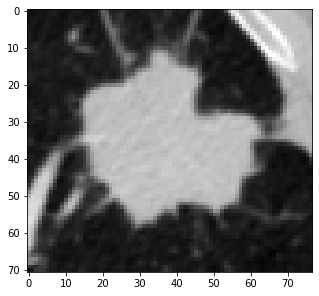

HCRP_LUSC_091_IMG0291.dcm (135, 107)


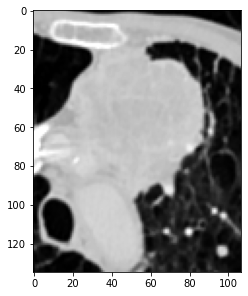

HCRP_LUSC_015_IMG0117.dcm (50, 51)


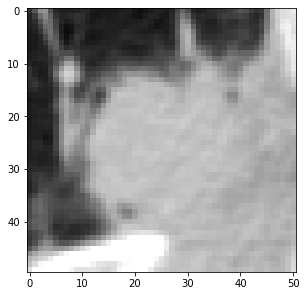

HCRP_LUSC_125_IMG0196.dcm (59, 61)


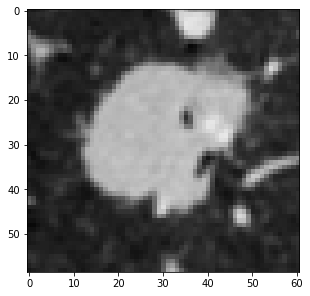

HCRP_LUSC_059_IMG0159.dcm (62, 68)


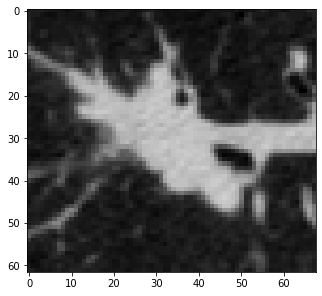

HCRP_LUSC_029_IMG0558.dcm (75, 58)


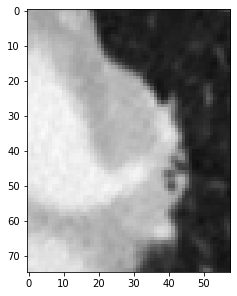

HCRP_LUSC_089_IMG0192.dcm (55, 57)


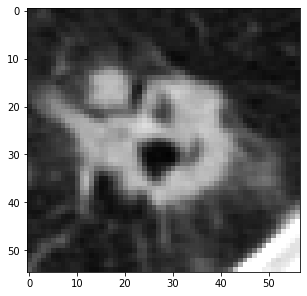

HCRP_LUSC_127_IMG0123.dcm (65, 74)


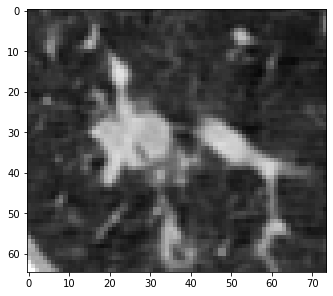

HCRP_LUSC_107_IMG0195.dcm (60, 61)


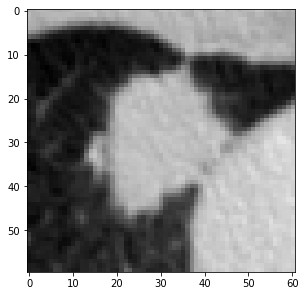

HCRP_LUSC_023_IMG0237.dcm (85, 100)


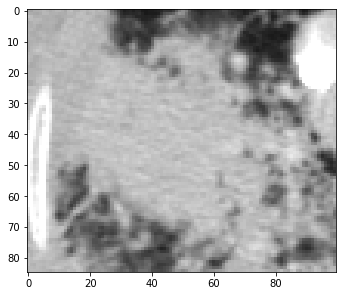

HCRP_LUSC_125_IMG0195.dcm (73, 60)


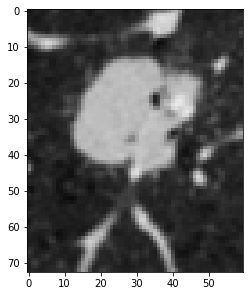

HCRP_LUSC_114_IMG0157.dcm (87, 81)


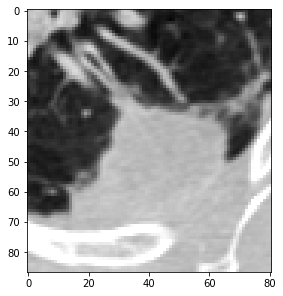

HCRP_LUSC_069_IMG0246.dcm (64, 58)


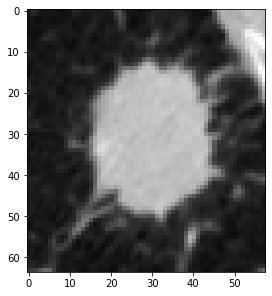

HCRP_LUSC_029_IMG0580.dcm (67, 69)


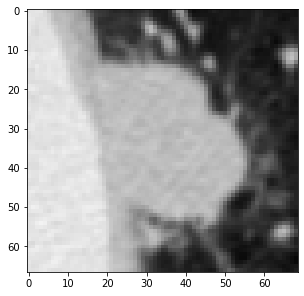

HCRP_LUSC_096_IMG0232.dcm (75, 65)


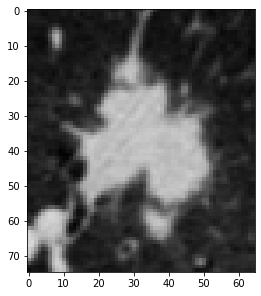

HCRP_LUSC_103_IMG0243.dcm (56, 56)


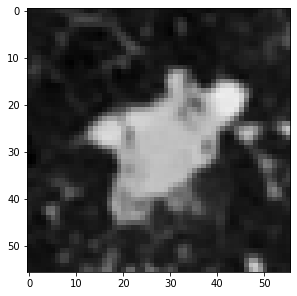

HCRP_LUSC_029_IMG0566.dcm (74, 66)


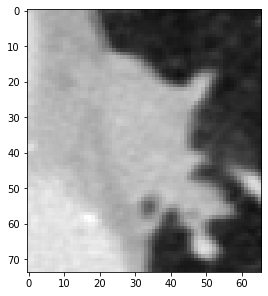

HCRP_LUSC_087_IMG0201.dcm (101, 83)


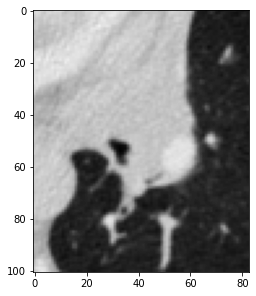

HCRP_LUSC_091_IMG0273.dcm (145, 130)


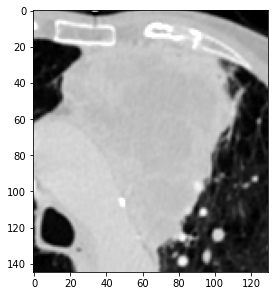

HCRP_LUSC_069_IMG0241.dcm (76, 75)


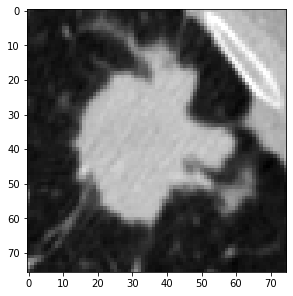

HCRP_LUSC_013_IMG0237.dcm (65, 64)


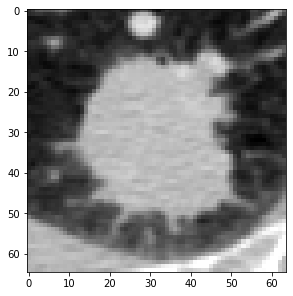

HCRP_LUSC_004_IMG0233.dcm (37, 45)


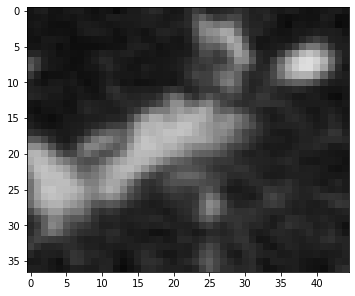

HCRP_LUSC_091_IMG0256.dcm (140, 140)


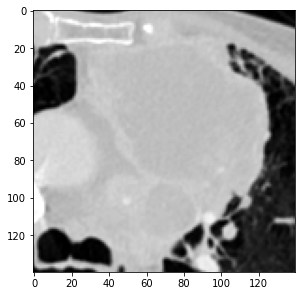

HCRP_LUSC_029_IMG0569.dcm (74, 67)


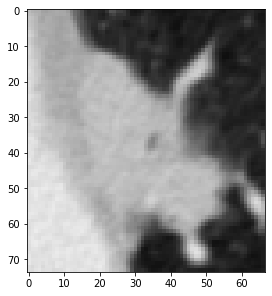

HCRP_LUSC_035_IMG0204.dcm (54, 61)


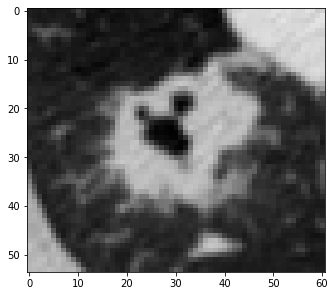

HCRP_LUSC_107_IMG0211.dcm (64, 46)


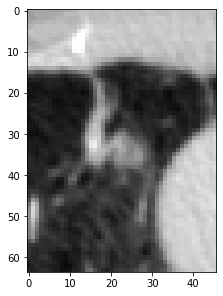

HCRP_LUSC_103_IMG0238.dcm (59, 60)


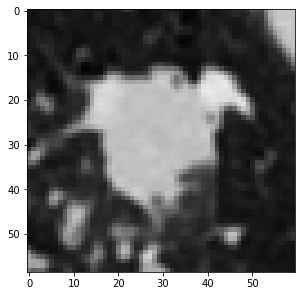

HCRP_LUSC_035_IMG0210.dcm (50, 55)


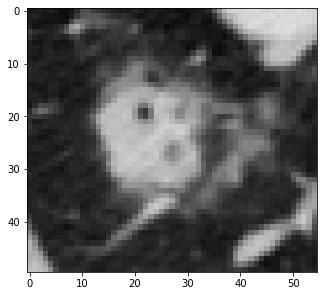

HCRP_LUSC_103_IMG0249.dcm (51, 54)


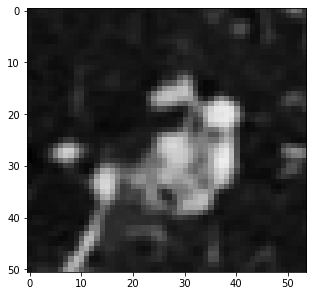

HCRP_LUSC_018_IMG0269.dcm (50, 43)


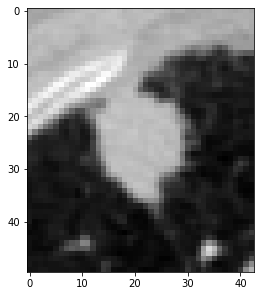

HCRP_LUSC_029_IMG0584.dcm (69, 70)


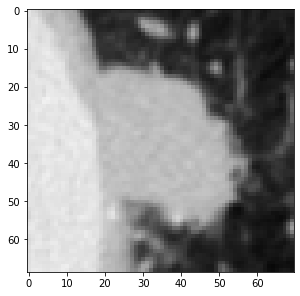

HCRP_LUSC_126_IMG0120.dcm (63, 62)


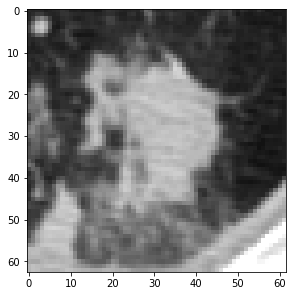

HCRP_LUSC_006_IMG0185.dcm (64, 70)


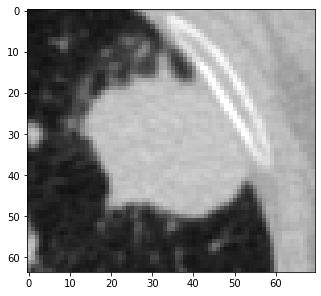

HCRP_LUSC_096_IMG0237.dcm (63, 66)


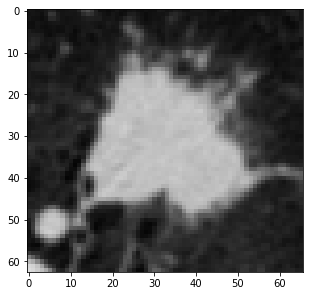

HCRP_LUSC_051_IMG0274.dcm (51, 54)


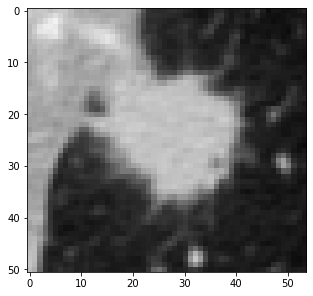

HCRP_LUSC_126_IMG0121.dcm (64, 72)


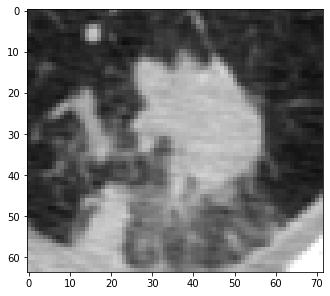

HCRP_LUSC_013_IMG0238.dcm (67, 66)


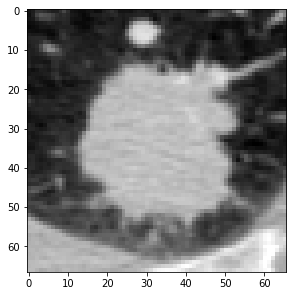

HCRP_LUSC_029_IMG0572.dcm (76, 68)


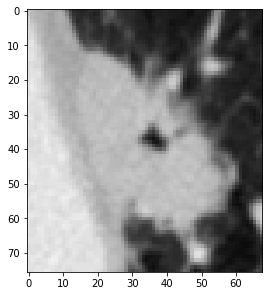

HCRP_LUSC_096_IMG0240.dcm (63, 63)


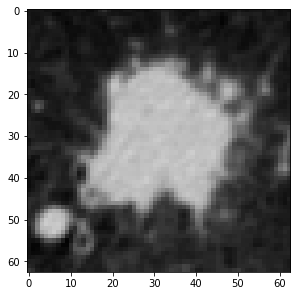

HCRP_LUSC_103_IMG0223.dcm (74, 81)


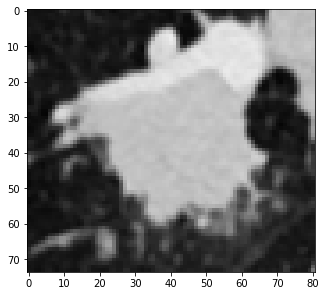

HCRP_LUSC_069_IMG0239.dcm (74, 75)


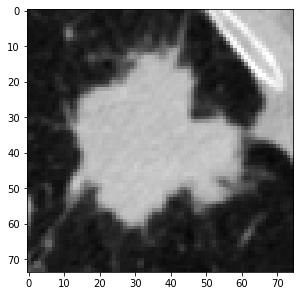

HCRP_LUSC_089_IMG0194.dcm (51, 48)


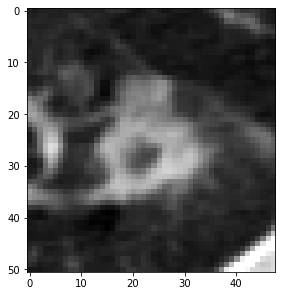

HCRP_LUSC_103_IMG0235.dcm (74, 66)


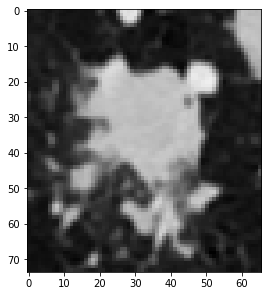

HCRP_LUSC_126_IMG0157.dcm (43, 44)


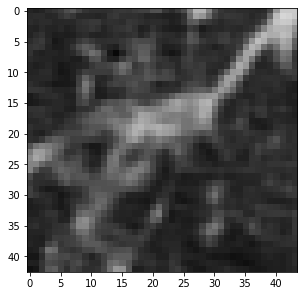

HCRP_LUSC_023_IMG0242.dcm (88, 92)


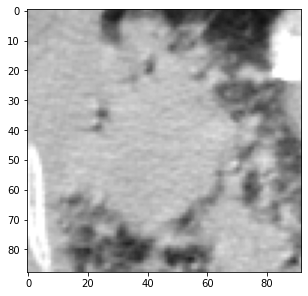

HCRP_LUSC_127_IMG0125.dcm (56, 80)


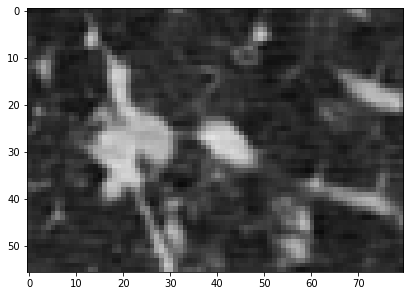

HCRP_LUSC_074_IMG0267.dcm (50, 47)


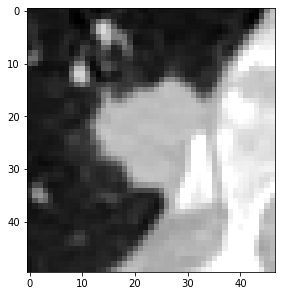

HCRP_LUSC_051_IMG0268.dcm (41, 40)


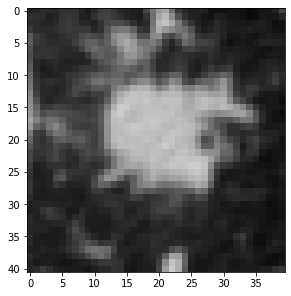

HCRP_LUSC_091_IMG0247.dcm (152, 129)


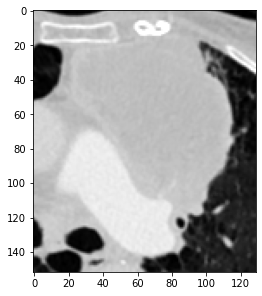

HCRP_LUSC_081_IMG0158.dcm (68, 72)


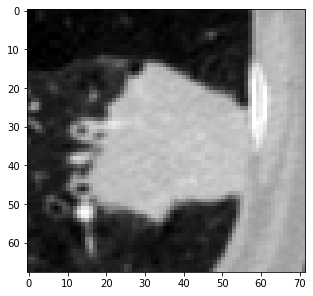

HCRP_LUSC_087_IMG0233.dcm (94, 75)


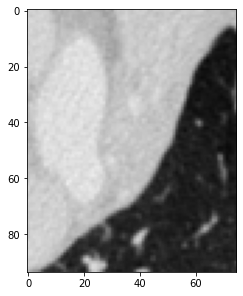

HCRP_LUSC_096_IMG0242.dcm (62, 67)


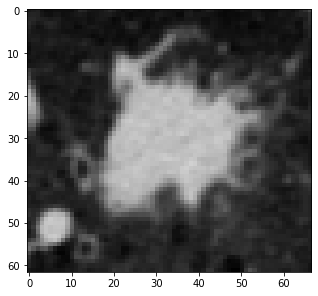

HCRP_LUSC_087_IMG0186.dcm (84, 77)


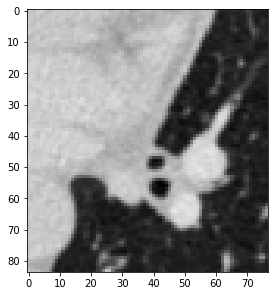

HCRP_LUSC_071_IMG0126.dcm (52, 47)


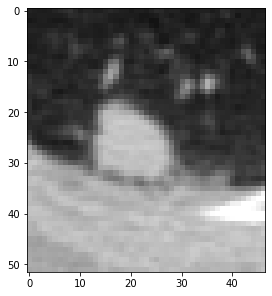

HCRP_LUSC_059_IMG0164.dcm (56, 62)


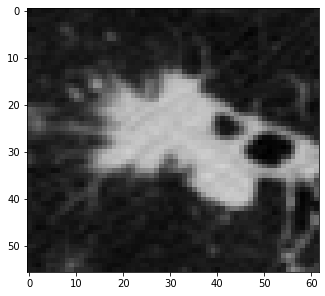

HCRP_LUSC_069_IMG0229.dcm (53, 74)


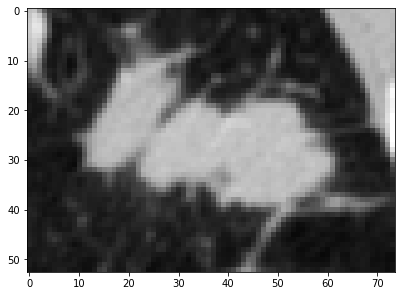

HCRP_LUSC_006_IMG0196.dcm (54, 54)


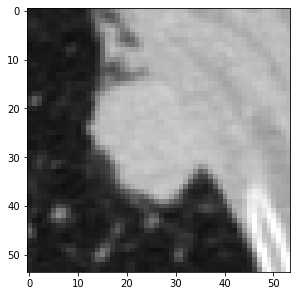

HCRP_LUSC_018_IMG0266.dcm (50, 44)


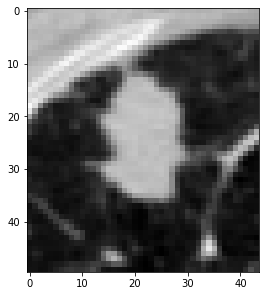

HCRP_LUSC_127_IMG0092.dcm (57, 64)


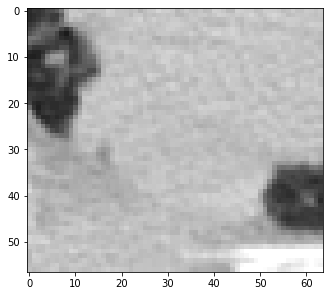

HCRP_LUSC_015_IMG0134.dcm (67, 69)


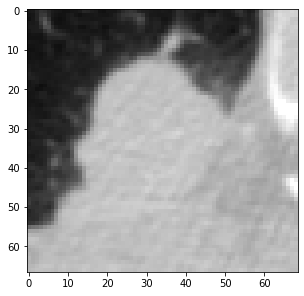

HCRP_LUSC_081_IMG0162.dcm (61, 67)


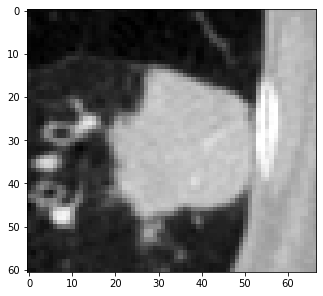

HCRP_LUSC_074_IMG0252.dcm (41, 42)


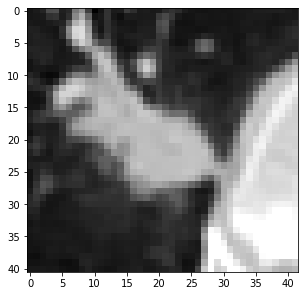

HCRP_LUSC_087_IMG0197.dcm (93, 104)


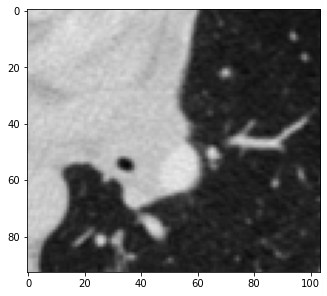

HCRP_LUSC_125_IMG0209.dcm (75, 77)


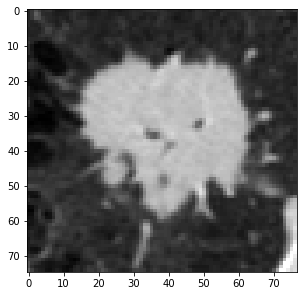

HCRP_LUSC_074_IMG0265.dcm (54, 48)


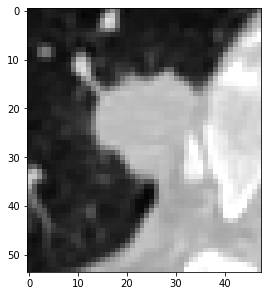

HCRP_LUSC_127_IMG0115.dcm (89, 84)


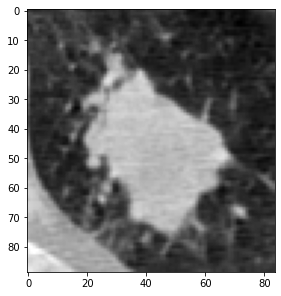

HCRP_LUSC_087_IMG0193.dcm (87, 83)


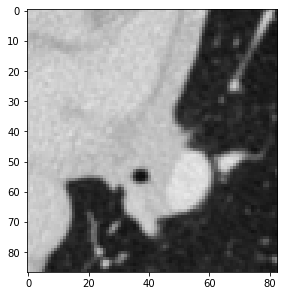

HCRP_LUSC_029_IMG0568.dcm (74, 68)


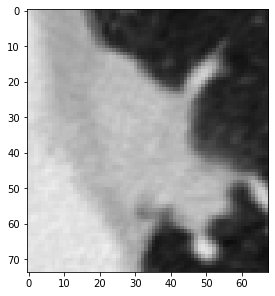

HCRP_LUSC_037_IMG0133.dcm (54, 52)


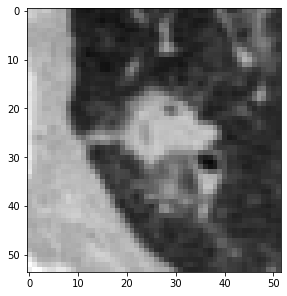

HCRP_LUSC_091_IMG0255.dcm (144, 146)


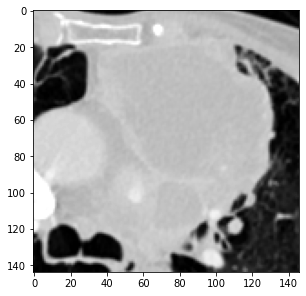

HCRP_LUSC_087_IMG0231.dcm (95, 72)


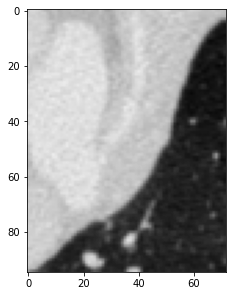

HCRP_LUSC_069_IMG0245.dcm (65, 58)


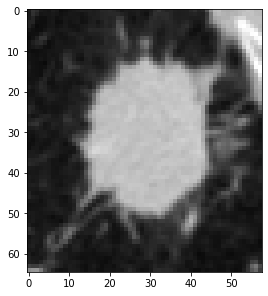

HCRP_LUSC_029_IMG0557.dcm (72, 56)


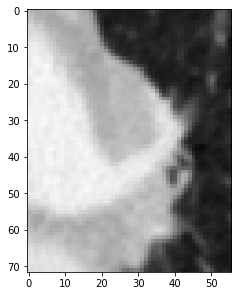

HCRP_LUSC_096_IMG0250.dcm (47, 52)


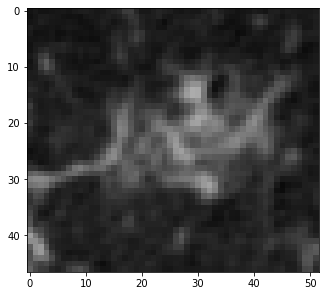

HCRP_LUSC_087_IMG0224.dcm (110, 72)


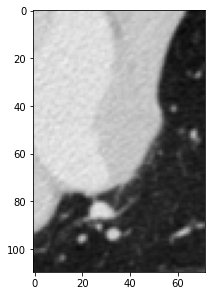

HCRP_LUSC_126_IMG0153.dcm (80, 58)


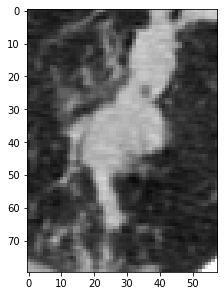

HCRP_LUSC_114_IMG0168.dcm (62, 74)


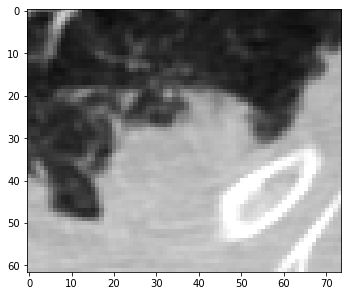

HCRP_LUSC_081_IMG0143.dcm (74, 74)


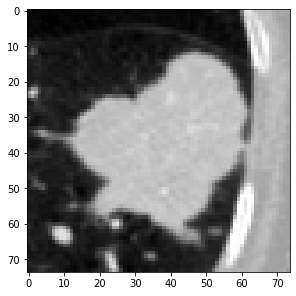

HCRP_LUSC_091_IMG0262.dcm (142, 143)


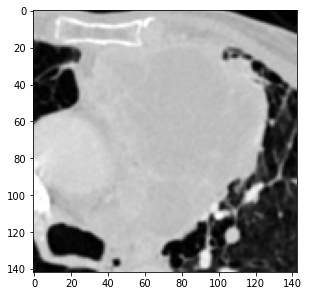

HCRP_LUSC_091_IMG0290.dcm (134, 104)


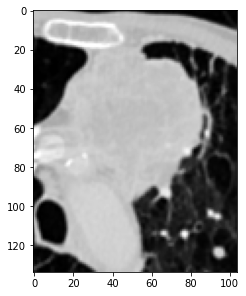

HCRP_LUSC_091_IMG0231.dcm (116, 111)


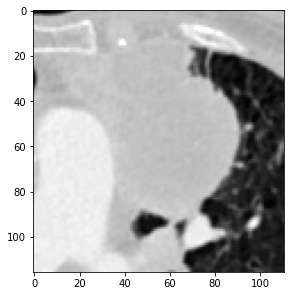

HCRP_LUSC_015_IMG0118.dcm (51, 54)


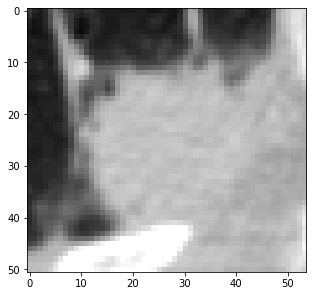

HCRP_LUSC_091_IMG0222.dcm (104, 74)


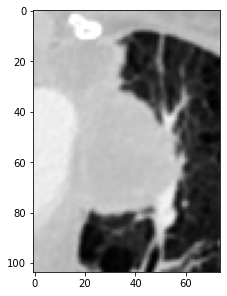

HCRP_LUSC_127_IMG0122.dcm (82, 71)


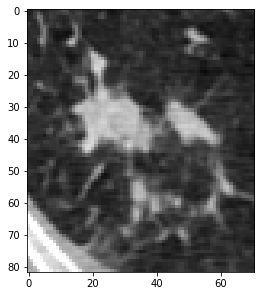

HCRP_LUSC_035_IMG0206.dcm (53, 56)


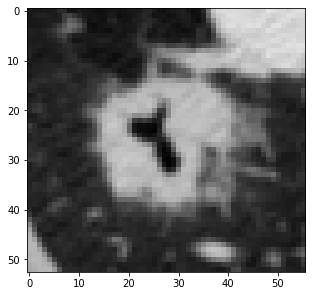

HCRP_LUSC_023_IMG0266.dcm (73, 58)


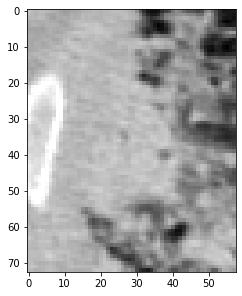

HCRP_LUSC_087_IMG0187.dcm (84, 78)


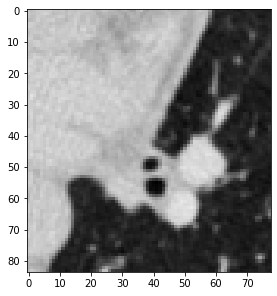

HCRP_LUSC_013_IMG0231.dcm (58, 56)


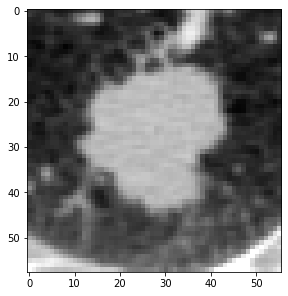

HCRP_LUSC_114_IMG0164.dcm (77, 99)


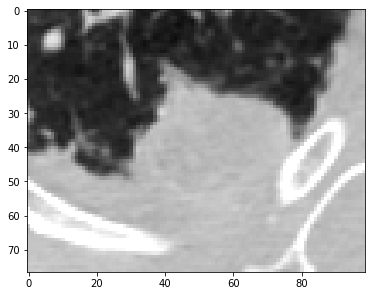

HCRP_LUSC_081_IMG0170.dcm (49, 42)


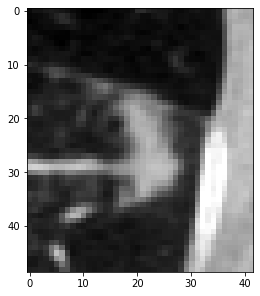

HCRP_LUSC_015_IMG0140.dcm (63, 65)


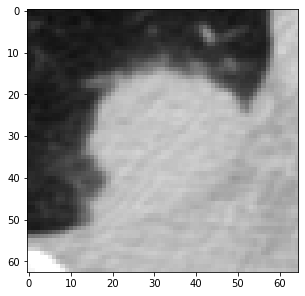

HCRP_LUSC_013_IMG0245.dcm (66, 71)


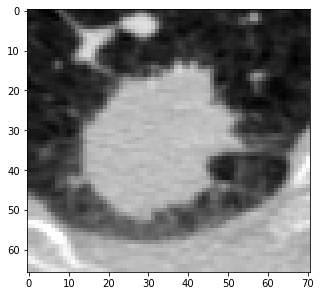

HCRP_LUSC_023_IMG0234.dcm (79, 90)


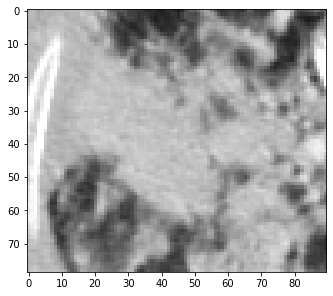

HCRP_LUSC_035_IMG0211.dcm (54, 46)


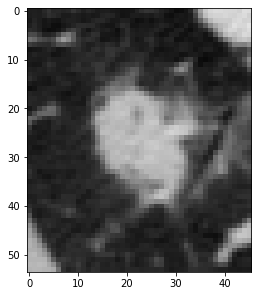

HCRP_LUSC_037_IMG0124.dcm (70, 69)


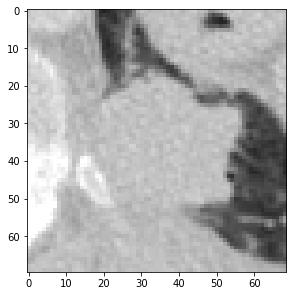

HCRP_LUSC_059_IMG0165.dcm (54, 60)


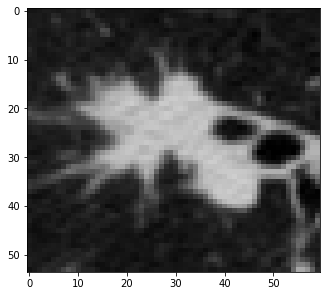

HCRP_LUSC_066_IMG0328.dcm (37, 42)


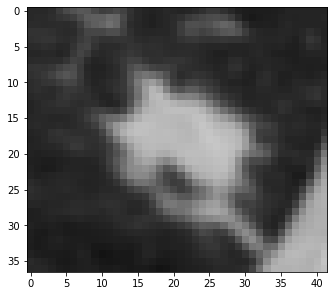

HCRP_LUSC_006_IMG0186.dcm (62, 67)


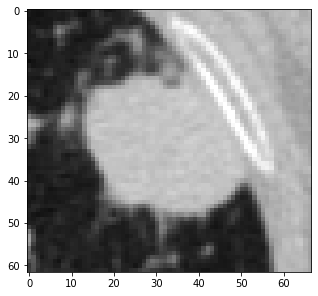

HCRP_LUSC_023_IMG0230.dcm (68, 77)


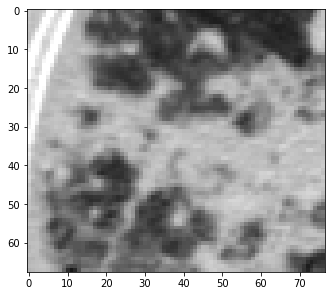

HCRP_LUSC_006_IMG0180.dcm (53, 60)


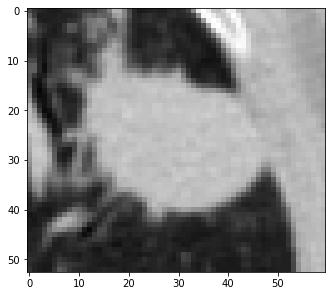

HCRP_LUSC_103_IMG0242.dcm (59, 57)


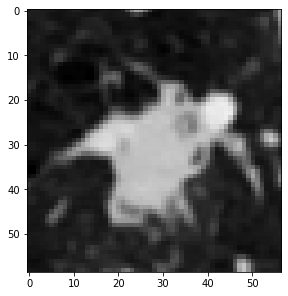

HCRP_LUSC_013_IMG0225.dcm (44, 42)


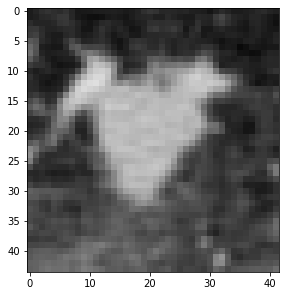

HCRP_LUSC_089_IMG0188.dcm (66, 60)


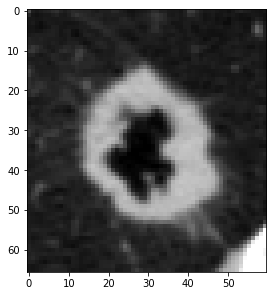

HCRP_LUSC_103_IMG0201.dcm (48, 49)


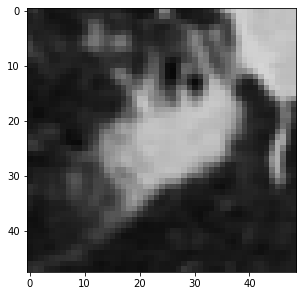

HCRP_LUSC_107_IMG0213.dcm (43, 36)


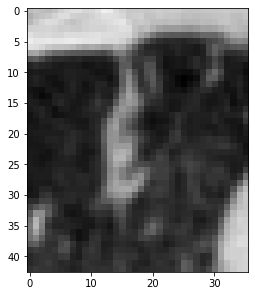

HCRP_LUSC_114_IMG0163.dcm (77, 97)


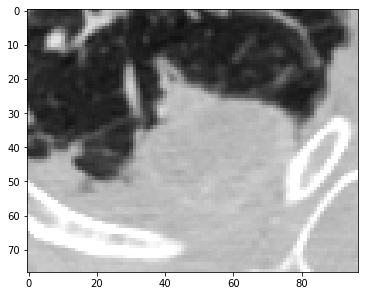

HCRP_LUSC_081_IMG0153.dcm (72, 74)


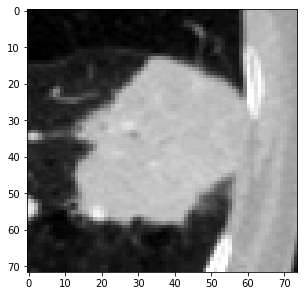

HCRP_LUSC_120_IMG0235.dcm (41, 42)


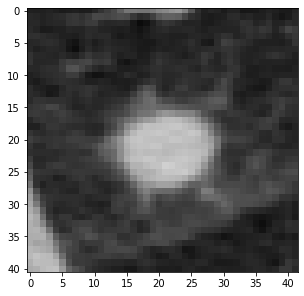

HCRP_LUSC_127_IMG0118.dcm (85, 76)


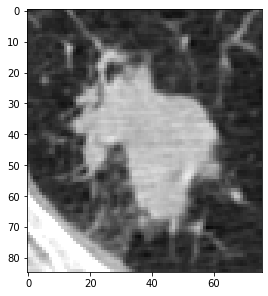

HCRP_LUSC_091_IMG0308.dcm (85, 62)


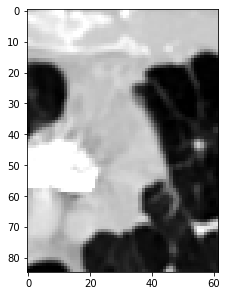

HCRP_LUSC_091_IMG0282.dcm (135, 120)


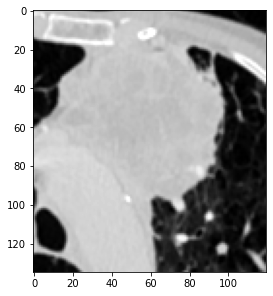

HCRP_LUSC_127_IMG0109.dcm (103, 83)


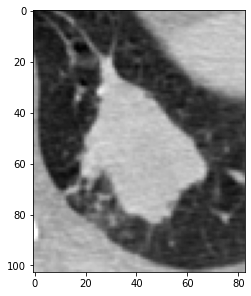

HCRP_LUSC_006_IMG0187.dcm (60, 65)


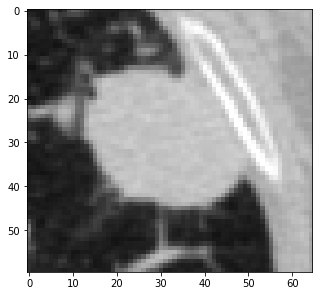

HCRP_LUSC_018_IMG0271.dcm (47, 43)


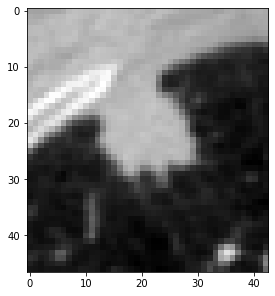

HCRP_LUSC_107_IMG0212.dcm (43, 41)


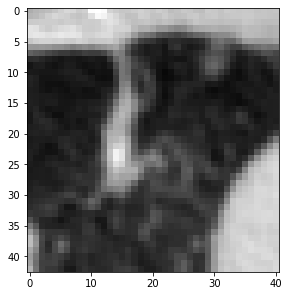

HCRP_LUSC_100_IMG0226.dcm (45, 40)


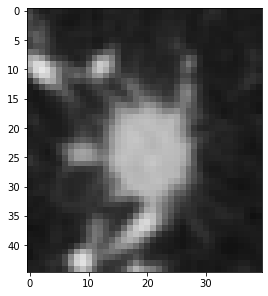

HCRP_LUSC_015_IMG0115.dcm (46, 45)


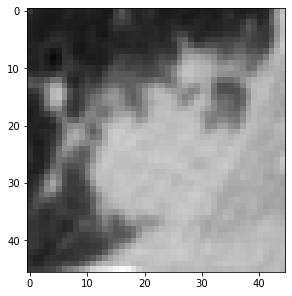

HCRP_LUSC_006_IMG0177.dcm (54, 56)


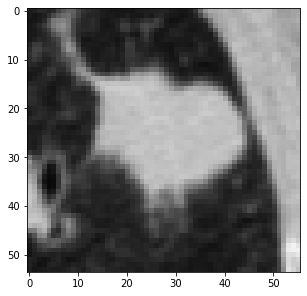

HCRP_LUSC_089_IMG0189.dcm (65, 59)


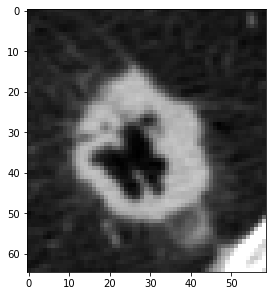

HCRP_LUSC_035_IMG0215.dcm (43, 46)


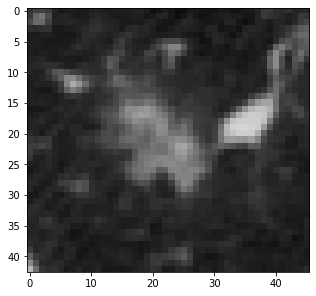

HCRP_LUSC_023_IMG0253.dcm (86, 80)


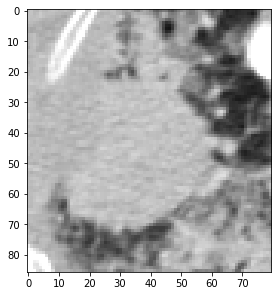

HCRP_LUSC_059_IMG0156.dcm (59, 58)


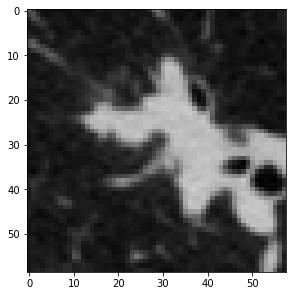

HCRP_LUSC_127_IMG0086.dcm (49, 54)


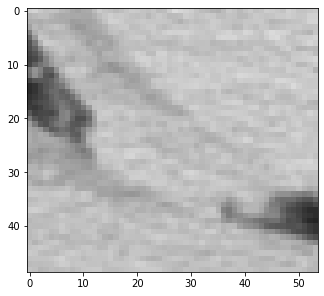

HCRP_LUSC_120_IMG0234.dcm (43, 39)


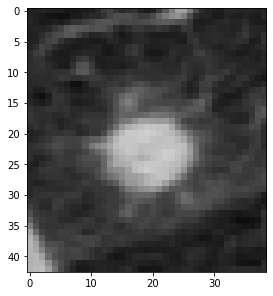

HCRP_LUSC_006_IMG0194.dcm (58, 57)


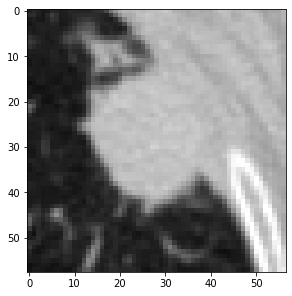

HCRP_LUSC_015_IMG0124.dcm (61, 64)


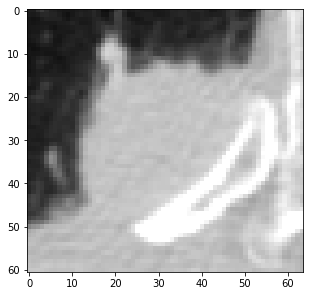

HCRP_LUSC_127_IMG0128.dcm (49, 41)


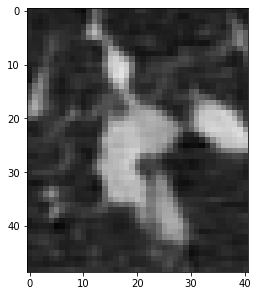

HCRP_LUSC_127_IMG0097.dcm (70, 83)


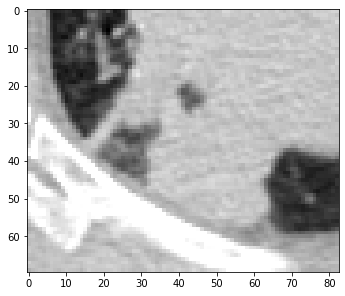

HCRP_LUSC_091_IMG0305.dcm (89, 81)


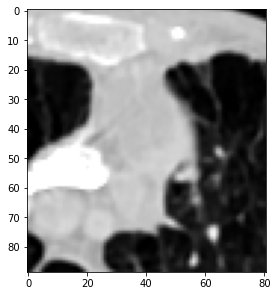

HCRP_LUSC_015_IMG0121.dcm (56, 58)


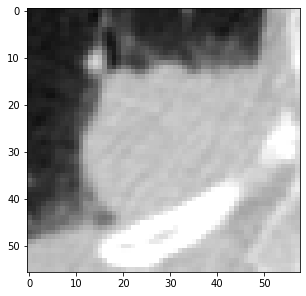

HCRP_LUSC_126_IMG0126.dcm (81, 78)


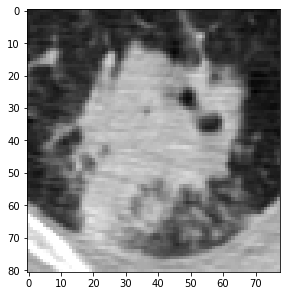

HCRP_LUSC_127_IMG0101.dcm (100, 90)


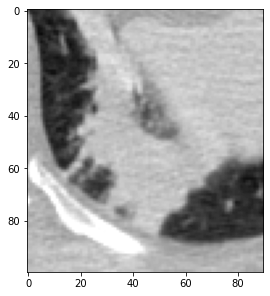

HCRP_LUSC_089_IMG0180.dcm (47, 48)


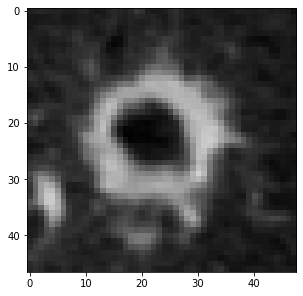

HCRP_LUSC_081_IMG0135.dcm (50, 65)


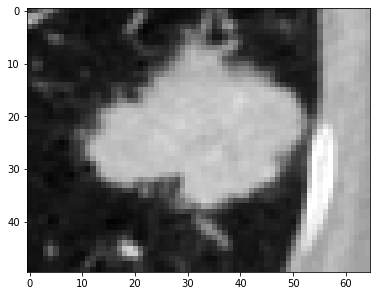

HCRP_LUSC_081_IMG0133.dcm (48, 58)


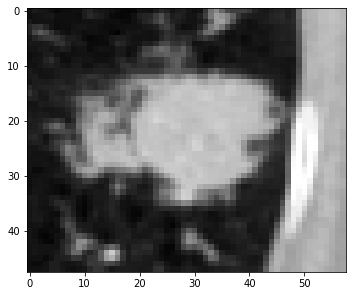

HCRP_LUSC_091_IMG0252.dcm (145, 135)


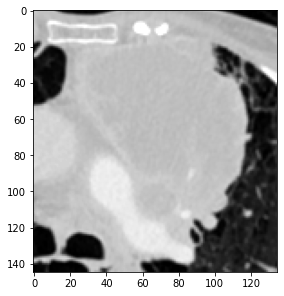

HCRP_LUSC_013_IMG0254.dcm (58, 58)


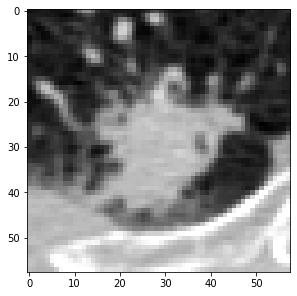

HCRP_LUSC_035_IMG0194.dcm (50, 57)


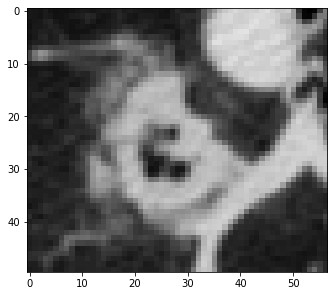

HCRP_LUSC_125_IMG0215.dcm (67, 73)


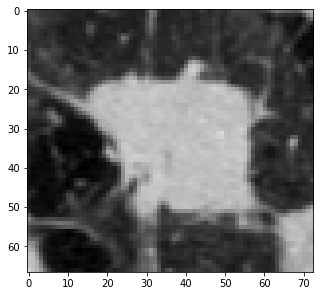

HCRP_LUSC_069_IMG0243.dcm (75, 70)


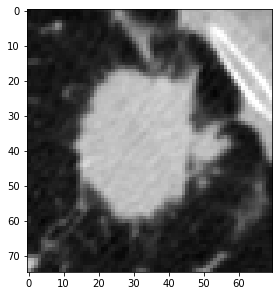

HCRP_LUSC_091_IMG0253.dcm (145, 134)


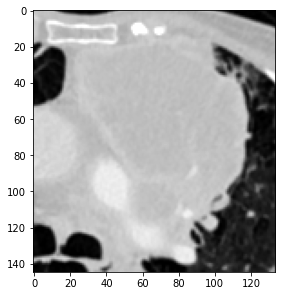

HCRP_LUSC_006_IMG0197.dcm (51, 52)


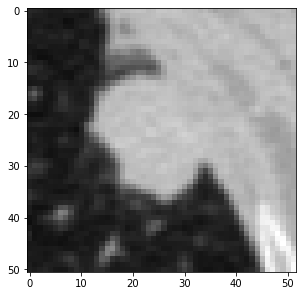

HCRP_LUSC_103_IMG0214.dcm (71, 96)


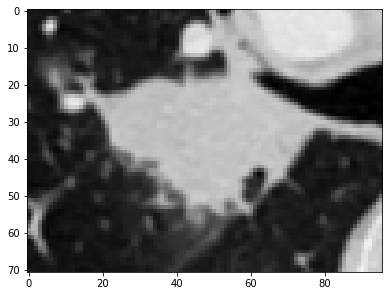

HCRP_LUSC_015_IMG0135.dcm (67, 70)


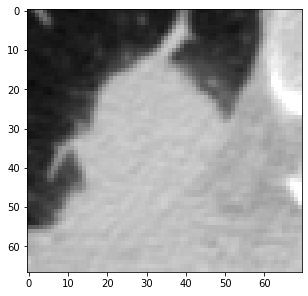

HCRP_LUSC_091_IMG0249.dcm (152, 137)


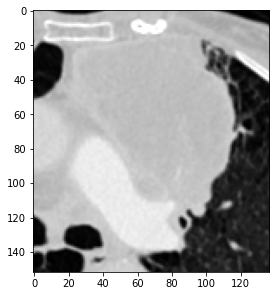

HCRP_LUSC_081_IMG0136.dcm (57, 68)


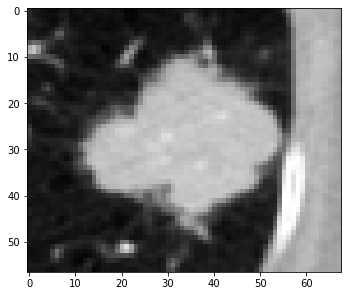

HCRP_LUSC_103_IMG0198.dcm (41, 42)


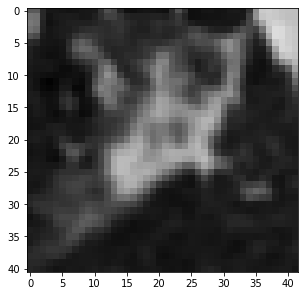

HCRP_LUSC_091_IMG0239.dcm (140, 113)


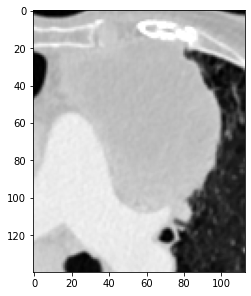

HCRP_LUSC_091_IMG0293.dcm (130, 96)


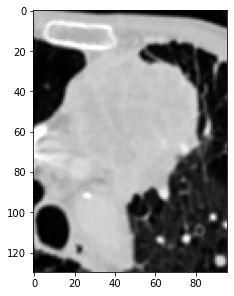

HCRP_LUSC_018_IMG0261.dcm (48, 39)


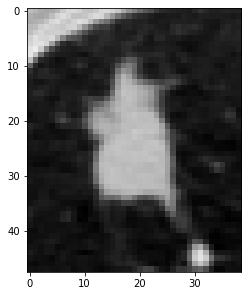

HCRP_LUSC_006_IMG0183.dcm (60, 66)


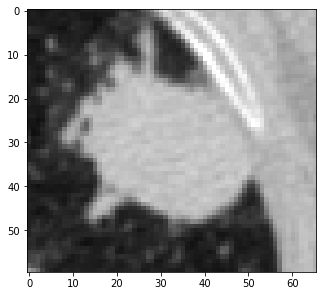

HCRP_LUSC_035_IMG0197.dcm (55, 62)


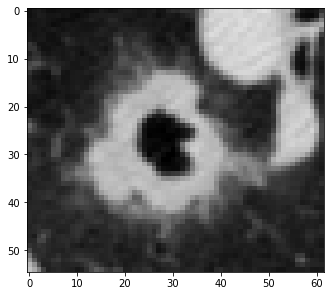

HCRP_LUSC_071_IMG0127.dcm (47, 40)


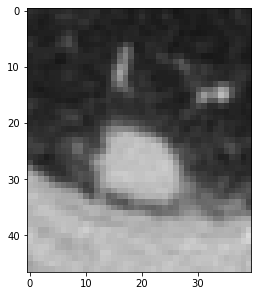

HCRP_LUSC_087_IMG0190.dcm (100, 82)


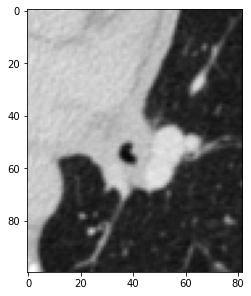

HCRP_LUSC_103_IMG0227.dcm (78, 77)


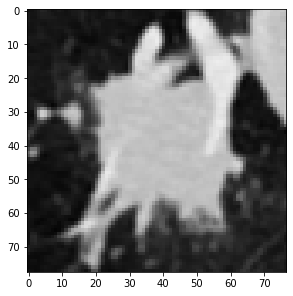

HCRP_LUSC_029_IMG0594.dcm (40, 53)


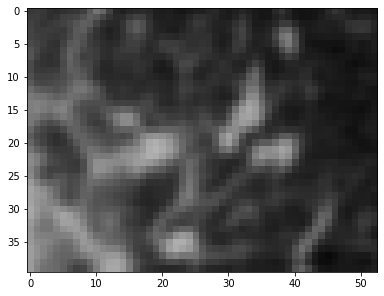

HCRP_LUSC_107_IMG0207.dcm (88, 71)


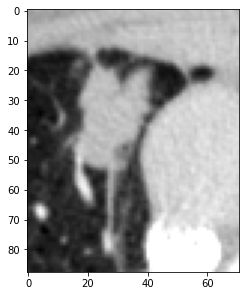

HCRP_LUSC_103_IMG0240.dcm (58, 62)


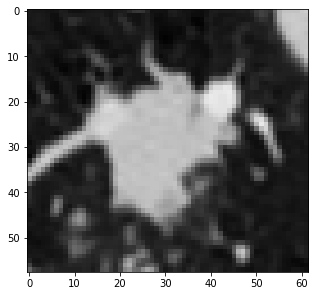

HCRP_LUSC_125_IMG0204.dcm (75, 77)


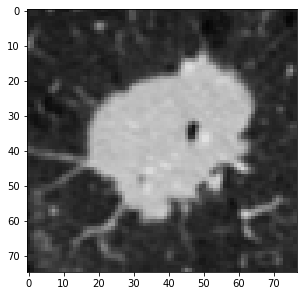

HCRP_LUSC_091_IMG0271.dcm (147, 126)


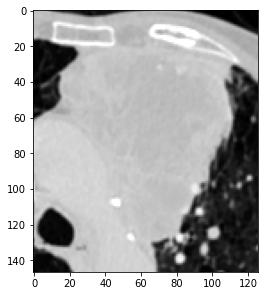

HCRP_LUSC_051_IMG0272.dcm (49, 54)


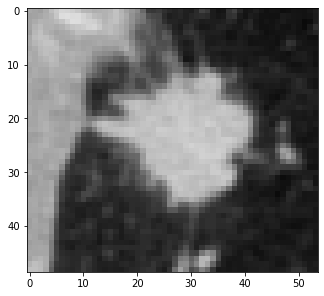

HCRP_LUSC_035_IMG0192.dcm (47, 50)


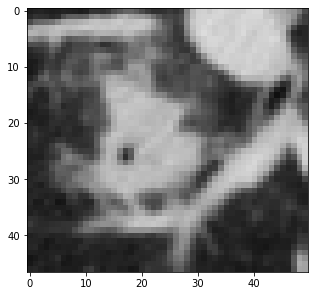

HCRP_LUSC_059_IMG0171.dcm (53, 57)


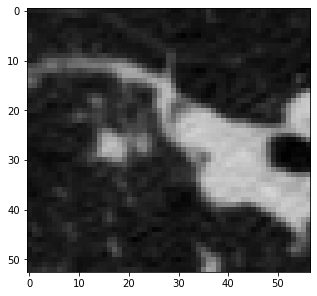

HCRP_LUSC_069_IMG0252.dcm (48, 54)


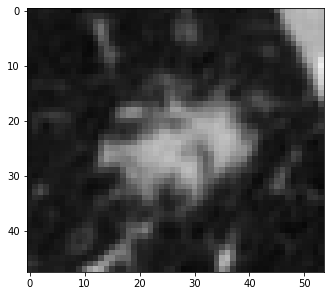

HCRP_LUSC_074_IMG0263.dcm (57, 48)


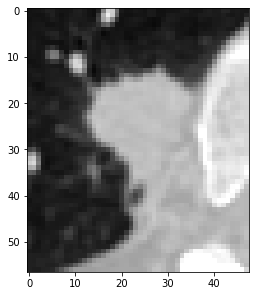

HCRP_LUSC_114_IMG0169.dcm (56, 72)


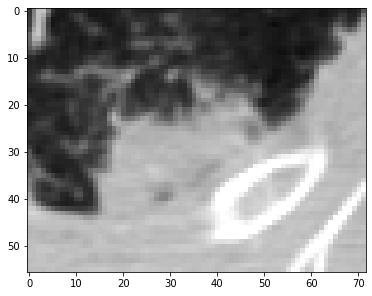

HCRP_LUSC_125_IMG0210.dcm (73, 76)


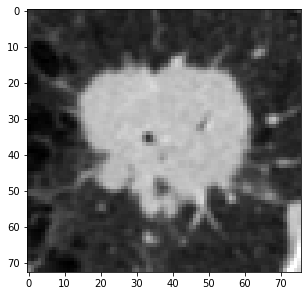

HCRP_LUSC_006_IMG0198.dcm (49, 49)


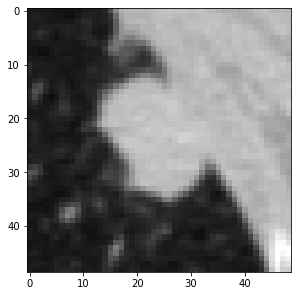

HCRP_LUSC_091_IMG0226.dcm (103, 79)


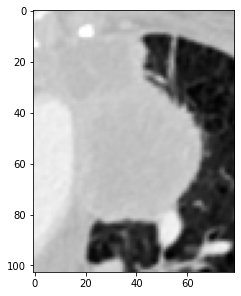

HCRP_LUSC_066_IMG0338.dcm (40, 46)


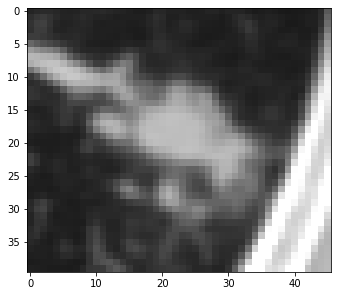

HCRP_LUSC_035_IMG0195.dcm (52, 56)


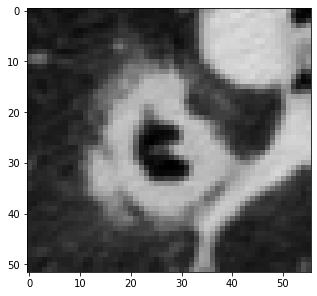

HCRP_LUSC_074_IMG0254.dcm (46, 49)


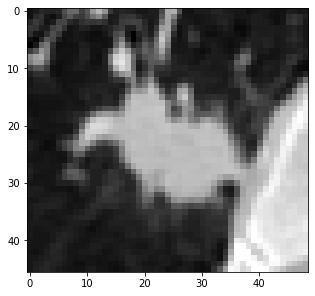

HCRP_LUSC_087_IMG0184.dcm (84, 82)


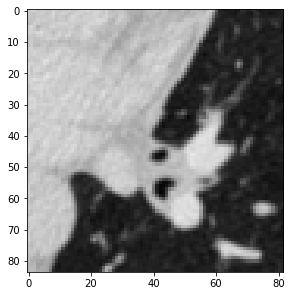

HCRP_LUSC_004_IMG0234.dcm (39, 45)


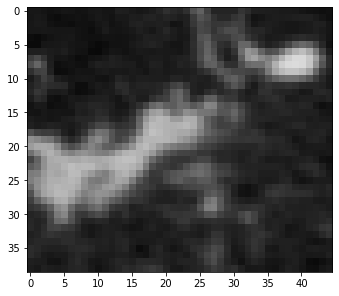

HCRP_LUSC_059_IMG0163.dcm (61, 65)


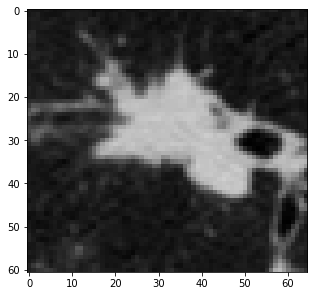

HCRP_LUSC_018_IMG0270.dcm (50, 44)


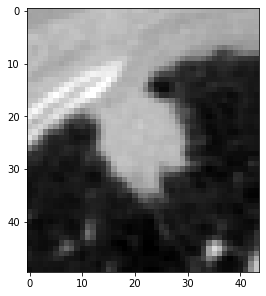

HCRP_LUSC_091_IMG0310.dcm (64, 52)


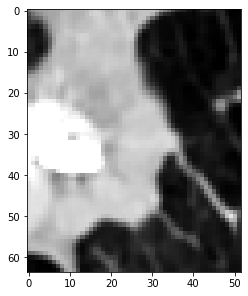

HCRP_LUSC_107_IMG0209.dcm (88, 51)


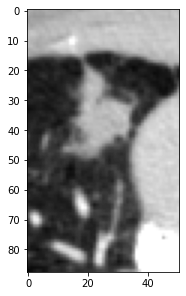

HCRP_LUSC_091_IMG0281.dcm (134, 120)


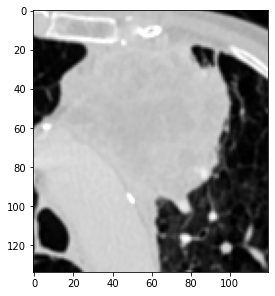

HCRP_LUSC_087_IMG0237.dcm (96, 77)


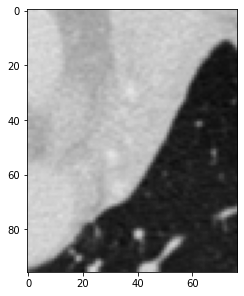

HCRP_LUSC_029_IMG0576.dcm (74, 72)


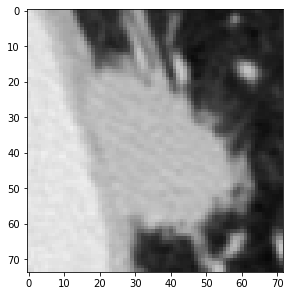

HCRP_LUSC_103_IMG0205.dcm (55, 64)


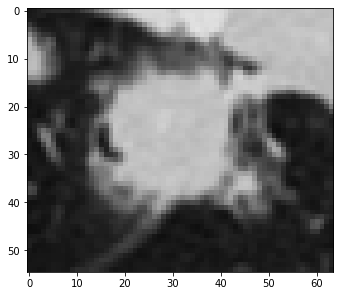

HCRP_LUSC_127_IMG0121.dcm (82, 72)


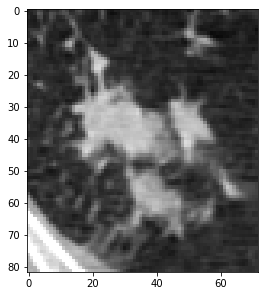

HCRP_LUSC_023_IMG0251.dcm (87, 80)


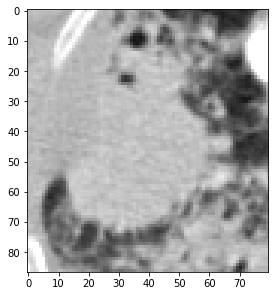

HCRP_LUSC_028_IMG0181.dcm (46, 40)


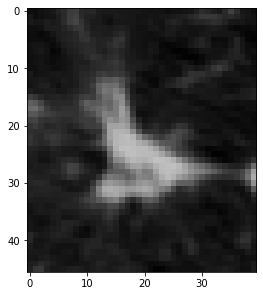

HCRP_LUSC_087_IMG0203.dcm (96, 83)


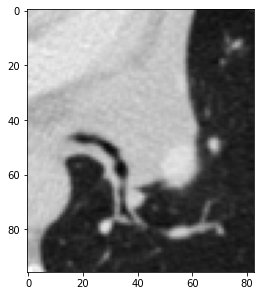

HCRP_LUSC_126_IMG0115.dcm (61, 50)


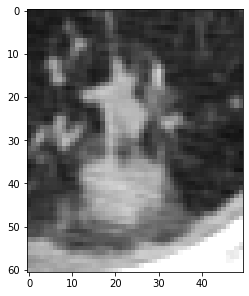

HCRP_LUSC_087_IMG0232.dcm (97, 75)


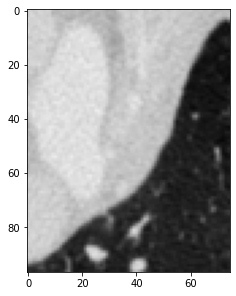

HCRP_LUSC_013_IMG0233.dcm (57, 59)


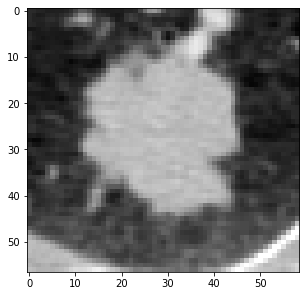

HCRP_LUSC_089_IMG0183.dcm (59, 53)


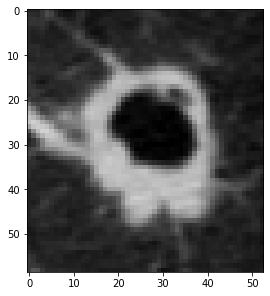

HCRP_LUSC_059_IMG0167.dcm (52, 67)


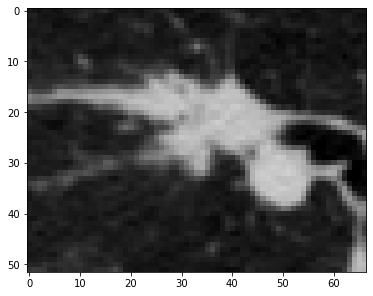

HCRP_LUSC_029_IMG0560.dcm (80, 59)


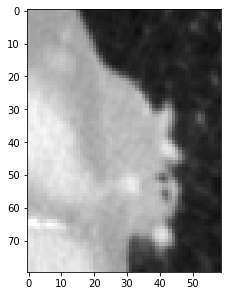

HCRP_LUSC_103_IMG0241.dcm (61, 58)


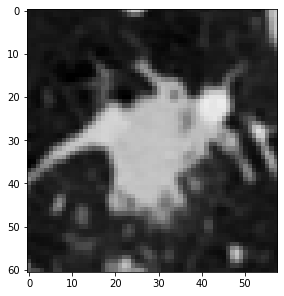

HCRP_LUSC_107_IMG0196.dcm (65, 65)


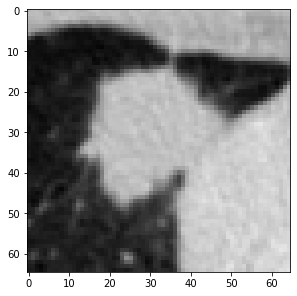

HCRP_LUSC_087_IMG0235.dcm (94, 78)


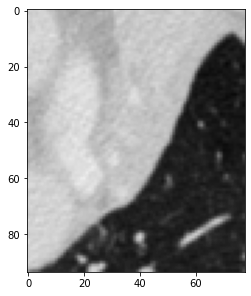

HCRP_LUSC_091_IMG0276.dcm (144, 126)


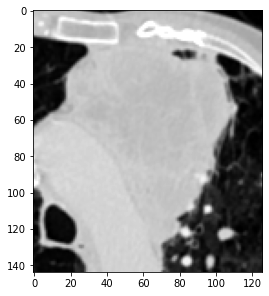

HCRP_LUSC_018_IMG0264.dcm (52, 44)


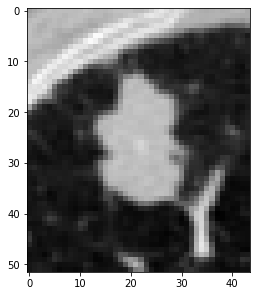

HCRP_LUSC_126_IMG0131.dcm (100, 90)


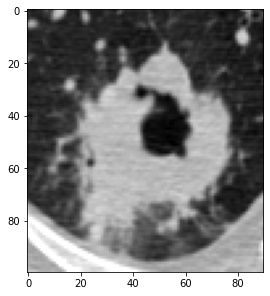

HCRP_LUSC_023_IMG0228.dcm (56, 72)


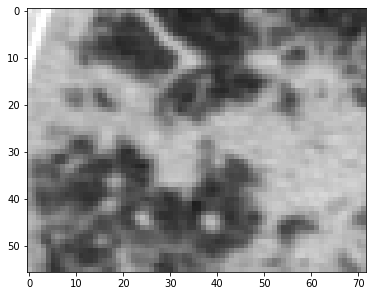

HCRP_LUSC_051_IMG0271.dcm (47, 48)


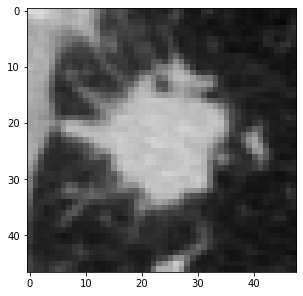

HCRP_LUSC_125_IMG0225.dcm (44, 54)


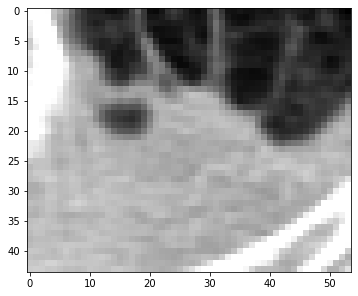

HCRP_LUSC_081_IMG0159.dcm (66, 70)


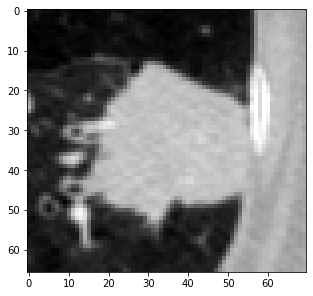

HCRP_LUSC_126_IMG0129.dcm (98, 82)


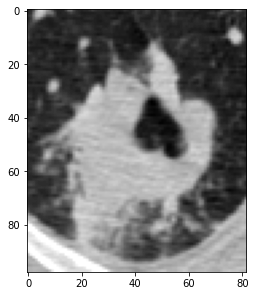

HCRP_LUSC_074_IMG0251.dcm (41, 39)


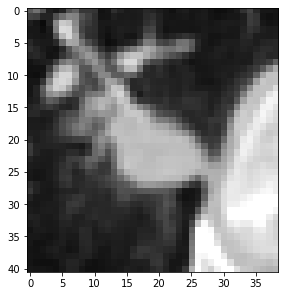

HCRP_LUSC_013_IMG0232.dcm (58, 58)


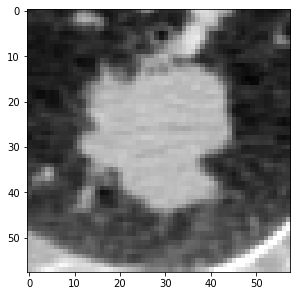

HCRP_LUSC_125_IMG0198.dcm (69, 66)


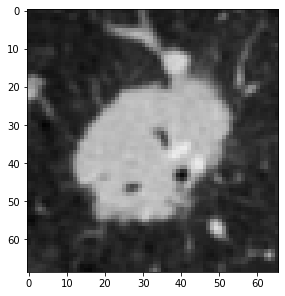

HCRP_LUSC_071_IMG0121.dcm (43, 55)


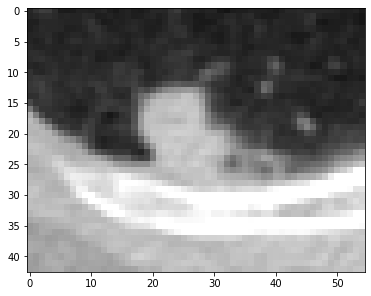

HCRP_LUSC_081_IMG0157.dcm (68, 71)


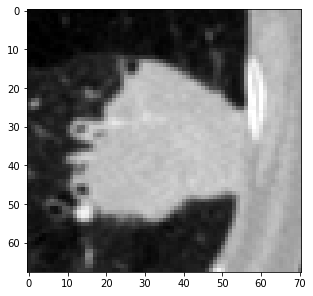

HCRP_LUSC_126_IMG0122.dcm (69, 77)


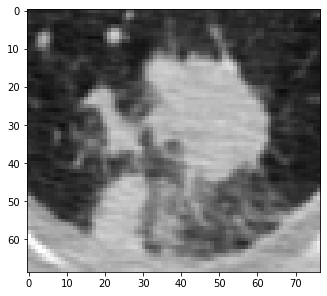

HCRP_LUSC_096_IMG0245.dcm (59, 62)


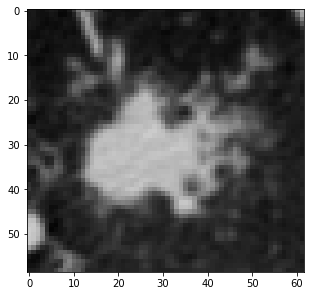

HCRP_LUSC_120_IMG0236.dcm (39, 42)


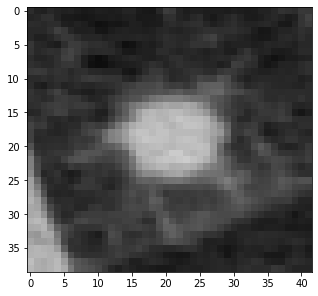

HCRP_LUSC_091_IMG0298.dcm (104, 93)


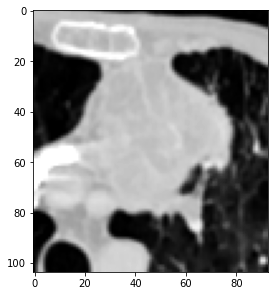

HCRP_LUSC_100_IMG0225.dcm (44, 41)


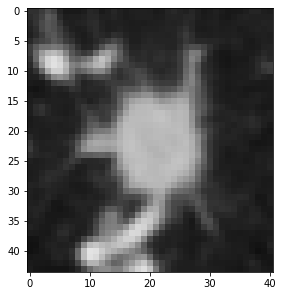

HCRP_LUSC_081_IMG0141.dcm (72, 72)


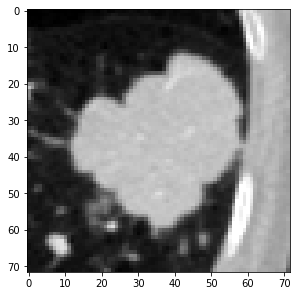

HCRP_LUSC_023_IMG0231.dcm (66, 80)


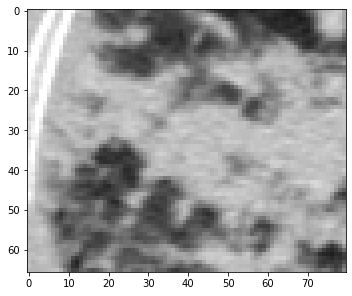

HCRP_LUSC_091_IMG0304.dcm (92, 84)


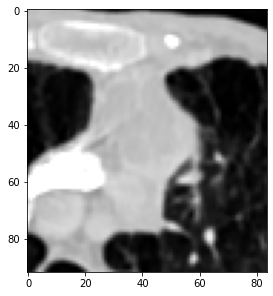

HCRP_LUSC_018_IMG0263.dcm (51, 43)


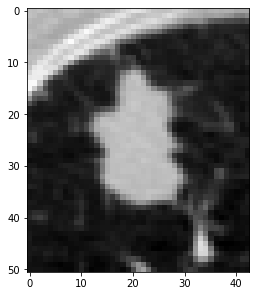

HCRP_LUSC_071_IMG0124.dcm (46, 46)


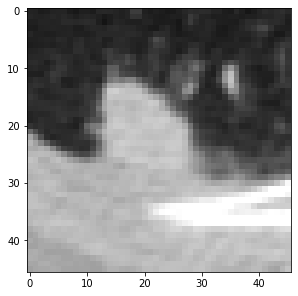

HCRP_LUSC_103_IMG0230.dcm (90, 73)


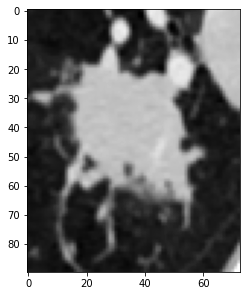

HCRP_LUSC_087_IMG0205.dcm (95, 81)


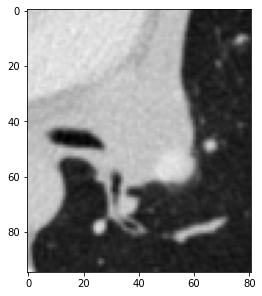

HCRP_LUSC_126_IMG0132.dcm (101, 92)


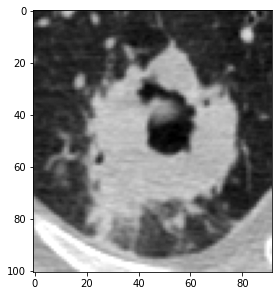

HCRP_LUSC_023_IMG0247.dcm (87, 82)


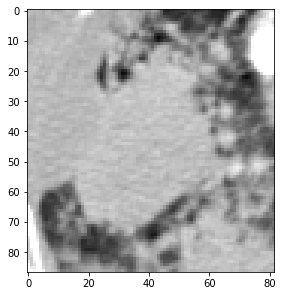

HCRP_LUSC_091_IMG0219.dcm (97, 69)


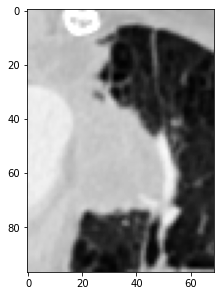

HCRP_LUSC_029_IMG0570.dcm (75, 68)


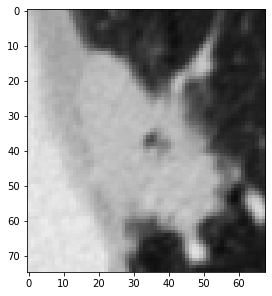

HCRP_LUSC_069_IMG0225.dcm (42, 41)


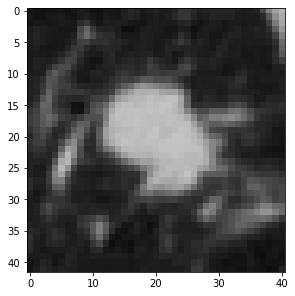

HCRP_LUSC_126_IMG0140.dcm (101, 83)


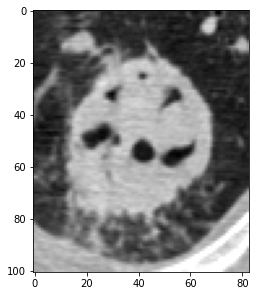

HCRP_LUSC_096_IMG0251.dcm (47, 47)


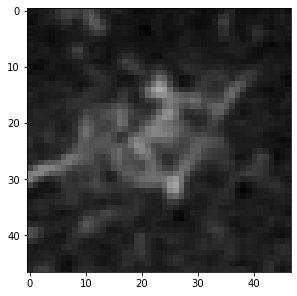

HCRP_LUSC_103_IMG0202.dcm (53, 53)


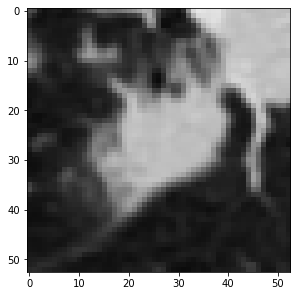

HCRP_LUSC_015_IMG0133.dcm (66, 69)


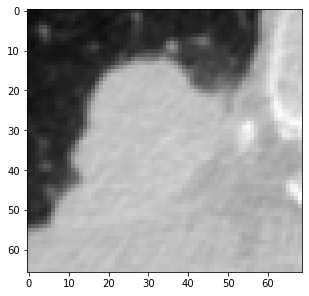

HCRP_LUSC_081_IMG0146.dcm (77, 78)


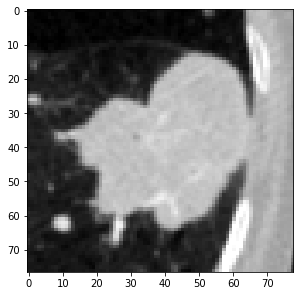

HCRP_LUSC_013_IMG0239.dcm (68, 74)


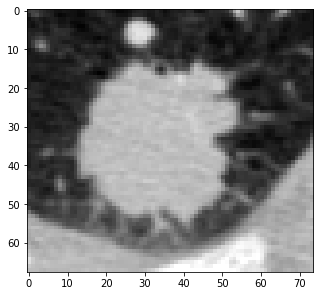

HCRP_LUSC_023_IMG0255.dcm (84, 76)


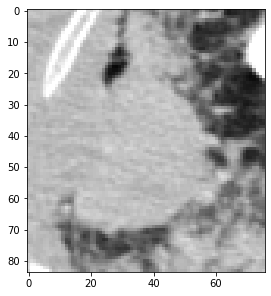

HCRP_LUSC_091_IMG0275.dcm (143, 127)


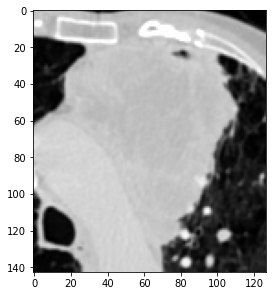

HCRP_LUSC_091_IMG0267.dcm (142, 140)


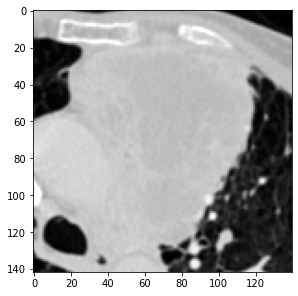

HCRP_LUSC_081_IMG0145.dcm (76, 77)


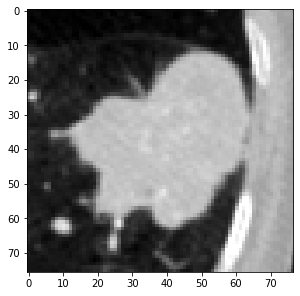

HCRP_LUSC_103_IMG0210.dcm (66, 82)


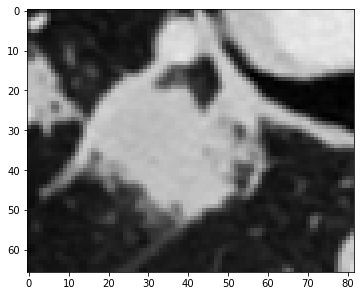

HCRP_LUSC_087_IMG0220.dcm (130, 74)


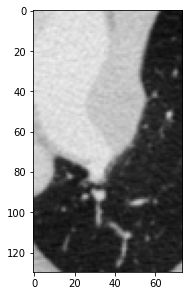

HCRP_LUSC_091_IMG0215.dcm (62, 41)


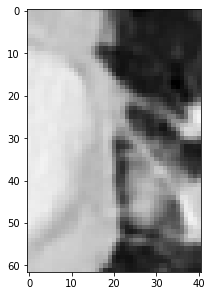

HCRP_LUSC_037_IMG0132.dcm (63, 55)


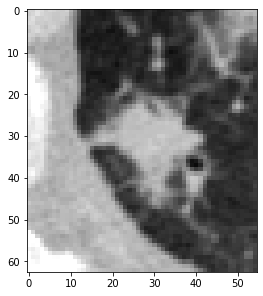

HCRP_LUSC_028_IMG0186.dcm (46, 43)


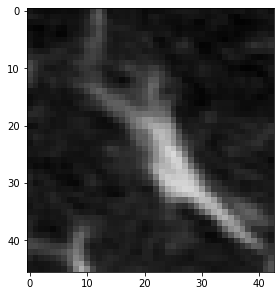

HCRP_LUSC_103_IMG0244.dcm (53, 55)


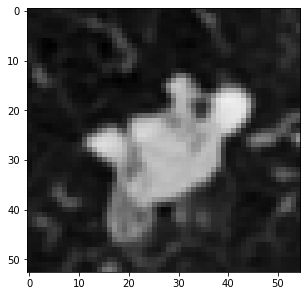

HCRP_LUSC_066_IMG0330.dcm (40, 44)


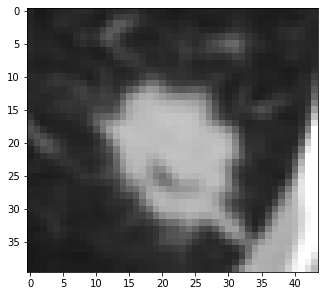

HCRP_LUSC_087_IMG0214.dcm (106, 82)


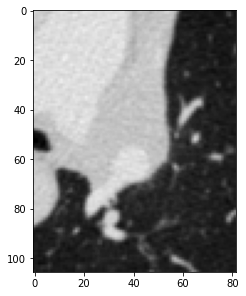

HCRP_LUSC_091_IMG0302.dcm (97, 88)


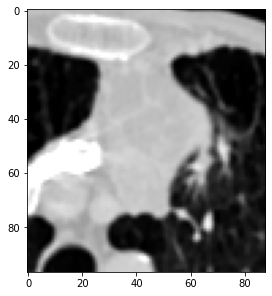

HCRP_LUSC_051_IMG0281.dcm (48, 49)


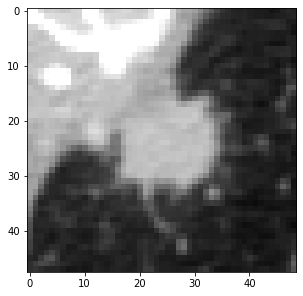

HCRP_LUSC_074_IMG0272.dcm (49, 39)


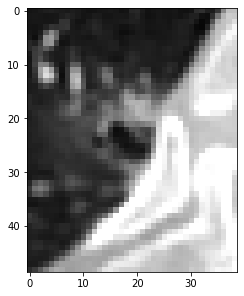

HCRP_LUSC_081_IMG0168.dcm (53, 50)


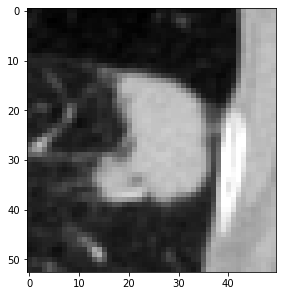

HCRP_LUSC_125_IMG0220.dcm (63, 60)


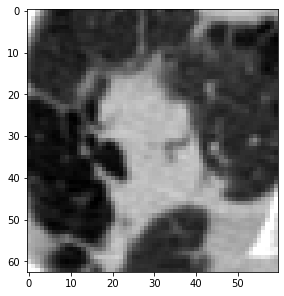

HCRP_LUSC_091_IMG0214.dcm (60, 33)


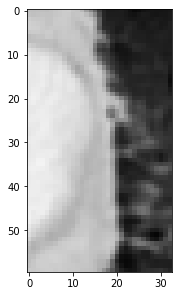

HCRP_LUSC_037_IMG0123.dcm (72, 71)


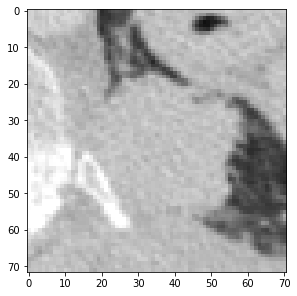

HCRP_LUSC_107_IMG0194.dcm (61, 57)


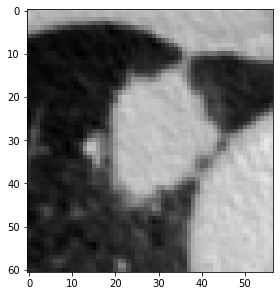

HCRP_LUSC_081_IMG0154.dcm (72, 73)


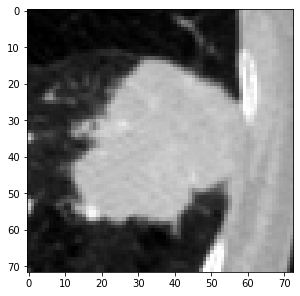

HCRP_LUSC_087_IMG0238.dcm (96, 78)


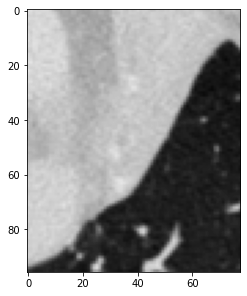

HCRP_LUSC_127_IMG0094.dcm (60, 70)


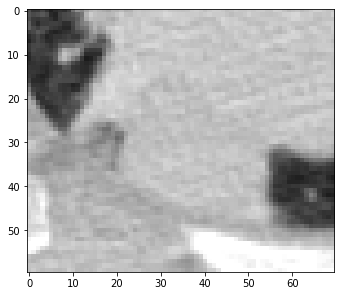

HCRP_LUSC_087_IMG0196.dcm (92, 106)


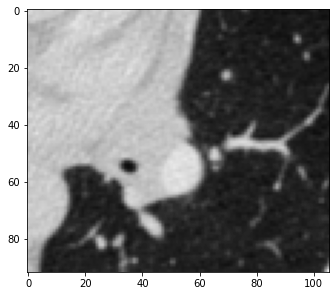

HCRP_LUSC_107_IMG0189.dcm (47, 50)


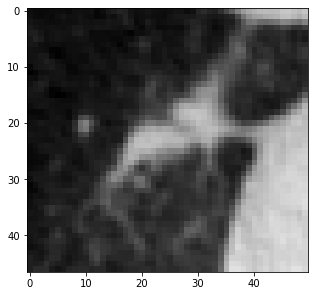

HCRP_LUSC_015_IMG0144.dcm (57, 60)


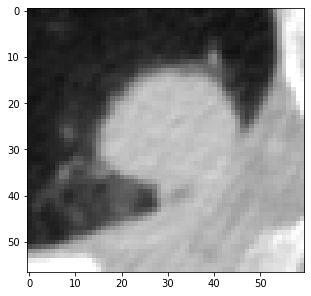

HCRP_LUSC_051_IMG0283.dcm (44, 45)


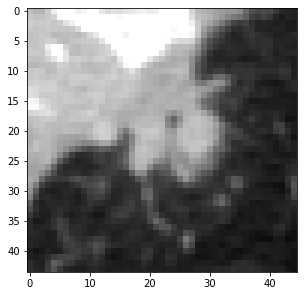

HCRP_LUSC_127_IMG0091.dcm (55, 63)


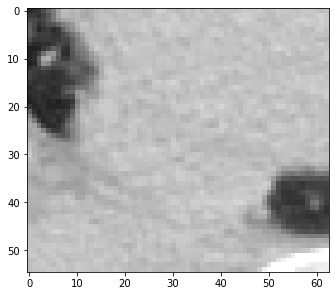

HCRP_LUSC_059_IMG0166.dcm (54, 65)


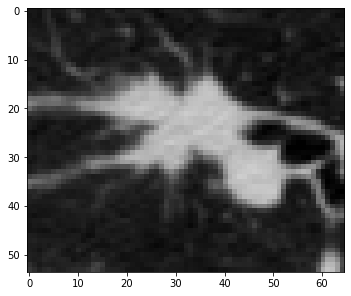

HCRP_LUSC_035_IMG0214.dcm (56, 49)


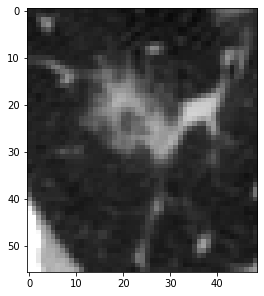

HCRP_LUSC_096_IMG0247.dcm (54, 59)


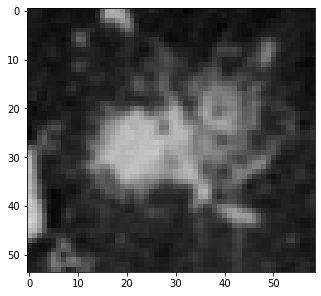

HCRP_LUSC_015_IMG0148.dcm (46, 48)


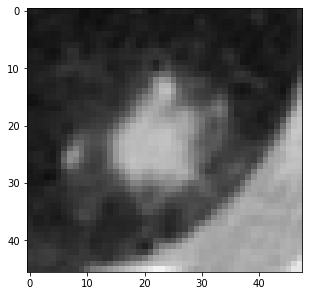

HCRP_LUSC_018_IMG0274.dcm (41, 40)


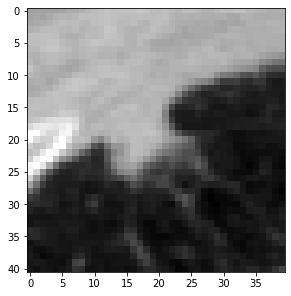

HCRP_LUSC_087_IMG0194.dcm (88, 85)


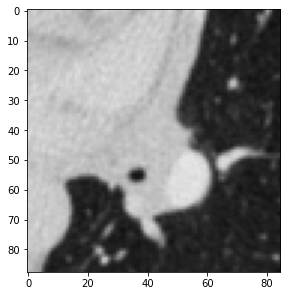

HCRP_LUSC_125_IMG0223.dcm (66, 52)


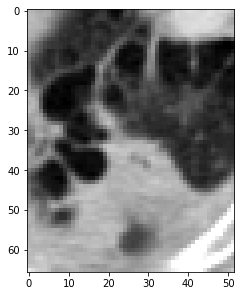

HCRP_LUSC_114_IMG0158.dcm (86, 87)


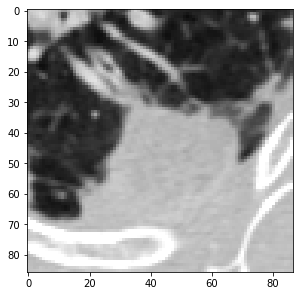

HCRP_LUSC_114_IMG0172.dcm (49, 64)


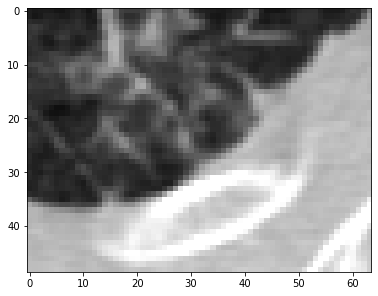

HCRP_LUSC_125_IMG0216.dcm (66, 78)


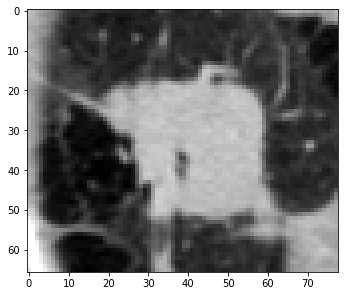

HCRP_LUSC_091_IMG0280.dcm (137, 121)


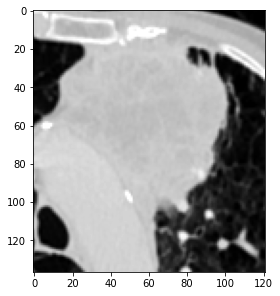

HCRP_LUSC_091_IMG0278.dcm (144, 121)


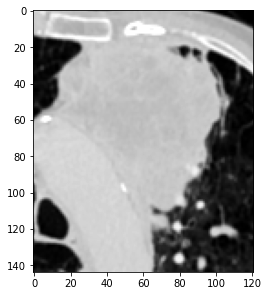

HCRP_LUSC_087_IMG0222.dcm (109, 76)


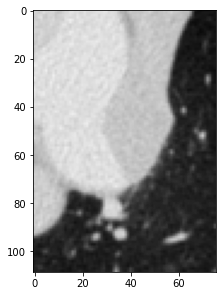

HCRP_LUSC_103_IMG0246.dcm (50, 56)


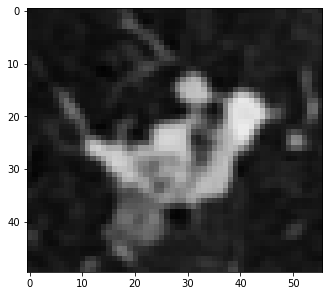

HCRP_LUSC_013_IMG0247.dcm (66, 66)


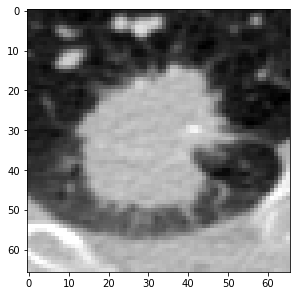

HCRP_LUSC_015_IMG0129.dcm (63, 65)


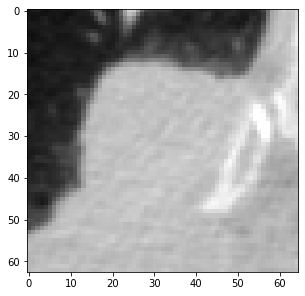

HCRP_LUSC_091_IMG0287.dcm (133, 108)


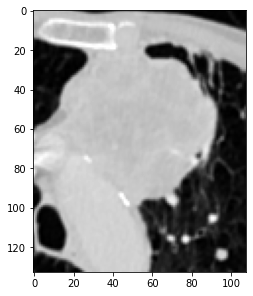

HCRP_LUSC_081_IMG0165.dcm (56, 58)


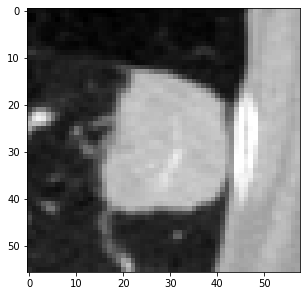

HCRP_LUSC_018_IMG0267.dcm (49, 42)


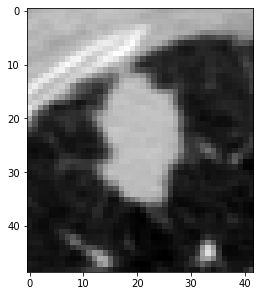

HCRP_LUSC_018_IMG0272.dcm (45, 43)


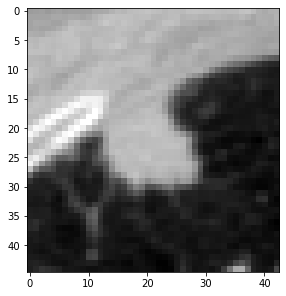

HCRP_LUSC_074_IMG0256.dcm (53, 51)


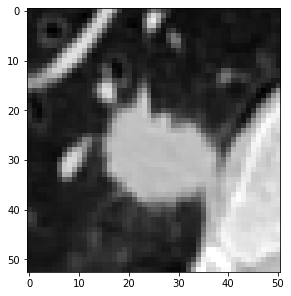

HCRP_LUSC_015_IMG0116.dcm (48, 51)


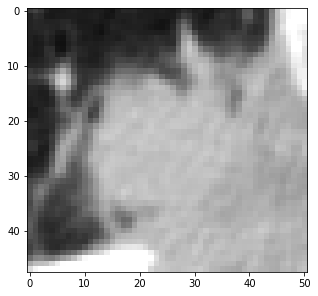

HCRP_LUSC_006_IMG0179.dcm (52, 58)


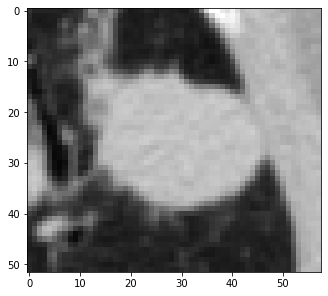

HCRP_LUSC_125_IMG0222.dcm (67, 54)


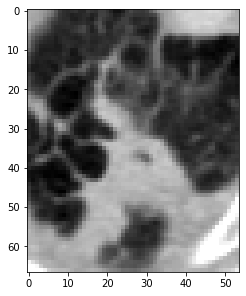

HCRP_LUSC_013_IMG0235.dcm (62, 61)


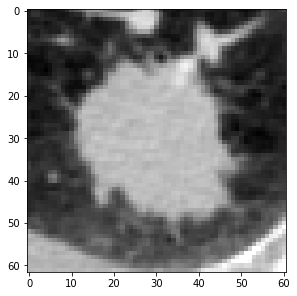

HCRP_LUSC_069_IMG0235.dcm (66, 82)


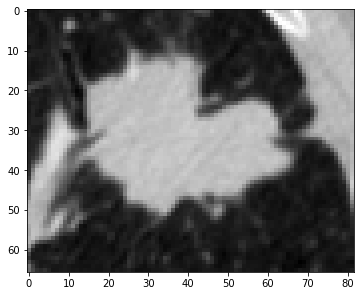

HCRP_LUSC_103_IMG0245.dcm (52, 54)


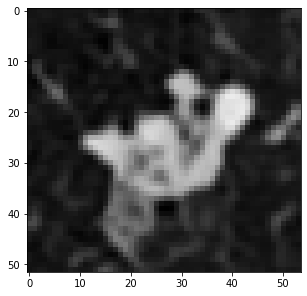

HCRP_LUSC_091_IMG0221.dcm (102, 72)


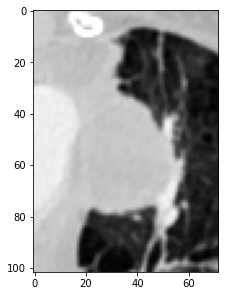

HCRP_LUSC_069_IMG0242.dcm (76, 71)


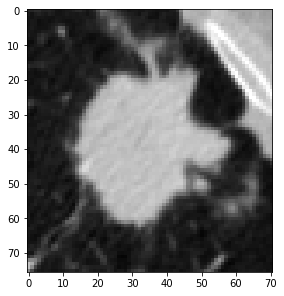

HCRP_LUSC_094_IMG0261.dcm (38, 39)


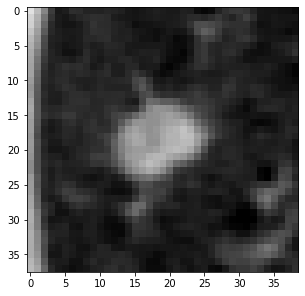

HCRP_LUSC_114_IMG0151.dcm (58, 73)


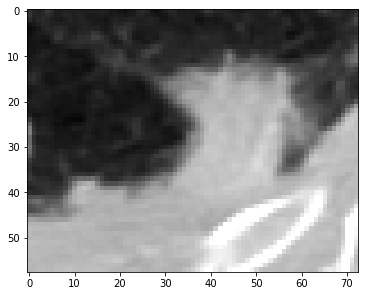

In [31]:
gan_dir = "/Storage/PauloOctavioDir/nodule_rois/gan/squamous/images/"
for f in os.listdir(gan_dir):
    if 'HCRP' in f:
        file = gan_dir + f
        image = get_hu_image_windowed(file)
        vmin = 0
        vmax = 1
        print(f, image.shape)
        plt.imshow(image, vmin=vmin, vmax=vmax, cmap='gray')
        plt.show()

In [ ]:
HCRP_EXAMS_DIR = "/Storage/PauloOctavioDir/Exames/"
exams_without_seg = ['101', '102', '104']
for exam_id in sorted(os.listdir(HCRP_EXAMS_DIR)):
    if exam_id not in exams_without_seg:
        images_dir = f"/Storage/PauloOctavioDir/Exames/{exam_id}/dicomRT/Original-dcm"
        masks_dir = f"/Storage/PauloOctavioDir/Exames/{exam_id}/Segmentado/dcm"
        for mask in os.listdir(masks_dir):
            image = re.sub("\d+", mask, str(int(re.findall("\d+", mask)[0]) - 1).zfill(4))

            mask_path = masks_dir + '/' + mask
            image_path = images_dir + '/' + image

            mask_data = dcmread(mask_path).pixel_array
            image = get_hu_image_windowed(file)
            if mask_data.any():
                plt.
                plt.imshow(image)
                plt.show()

,model_name,no_gan_generated_images,avg_acc,auc,avg_precision,avg_recall,avg_f1-score,batch_size,learning_rate,epoch,optimizer,dropout,seed,gan_model,fpr,tpr,threshold,training_duration
73,vgg16_gan_5000_old_gan_s_42,5000,0.936012,0.935940,0.931078,0.935940,0.933321,32.0,0.001,75.0,SGD,0.5,42.0,old_gan,NaN,NaN,NaN,NaN
74,vgg16_gan_0_gan_augmented_rot_blur_sharp_s_42,0,0.906250,0.908757,0.899184,0.908757,0.903000,32.0,0.001,75.0,SGD,0.5,42.0,gan_augmented_rot_blur_sharp,NaN,NaN,NaN,NaN
75,vgg16_gan_1000_gan_augmented_rot_blur_sharp_s_42,1000,0.918155,0.918561,0.912046,0.918561,0.914922,32.0,0.001,75.0,SGD,0.5,42.0,gan_augmented_rot_blur_sharp,NaN,NaN,NaN,NaN
76,vgg16_gan_2000_gan_augmented_rot_blur_sharp_s_42,2000,0.913690,0.912879,0.907805,0.912879,0.910117,32.0,0.001,75.0,SGD,0.5,42.0,gan_augmented_rot_blur_sharp,NaN,NaN,NaN,NaN
77,vgg16_gan_3000_gan_augmented_rot_blur_sharp_s_42,3000,0.910714,0.910428,0.904480,0.910428,0.907131,32.0,0.001,75.0,SGD,0.5,42.0,gan_augmented_rot_blur_sharp,NaN,NaN,NaN,NaN
78,vgg16_gan_4000_gan_augmented_rot_blur_sharp_s_42,4000,0.925595,0.928699,0.919050,0.928699,0.922973,32.0,0.001,75.0,SGD,0.5,42.0,gan_augmented_rot_blur_sharp,NaN,NaN,NaN,NaN
79,vgg16_gan_5000_gan_augmented_rot_blur_sharp_s_42,5000,0.904762,0.903520,0.898562,0.903520,0.900818,32.0,0.001,75.0,SGD,0.5,42.0,gan_augmented_rot_blur_sharp,NaN,NaN,NaN,NaN
80,vgg16_gan_augmented_all_0_old_gan_s_42,0,0.700893,0.664773,0.688554,0.664773,0.668862,32.0,0.001,75.0,SGD,0.5,42.0,old_gan,NaN,NaN,NaN,NaN
81,vgg16_gan_augmented_no_blur_0_old_gan_s_42,0,0.645833,0.639483,0.634991,0.639483,0.635714,32.0,0.001,75.0,SGD,0.5,42.0,old_gan,NaN,NaN,NaN,NaN
82,vgg16_gan_augmented_affine_only_0_old_gan_s_42,0,0.901786,0.901070,0.895257,0.901070,0.897844,32.0,0.001,75.0,SGD,0.5,42.0,old_gan,NaN,NaN,NaN,NaN


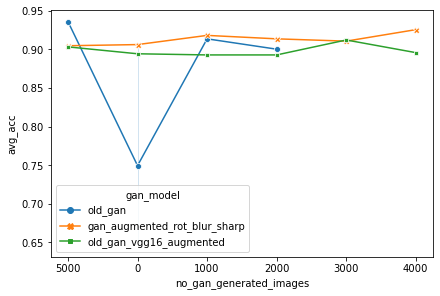

In [8]:
df = pd.read_csv('vgg16_logging.csv')
df['no_gan_generated_images'] = df['no_gan_generated_images'].astype(str)
df = df.loc[np.r_[73:85, 87:93], :]
df.loc[87:93, 'gan_model'] = 'old_gan_vgg16_augmented'
display(df)

sns.lineplot(x='no_gan_generated_images', y='avg_acc', hue='gan_model', data=df, style="gan_model", markers=True, dashes=False)

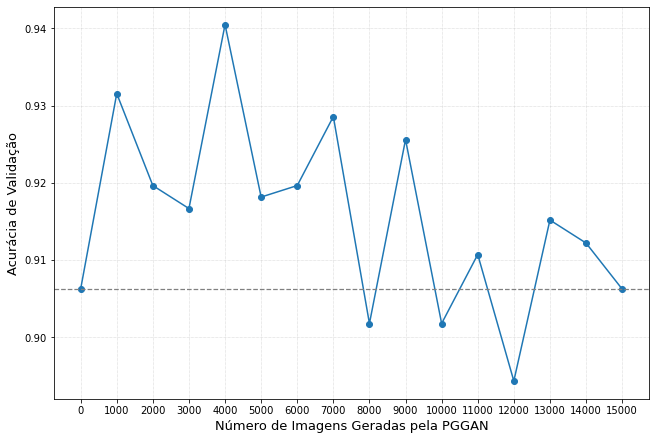

In [17]:
df = pd.read_csv('vgg16_logging.csv')
df['no_gan_generated_images'] = df['no_gan_generated_images'].astype(str)
df = df[df['model_name'].str.contains('best_gans')]
fig,ax = plt.subplots(figsize=(9, 6))
plt.plot(df['no_gan_generated_images'], df['avg_acc'], marker='o')
# plt.title("Curva ROC", fontsize=14)
plt.xlabel("Número de Imagens Geradas pela PGGAN", fontsize=13)
plt.ylabel("Acurácia de Validação", fontsize=13)
plt.grid(linestyle=':', linewidth=.5)
plt.axhline(y = 0.906250, color = 'gray', linestyle='--', linewidth=1.25)
plt.savefig('plots/acc_vs_no_gan_generated_images.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

In [8]:
df = pd.read_csv('vgg16_logging.csv')
df['no_gan_generated_images'] = df['no_gan_generated_images'].astype(str)
df = df[df['model_name'].str.contains('best_gans')]
df[['no_gan_generated_images','avg_acc','auc','avg_precision','avg_recall','avg_f1-score']].round(3)

,no_gan_generated_images,avg_acc,auc,avg_precision,avg_recall,avg_f1-score
126,0,0.906,0.909,0.899,0.909,0.903
127,1000,0.932,0.932,0.926,0.932,0.929
128,2000,0.920,0.916,0.916,0.916,0.916
129,3000,0.917,0.917,0.911,0.917,0.913
130,4000,0.940,0.940,0.936,0.940,0.938
131,5000,0.918,0.915,0.914,0.915,0.914
135,6000,0.920,0.926,0.913,0.926,0.917
136,7000,0.929,0.928,0.924,0.928,0.926
137,8000,0.902,0.901,0.895,0.901,0.898
138,9000,0.926,0.926,0.920,0.926,0.923


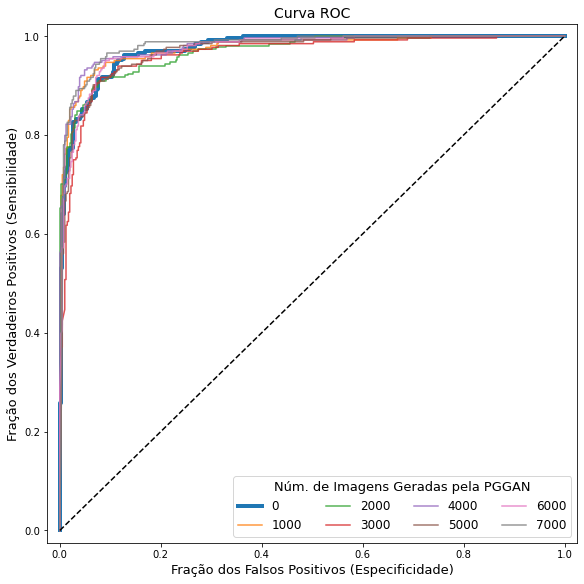

In [164]:
fig,ax = plt.subplots(figsize=(8, 8))
df = df[:8]
for _, row in df.iterrows():
    
    fpr = row['fpr'].replace('\n','').replace('0.',',0.').replace('1.',',1.').replace("[,",'').replace("]",'').split(',')
    fpr = np.array(fpr, dtype=np.float32)

    tpr = row['tpr'].replace('\n','').replace('0.',',0.').replace('1.',',1.').replace("[,",'').replace("]",'').split(',')
    tpr = np.array(tpr, dtype=np.float32)
    if row['no_gan_generated_images'] == '0':
        ax.plot(fpr, tpr, label=row['no_gan_generated_images'], lw=4)
    else:
        ax.plot(fpr, tpr, label=row['no_gan_generated_images'], alpha=.8)
#     ax.annotate(txt_box, xy=(0.65, 0.05), xycoords='axes fraction')
ax.plot([0, 1], [0, 1],'--', color='k')
plt.title("Curva ROC", fontsize=14)
plt.xlabel("Fração dos Falsos Positivos (Especificidade)", fontsize=13)
plt.ylabel("Fração dos Verdadeiros Positivos (Sensibilidade)", fontsize=13)
plt.legend(loc='best', title='Núm. de Imagens Geradas pela PGGAN', fontsize=12, title_fontsize=13, ncol=4)
plt.ylim(-0.025, 1.025)
plt.xlim(-0.025, 1.025)
plt.savefig('plots/curva_roc_gans.png', dpi=300, transparent=False, bbox_inches='tight')
plt.show()

,no_gan_generated_images,avg_acc,auc,avg_precision,avg_recall,avg_f1-score
0,0,0.909970,0.911319,0.903357,0.911319,0.906631
1,10000,0.894345,0.900624,0.887184,0.900624,0.891436
2,2500,0.895089,0.897894,0.888170,0.897894,0.891641
3,3750,0.915179,0.919452,0.908268,0.919452,0.912449
4,5000,0.912574,0.912461,0.906538,0.912461,0.909075
5,7500,0.901042,0.903465,0.894080,0.903465,0.897649


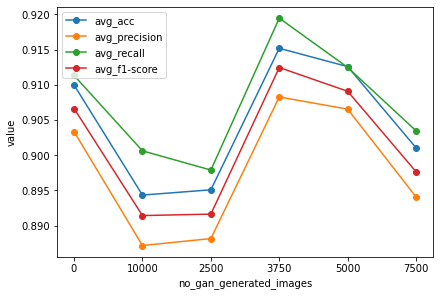

In [9]:
df = pd.read_csv('vgg16_logging.csv')
df = df[
    (df['model_name'].str.contains('gan_augmented_rot_blur_sharp')) & (df['model_name'].str.contains('_s_'))
]  
df = df.iloc[3:]
cols = df.columns.tolist()[2:-7]
df['no_gan_generated_images'] = df['no_gan_generated_images'].astype(str)
df = df.groupby(['no_gan_generated_images'])[cols].mean().reset_index()
display(df)
fig,ax = plt.subplots()
for metric in cols:
    if metric != 'auc':
        ax.plot(
            df['no_gan_generated_images'].astype(str), 
            df[metric],
            label=metric,
            marker='o')

ax.set_xlabel("no_gan_generated_images")
ax.set_ylabel("value")
ax.legend(loc='best');

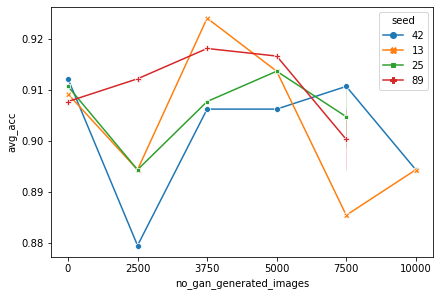

In [26]:
df = pd.read_csv('vgg16_logging.csv')
df = df[
    (df['model_name'].str.contains('gan_augmented_rot_blur_sharp')) & (df['model_name'].str.contains('_s_'))
] 
df = df.iloc[3:]
df['seed'] = df['model_name'].apply(lambda x: x.split('_')[-1])
df = df[['no_gan_generated_images', 'avg_acc','seed']]
df = df.sort_values(by='no_gan_generated_images')
df['no_gan_generated_images'] = df['no_gan_generated_images'].astype(str)
# df.pivot(index='no_gan_generated_images', columns='seed', values='avg_acc')

sns.lineplot(x='no_gan_generated_images', y='avg_acc', hue='seed', data=df, style="seed", markers=True, dashes=False)

In [ ]:
fig,ax = plt.subplots()

df = pd.read_csv('vgg16_logging.csv')
df = df[
    (df['model_name'].str.contains('old_gan')) & (df['model_name'].str.contains('_s_'))
]  
df = df.iloc[3:]
cols = df.columns.tolist()[2:-7]
df = df.groupby(['no_gan_generated_images'])[cols].mean().reset_index()
display(df)
for metric in cols:
    if metric != 'auc':
        ax.plot(
            df['no_gan_generated_images'].astype(str), 
            df[metric],
            label=metric,
            marker='o')

ax.set_xlabel("no_gan_generated_images")
ax.set_ylabel("value")
ax.legend(loc='best');

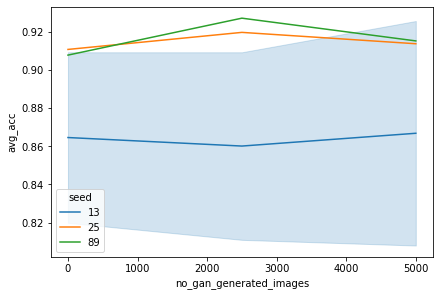

In [33]:

df = pd.read_csv('vgg16_logging.csv')
df = df[
    (df['model_name'].str.contains('old_gan')) & (df['model_name'].str.contains('_s_'))
] 
df['seed'] = df['model_name'].apply(lambda x: x.split('_')[-1])
df = df[['no_gan_generated_images', 'avg_acc','seed']]
# df.pivot(index='no_gan_generated_images', columns='seed', values='avg_acc')

sns.lineplot(x='no_gan_generated_images', y='avg_acc', hue='seed', data=df)

In [ ]:
fig,ax = plt.subplots()

df = pd.read_csv('vgg16_logging.csv')
df = df[
    (df['model_name'].str.contains('old_gan')) & (df['model_name'].str.contains('_s_'))
]  
df = df.iloc[3:]
cols = df.columns.tolist()[2:-7]
df = df.groupby(['no_gan_generated_images'])[cols].mean().reset_index()
display(df)
for model in set(df['model_name']):
    ax.plot(
        df['no_gan_generated_images'].astype(str), 
        df[metric],
        label=model,
        marker='o')

ax.set_xlabel("no_gan_generated_images")
ax.set_ylabel("value")
ax.legend(loc='best');

In [ ]:
df = pd.read_csv('vgg16_logging.csv')
df = df[(df['batch_size'].notnull()) & (df['epoch'] > 1) & (df['no_gan_generated_images'] == 7500)]
df

In [ ]:
df = pd.read_csv('vgg16_logging.csv')
df = df[(df['batch_size'].notnull()) & (df['epoch'] > 1)]
df = df.groupby(['no_gan_generated_images'])[df.columns.tolist()[2:-3]].mean().reset_index()
display(df)
df.plot(
    x='no_gan_generated_images', 
    y='avg_acc',
    marker='o');